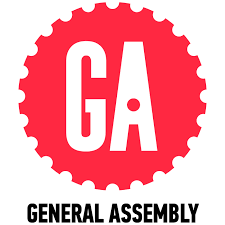

<img src="https://pbs.twimg.com/profile_images/1347083818759573505/3piEL1z5_400x400.jpg" style="float: left; margin: 20px; height: 55px">

<img src="https://pbs.twimg.com/profile_images/1332959289904934914/YFR0eaYp_400x400.jpg" style="float: left; margin: 20px; height: 55px">
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/4/43/Blue_circle_for_diabetes.svg/1200px-Blue_circle_for_diabetes.svg.png" style="float: left; margin: 20px; height: 55px">

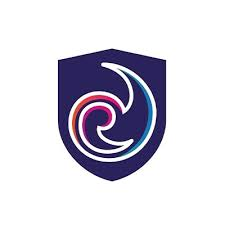


 <img src="../assets/images/Green_elbow.jpg"  float= left  margin_top:= 200 width=55 height=55>
 
 


<center> <font color='red' size=30px>  Local data for diabetics

<br><br><br>


# Problem

•	It is commonly believed that current documentation system of healthcare is under documenting the prevalence of many disease. In Saudi Arabia, diabetes is one of the most prevalent diseases in the county and impact the life of many families and individuals in addition to its financial burden on healthcare economy. 

<br>

# Objective
- To identify the prevalence of diabetes in Saudi Arabia.
- To explore common comorbidities and predictive factors to diabetes among Saudi population
- To build a machine learning model that identify undiagnosed diabetic people. 	
- To identify healthcare utilization among diabetic patients


<br>

# Team:

| Team               |1                   |2                     |3                |4                |
|:-------------------|:------------------:|:--------------------:|:---------------:|:---------------:|
|Green Elbow (GE)                |*Najwa Saeed* |*Ahmed Adam* |*Amjaad Alsuabie* |*Abdulaziz Alsulami*



<br><br>

# Table of contents
<br><br>

<br><br>
<br>
To achieve our goals for this project, we followed the following steps:


1- <a href="#Part_1">Simple exploration of all files one by one.</a>


2- <a href="#Part_2">Merging all files into one file based on similar columns.</a>


3- <a href="#Part_3">Deep exploration of the data after consolidation.</a>


4- <a href="#Part_4">Data cleanup is an initial cleanup to use its result in several subsequent scenarios.</a>


5- <a href="#Part_5">Clean up data based on various scenarios.</a>


6- <a href="#Part_6">Preparing data for modeling.</a>


7- <a href="#Part_7">Modinal.</a>
<br><br><br>

---

<br>

## Dictionary  For Local Data 

| Column               |Type                  |Mening                     |
|:-------------------|:------------------:|:--------------------:|
|PatientID                 |*int* |*A unique number for each patient* |
|U_Encounter_ID_x                 |*object* |*The patient's visit number* |
|Service Type                 |*object* |*The service that was provided to the patient* |
|Service_Code                 |*object* |*The code is for the service that was provided to the patient* |
|Service Name                 |*object* |*The name of the service that was provided to the patient* |
|U_Encounter_ID_y                 |*object* |*The patient's visit number* |
|Gender                 |*object* |*Male or Female* |
|YearOfBirth                 |*object* |*The year of birth of each patient* |
|Provider Name                 |*object* |*The name of the hospital that provided the service* |
|Discharge Date/Time                 |*object* |*Discharge Date of the patient* |
|Admission Date/Time                 |*object* |*Admission Date of the patient* |
|Encounter_Type                |*object* |*Hospital departement visited by patient* |
|Duration of leave                 |*int* |*The number of days the patient stays in the hospital* |
|Nationality                 |*object* |*Admission Date of the patient* |
|Discharge Mode                 |*object* |*The method upon whitch the patient was discharged  from hospital/clinic* |
|Clinic                 |*object* |*The name of the clinic that received the patient* |
|MaritalStatus                 |*float64* |*The patient's marital status* |
|Diagnosis Description                 |*object* |*Diagnosis Description of the patient* |
|Diagnosis Code                 |*object* |*Diagnosis Code of the patient* |
|Diagnosis Type                 |*object* |*Principal Diagnosis\؟* |
|height                 |*float64* |*Patient height* |
|weight                 |*float64* |*The patient's weight* |
|gender                 |*object* |*Another column to clarify the patient's gender* |
|has_diabetes                 |*bool* |*1 means that the patient has diabetes* |
|has_hypertension                 |*object* |*1 means that the patient has hypertension* |



<br><br><br>

---

<br><br><br>


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from numpy import mean

#ploting
import plotly.express as px
from matplotlib import pyplot
import matplotlib.pyplot as plt
%matplotlib inline

# To ignore unwanted warnings
import warnings
warnings.filterwarnings('ignore')

import calendar
plt.style.use('fivethirtyeight')

In [2]:
from sklearn.model_selection import train_test_split

#Model
from sklearn import svm
from sklearn.svm import SVC
from catboost import CatBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier 


from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

#evaluating
from sklearn.metrics import f1_score
from sklearn import metrics
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report


# Our Functions

We will use this feature to compress data to make it easier to work with

In [3]:
INT8_MIN    = np.iinfo(np.int8).min
INT8_MAX    = np.iinfo(np.int8).max
INT16_MIN   = np.iinfo(np.int16).min
INT16_MAX   = np.iinfo(np.int16).max
INT32_MIN   = np.iinfo(np.int32).min
INT32_MAX   = np.iinfo(np.int32).max

FLOAT16_MIN = np.finfo(np.float16).min
FLOAT16_MAX = np.finfo(np.float16).max
FLOAT32_MIN = np.finfo(np.float32).min
FLOAT32_MAX = np.finfo(np.float32).max

def memory_usage(data, detail=1):
    if detail:
        display(data.memory_usage())
    memory = data.memory_usage().sum() / (1024*1024)
    print("Memory usage : {0:.2f}MB".format(memory))
    return memory

def compress_dataset(data):
    """
        Compress datatype as small as it can
        Parameters
        ----------
        path: pandas Dataframe

        Returns
        -------
            None
    """
    memory_before_compress = memory_usage(data, 0)
    print()
    length_interval      = 50
    length_float_decimal = 4

    print('='*length_interval)
    for col in data.columns:
        col_dtype = data[col][:100].dtype

        if col_dtype != 'object':
            print("Name: {0:24s} Type: {1}".format(col, col_dtype))
            col_series = data[col]
            col_min = col_series.min()
            col_max = col_series.max()

            if col_dtype == 'float64':
                print(" variable min: {0:15s} max: {1:15s}".format(str(np.round(col_min, length_float_decimal)), str(np.round(col_max, length_float_decimal))))
                if (col_min > FLOAT16_MIN) and (col_max < FLOAT16_MAX):
                    data[col] = data[col].astype(np.float16)
                    print("  float16 min: {0:15s} max: {1:15s}".format(str(FLOAT16_MIN), str(FLOAT16_MAX)))
                    print("compress float64 --> float16")
                elif (col_min > FLOAT32_MIN) and (col_max < FLOAT32_MAX):
                    data[col] = data[col].astype(np.float32)
                    print("  float32 min: {0:15s} max: {1:15s}".format(str(FLOAT32_MIN), str(FLOAT32_MAX)))
                    print("compress float64 --> float32")
                else:
                    pass
                memory_after_compress = memory_usage(data, 0)
                print("Compress Rate: [{0:.2%}]".format((memory_before_compress-memory_after_compress) / memory_before_compress))
                print('='*length_interval)

            if col_dtype == 'int64':
                print(" variable min: {0:15s} max: {1:15s}".format(str(col_min), str(col_max)))
                type_flag = 64
                if (col_min > INT8_MIN/2) and (col_max < INT8_MAX/2):
                    type_flag = 8
                    data[col] = data[col].astype(np.int8)
                    print("     int8 min: {0:15s} max: {1:15s}".format(str(INT8_MIN), str(INT8_MAX)))
                elif (col_min > INT16_MIN) and (col_max < INT16_MAX):
                    type_flag = 16
                    data[col] = data[col].astype(np.int16)
                    print("    int16 min: {0:15s} max: {1:15s}".format(str(INT16_MIN), str(INT16_MAX)))
                elif (col_min > INT32_MIN) and (col_max < INT32_MAX):
                    type_flag = 32
                    data[col] = data[col].astype(np.int32)
                    print("    int32 min: {0:15s} max: {1:15s}".format(str(INT32_MIN), str(INT32_MAX)))
                    type_flag = 1
                else:
                    pass
                memory_after_compress = memory_usage(data, 0)
                print("Compress Rate: [{0:.2%}]".format((memory_before_compress-memory_after_compress) / memory_before_compress))
                if type_flag == 32:
                    print("compress (int64) ==> (int32)")
                elif type_flag == 16:
                    print("compress (int64) ==> (int16)")
                else:
                    print("compress (int64) ==> (int8)")
                print('='*length_interval)

    print()
    memory_after_compress = memory_usage(data, 0)
    print("Compress Rate: [{0:.2%}]".format((memory_before_compress-memory_after_compress) / memory_before_compress))

we will use this function to plot

In [4]:

def category_numeric_plots(data, col1, col2='has_diabetes'):
    """
    This function takes three arguments (dataframe, specific column and has_diabetes column) and plots two
    figures accordingly
    
    """
       
    
    if data[col1].dtype in [int, float]:
        plt.figure(figsize=(12,6))

        fig = sns.kdeplot(
                    x = col1, 
                    data=data, 
                    hue=col2,
                    shade=True)

        plt.title(f'{col1} According to {col2} or Not', fontsize=16)
        plt.yticks(fig.get_yticks(), [ round(num*10,2) for num in fig.get_yticks()])
        plt.ylabel('Distribution [%]', fontsize=14);        
        
    else:    
        
        fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12,12), constrained_layout=True)
        ax = ax.ravel()
        num_uni_vals = data[col1].nunique()
        col_with_diabetes = data[data[col2] == True ][col1]

        cols_name = [col1, f'{col1} - Diabetes']
        cols = [data[col1], col_with_diabetes]

        for i in range(len(cols)):

            if num_uni_vals > 10:
                x = cols[i].value_counts().keys()[:10]
                y = cols[i].value_counts().values[:10]

            elif num_uni_vals < 4:
                x = cols[i].value_counts().keys()
                y = cols[i].value_counts().values
                ax[i].pie(
                        x=y, 
                        autopct="%.1f%%", 
                        explode=[0.05]*num_uni_vals, 
                        labels=x, 
                        pctdistance=0.5)
                
                ax[i].set_title(f'{cols_name[i]}');
                
                continue 

            else: 
                x = cols[i].value_counts().keys()
                y = cols[i].value_counts().values

            splot = sns.barplot(x, y, ax=ax[i])

            for p in splot.patches:
                splot.annotate(format(p.get_height(), '.0f'), 
                               (p.get_x() + p.get_width() / 2., p.get_height()), 
                                ha = 'center', va = 'center', 
                                xytext = (0, 9), 
                                textcoords = 'offset points')

            ax[i].set_xlabel(cols_name[i], size=14)
            ax[i].set_ylabel('Count', size=14)

            if len(str(x[0])) > 8:
                ax[i].set_xticklabels(ax[i].get_xticklabels(),rotation=75,fontsize=10)
                ax[i].set_title(f'{cols_name[i]} Count', fontsize=16)
            else:
                ax[i].set_xticklabels(ax[i].get_xticklabels(),fontsize=12)
                ax[i].set_title(f'{cols_name[i]} Count', fontsize=16)


We will use this function to check the percentage of the nulls

In [5]:
def perc_nan(df):
    """Function return the column names and the oercent of nans in each columns with the number, params: dataframe""" 
    # missing values as %
    percent = df.isnull().sum() *100 / df.shape[0]
    
    return  pd.concat([df.isnull().sum(), percent[percent > 0]],keys=["No_NaN","Percent"],
                                                                      axis=1).dropna().sort_values('Percent')

In [6]:
# iterating in list (nat_lst) then iterating in dictionary (d)
# if natinality (nat) in v (values of d), storing index of nat (value of nat_lst) in index variable
# updateing nat_lst value with same index

def modifing_categories(data, col, dictionary):
    """
    This function takes three arguments (dataframe, specific column and dictionary) and replaces the 
    column-specific values with the correct dictionary values as needed
    
    """
    
    # filling null values with text instead of NaN to can converting all values to upper case 
    fill_null = data[col].fillna('AA',axis=0)

    # converting all values to upper case and converting to list by split it with space 
    # taking only first value if natinality in 'SAUDI', 'ARABIAN' or 'SAUDI', 'ARABIA' 
    # else same value then converting to string
    if col == 'Nationality':
        nationality = fill_null.apply(lambda x: x.upper().split(' '))
        lst = [ 
            ''.join(nat[0]) if (nat == ['SAUDI', 'ARABIAN']) | (nat == ['SAUDI', 'ARABIA']) 
                            else ''.join(nat) for nat in nationality 
        ]
    
    else:
        # replacing any values with ? by AA
        clinic = fill_null.apply(lambda x: 'EMERGENCY DEPARTMENT' if '?' in x else x )
        lst = clinic.tolist()
        
    for n in lst:
        for k, v in dictionary.items():
            if n in v:
                index = lst.index(n)
                lst[index] = k
    lst_to_series = pd.Series(lst)
    series_cap = lst_to_series.apply(lambda x: x.capitalize())
    
    return series_cap

In [7]:
def calculate_mean_weight_height(dictionary):
    """
    This function takes age and gender-spesific height and weight and compute the mean for 
    each given age groupe
    
    """
    
    weight_height_avg = {
                '0-1':None, '1-2':None, '2-12': None, '13-20': None
                }
    
    for k, v in dictionary.items():
        w, h = v
        weight = round(np.mean(w),1)
        height = round(np.mean(h),1)
        weight_height_avg[k] = (weight, height)
        
    return weight_height_avg

In [8]:
def applying_model(model, X_train, X_test, y_train, y_test):
    """
   This function used to apply any model and give the f1 score
    """
    
    clf = model.fit(X_train, y_train)

    #prediction
    pred_test = clf.predict(X_test)
    pred_train = clf.predict(X_train)

    # evaluate the model
    score = f1_score(y_test, pred_test)

    return score

# Read the data


In [9]:
sehaty = pd.read_csv('D:\capiston\data\Sehaty_v2.csv')
diagnosis = pd.read_csv('D:\capiston\data\Diagnosis.csv',encoding='latin-1')
serveses = pd.read_csv('D:\capiston\data\chunk1.csv')
encounters = pd.read_csv('D:\capiston\data\Encounters_V2.csv', encoding='latin-1')

In [10]:
local = pd.read_csv('D:\capiston\data\encounter_diagnosis_sehaty_services_chunk1 (1).csv', index_col=0)
pd.set_option('max_columns', None)


# compress dataset

In [11]:
compress_dataset(serveses)


Memory usage : 991.82MB

Name: U_Service_ID             Type: int64
 variable min: 1               max: 10000000       
    int32 min: -2147483648     max: 2147483647     
Memory usage : 953.67MB
Compress Rate: [3.85%]
compress (int64) ==> (int8)
Name: Quantity                 Type: int64
 variable min: 1               max: 885            
    int16 min: -32768          max: 32767          
Memory usage : 896.45MB
Compress Rate: [9.62%]
compress (int64) ==> (int16)
Name: medical_report           Type: float64
 variable min: nan             max: nan            
Memory usage : 896.45MB
Compress Rate: [9.62%]
Name: RadiologyReport          Type: float64
 variable min: nan             max: nan            
Memory usage : 896.45MB
Compress Rate: [9.62%]
Name: LabResult                Type: float64
 variable min: nan             max: nan            
Memory usage : 896.45MB
Compress Rate: [9.62%]
Name: NEW_FOLLOWUP_FLAG        Type: float64
 variable min: nan             max: nan            
M

In [12]:
compress_dataset(sehaty)


Memory usage : 83.35MB

Name: Pateint_ID               Type: int64
 variable min: 380             max: 5662455        
    int32 min: -2147483648     max: 2147483647     
Memory usage : 79.61MB
Compress Rate: [4.49%]
compress (int64) ==> (int8)
Name: height                   Type: float64
 variable min: -1860.0         max: 509655578.0    
  float32 min: -3.4028235e+38  max: 3.4028235e+38  
compress float64 --> float32
Memory usage : 75.86MB
Compress Rate: [8.99%]
Name: weight                   Type: float64
 variable min: -700.0          max: 72532450.0     
  float32 min: -3.4028235e+38  max: 3.4028235e+38  
compress float64 --> float32
Memory usage : 72.11MB
Compress Rate: [13.48%]
Name: has_diabetes             Type: bool
Name: AvgStepsPerDay           Type: float64
 variable min: 0.0             max: 263630.0       
  float32 min: -3.4028235e+38  max: 3.4028235e+38  
compress float64 --> float32
Memory usage : 68.37MB
Compress Rate: [17.98%]

Memory usage : 68.37MB
Compress Rate: 

In [13]:
compress_dataset(encounters)

Memory usage : 4766.05MB

Name: Patient_ID               Type: int64
 variable min: 1               max: 5729071        
    int32 min: -2147483648     max: 2147483647     
Memory usage : 4686.61MB
Compress Rate: [1.67%]
compress (int64) ==> (int8)
Name: Duration of leave        Type: float64
 variable min: -5812.0         max: 214210.0       
  float32 min: -3.4028235e+38  max: 3.4028235e+38  
compress float64 --> float32
Memory usage : 4607.18MB
Compress Rate: [3.33%]
Name: Occupation               Type: float64
 variable min: nan             max: nan            
Memory usage : 4607.18MB
Compress Rate: [3.33%]
Name: Height                   Type: float64
 variable min: 0.0             max: 19762.0        
  float16 min: -65500.0        max: 65500.0        
compress float64 --> float16
Memory usage : 4488.03MB
Compress Rate: [5.83%]
Name: Weight                   Type: float64
 variable min: 0.0             max: 100172.0       
  float32 min: -3.4028235e+38  max: 3.4028235e+38  
compr

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_1'>

<br><br>
<center> 
    <font color='2B059F' size='70px'> Part 1: EDA For each data separately 
        <br><br>



<br><br><br>

# Explore the data

## serveses dataset

In [14]:
serveses.head()

,U_Service_ID,U_Encounter_ID,Service Type,Service_Code,Service Name,Quantity,Service Date,Unit,medical_report,VitalSigns,RadiologyReport,LabResult,NEW_FOLLOWUP_FLAG
0,1,01_001_1,DR. SERVICES,NaN,NaN,1,2018-03-21,NaN,NaN,N\A,NaN,NaN,NaN
1,2,01_001_1,assumption,NaN,CONSULTANT FEE,1,NaN,1,NaN,N\A,NaN,NaN,NaN
2,3,01_001_10,assumption,NaN,CONSULTANT FEE,1,NaN,1,NaN,N\A,NaN,NaN,NaN
3,4,01_001_10,RADIOLOGY TESTS,RD-0129,"LUMBAR AP, LAT, L5/S1",1,2018-12-06,NaN,NaN,N\A,NaN,NaN,NaN
4,5,01_001_10,DR. SERVICES,NaN,NaN,1,2018-12-06,NaN,NaN,N\A,NaN,NaN,NaN


In [15]:
serveses.shape

(10000000, 13)

In [16]:
serveses.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000000 entries, 0 to 9999999
Data columns (total 13 columns):
 #   Column             Dtype  
---  ------             -----  
 0   U_Service_ID       int32  
 1   U_Encounter_ID     object 
 2   Service Type       object 
 3   Service_Code       object 
 4   Service Name       object 
 5   Quantity           int16  
 6   Service Date       object 
 7   Unit               object 
 8   medical_report     float64
 9   VitalSigns         object 
 10  RadiologyReport    float64
 11  LabResult          float64
 12  NEW_FOLLOWUP_FLAG  float64
dtypes: float64(4), int16(1), int32(1), object(7)
memory usage: 896.5+ MB


### Null values:

In [17]:
perc_nan(serveses)

,No_NaN,Percent
Service Type,125154,1.25154
Service Name,507510,5.07510
Service Date,754197,7.54197
Service_Code,1241292,12.41292
VitalSigns,1511699,15.11699
Unit,9025537,90.25537
medical_report,10000000,100.00000
RadiologyReport,10000000,100.00000
LabResult,10000000,100.00000
NEW_FOLLOWUP_FLAG,10000000,100.00000


### value counts:

In [18]:
for col in serveses.columns:
    print(col)
    print(serveses[col].value_counts())
    print('===============================')

U_Service_ID
8392702    1
6497998    1
2330331    1
6522586    1
2354903    1
          ..
5603322    1
9791481    1
1382391    1
5578742    1
4196353    1
Name: U_Service_ID, Length: 10000000, dtype: int64
U_Encounter_ID
01_001_7421751     337
01_001_7193091     327
01_001_7289663     324
01_001_7501671     303
01_001_33490510    303
                  ... 
01_002_431009        2
01_001_3604709       2
01_001_320760        2
01_002_341705        2
01_002_434410        1
Name: U_Encounter_ID, Length: 674721, dtype: int64
Service Type
LABORATORY TESTS        5628036
LABORATORY              1812284
PHARMACY                 928241
assumption               733782
RADIOLOGY TESTS          238441
DR. CONSULTATIONS        198771
DR. SERVICES             179179
RADIOLOGY                105810
MEDICAL PROCEDURES        32039
SURGERY OPERATIONS        11456
DR. SUPERVISION            2157
PHYSIOTHERAPY              1481
ACCOMMODATION              1358
ENDOSCOPY PROCEDURES        940
NURSE SUPERVI

- After we chunk the `servece` dataset into 14 files, we are intersting in the first one only; contain all of the `ID` that we want.
- `servece` dataset shape is `(10000000, 13)`.
- There alot of missing value, we will drop any columns with 70% of nulls, and that's mean we will drop `Unit`, `medical_report`, `RadiologyReport`, `LabResult`,`NEW_FOLLOWUP_FLAG`.


<br><br><br>


---
<br><br><br>

## diagnosis dataset

In [19]:
diagnosis.head()

,U_Encounter_ID,Diagnosis Description,Diagnosis Code,Condition Onset Flag,Diagnosis Type
0,01_001_100002,Non-insulin-dependent diabetes mellitus with u...,E11.80,NaN,Additional Diagnosis
1,01_001_100005,Non-insulin-dependent diabetes mellitus withou...,E11.90,NaN,Additional Diagnosis
2,01_001_100006,Type 2 diabetes mellitus with poor control,E11.65,NaN,Additional Diagnosis
3,01_001_100010,"Hypothyroidism, unspecified",E03.9,NaN,Additional Diagnosis
4,01_001_100020,Non-insulin-dependent diabetes mellitus with u...,E11.80,NaN,Additional Diagnosis


In [20]:
diagnosis.shape

(8279099, 5)

In [21]:
diagnosis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8279099 entries, 0 to 8279098
Data columns (total 5 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   U_Encounter_ID         object 
 1   Diagnosis Description  object 
 2   Diagnosis Code         object 
 3   Condition Onset Flag   float64
 4   Diagnosis Type         object 
dtypes: float64(1), object(4)
memory usage: 315.8+ MB


In [22]:
perc_nan(diagnosis)

,No_NaN,Percent
Condition Onset Flag,8279099,100.0


### value counts:

In [23]:
for col in diagnosis.columns:
    print(col)
    print(diagnosis[col].value_counts())
    print('===============================')

U_Encounter_ID
04_038_8666379     35
04_045_42749471    25
04_038_8590106     25
04_045_40105376    23
04_038_8498742     22
                   ..
02_014_1846747      1
04_043_59222883     1
04_034_6306922      1
02_020_3028270      1
02_020_2005485      1
Name: U_Encounter_ID, Length: 7664666, dtype: int64
Diagnosis Description
 Acute upper respiratory infection unspecified                                                                            364810
Pain, unspecified                                                                                                         182806
Acute pain                                                                                                                165315
 Cough                                                                                                                    131650
Acute upper respiratory infection, unspecified                                                                            128463
                        

- `diagnosis` shape is `(8279099, 5)`
- We will drop `Condition Onset Flag` column.


<br><br><br>


---
<br><br><br>

## sehaty dataset

In [24]:
sehaty.head()

,Pateint_ID,height,weight,blood_type,gender,has_diabetes,has_hypertension,has_asthma,has_obesity,is_pregnant,is_smoker,AvgStepsPerDay
0,380,173.0,90.0,B+,M,False,False,NaN,NaN,NaN,NaN,NaN
1,381,NaN,NaN,NaN,F,False,NaN,NaN,NaN,NaN,NaN,4969.0
2,385,165.0,63.0,A+,F,False,False,NaN,NaN,NaN,NaN,NaN
3,393,180.0,92.0,B+,M,False,True,NaN,NaN,NaN,NaN,4840.0
4,394,175.0,95.0,A+,M,True,False,NaN,NaN,NaN,NaN,NaN


In [25]:
sehaty.shape

(982044, 12)

In [26]:
sehaty.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982044 entries, 0 to 982043
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Pateint_ID        982044 non-null  int32  
 1   height            523220 non-null  float32
 2   weight            532949 non-null  float32
 3   blood_type        319250 non-null  object 
 4   gender            982031 non-null  object 
 5   has_diabetes      982044 non-null  bool   
 6   has_hypertension  909547 non-null  object 
 7   has_asthma        1 non-null       object 
 8   has_obesity       1 non-null       object 
 9   is_pregnant       1 non-null       object 
 10  is_smoker         1 non-null       object 
 11  AvgStepsPerDay    252302 non-null  float32
dtypes: bool(1), float32(3), int32(1), object(7)
memory usage: 68.4+ MB


In [27]:
perc_nan(sehaty)

,No_NaN,Percent
gender,13,0.001324
has_hypertension,72497,7.382256
weight,449095,45.730639
height,458824,46.721328
blood_type,662794,67.491273
AvgStepsPerDay,729742,74.308483
has_asthma,982043,99.999898
has_obesity,982043,99.999898
is_pregnant,982043,99.999898
is_smoker,982043,99.999898


### value counts:

In [28]:
for col in sehaty.columns:
    print(col)
    print(sehaty[col].value_counts())
    print('===============================')

Pateint_ID
2872418    1
5211304    1
3087547    1
5182650    1
5178552    1
          ..
591756     1
4800395    1
4798346    1
2709382    1
5045415    1
Name: Pateint_ID, Length: 982044, dtype: int64
height
 0.0       102134
 170.0      30089
 165.0      20402
 168.0      19497
 175.0      18454
            ...  
 235.0          1
 937.0          1
 234.0          1
 1790.0         1
-96.0           1
Name: height, Length: 522, dtype: int64
weight
0.0       109348
80.0       16297
70.0       14424
75.0       13730
90.0       13555
           ...  
4165.0         1
258.0          1
1030.0         1
1028.0         1
820.0          1
Name: weight, Length: 520, dtype: int64
blood_type
O+     139777
A+      82269
B+      54694
AB+     16239
O-      14005
A-       6467
B-       4519
AB-      1280
Name: blood_type, dtype: int64
gender
M    698998
F    282947
U        86
Name: gender, dtype: int64
has_diabetes
False    855762
True     126282
Name: has_diabetes, dtype: int64
has_hypertension
F

- Sehaty shape is `(982044, 12)`
- The `Gender` coiumn looks missy but we will solve this problem by using another `gender` column.

<br><br><br>


---
<br><br><br>

## encounters dataset

In [29]:
encounters.head()

,Patient_ID,U_Encounter_ID,Provider Name,Admission Date/Time,Discharge Date/Time,Encounter_Type,Duration of leave,Date of Birth,Gender,Country of Birth,Nationality,Discharge Mode,Discharge Specialty,Morphology,Clinic,PatientChiefComplaint,DischargerSummery,Country of Residence,Religion,Occupation,MaritalStatus,Height,Weight,Tempreture,HIGH_BLOOD_PRESSURE,LOW_BLOOD_PRESSURE,NEW_FOLLOWUP_FLAG,Cause of Death,CauseOfDeathCode,Blood Group
0,1,03_031_241021,Qaisumah General Hospital,2017-03-24,2017-03-26,OPD,2.0,12/5/2009 12:00:00 AM,Female,Saudi Arabia,Saudi,"Discharge, Doctor Permission",NaN,N/C,EMERGENCY,NaN,NaN,Saudi Arabia,Muslim,NaN,Un-Specified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,03_031_38573,Qaisumah General Hospital,2012-12-05,2012-12-07,OPD,2.0,12/5/2009 12:00:00 AM,Female,Saudi Arabia,Saudi,"Discharge, Doctor Permission",NaN,N/C,EMERGENCY,NaN,NaN,Saudi Arabia,Muslim,NaN,Un-Specified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,03_031_40055,Qaisumah General Hospital,2012-12-11,2012-12-13,OPD,2.0,12/11/1982 12:00:00 AM,Male,Saudi Arabia,Saudi,"Discharge, Doctor Permission",NaN,N/C,EMERGENCY,NaN,NaN,Saudi Arabia,NaN,NaN,Un-Specified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,03_031_103564,Qaisumah General Hospital,2015-03-01,2015-03-03,OPD,2.0,9/1/1970 12:00:00 AM,Male,Saudi Arabia,Saudi,"Discharge, Doctor Permission",NaN,N/C,EMERGENCY,NaN,NaN,Saudi Arabia,Muslim,NaN,Un-Specified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3,03_031_103639,Qaisumah General Hospital,2015-03-02,2015-03-04,OPD,2.0,9/1/1970 12:00:00 AM,Male,Saudi Arabia,Saudi,"Discharge, Doctor Permission",NaN,N/C,EMERGENCY,NaN,NaN,Saudi Arabia,Muslim,NaN,Un-Specified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [30]:
encounters.shape

(20823172, 30)

In [31]:
encounters.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20823172 entries, 0 to 20823171
Data columns (total 30 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   Patient_ID             int32  
 1   U_Encounter_ID         object 
 2   Provider Name          object 
 3   Admission Date/Time    object 
 4   Discharge Date/Time    object 
 5   Encounter_Type         object 
 6   Duration of leave      float32
 7   Date of Birth          object 
 8   Gender                 object 
 9   Country of Birth       object 
 10  Nationality            object 
 11  Discharge Mode         object 
 12  Discharge Specialty    object 
 13  Morphology             object 
 14  Clinic                 object 
 15  PatientChiefComplaint  object 
 16  DischargerSummery      object 
 17  Country of Residence   object 
 18  Religion               object 
 19  Occupation             float64
 20  MaritalStatus          object 
 21  Height                 float16
 22  Weight          

In [32]:
perc_nan(encounters)

,No_NaN,Percent
Gender,26,0.000125
Admission Date/Time,754,0.003621
Clinic,1089,0.005230
Nationality,37304,0.179147
Date of Birth,37724,0.181164
Discharge Date/Time,3904907,18.752700
Duration of leave,3905661,18.756321
Discharge Mode,6720880,32.275966
MaritalStatus,9778155,46.958048
NEW_FOLLOWUP_FLAG,16068756,77.167667


### value counts:

In [33]:
for col in encounters.columns:
    print(col)
    print(encounters[col].value_counts())
    print('===============================')

Patient_ID
370317     2774
374786     2447
4616086    2088
519826     1918
2226343    1583
           ... 
4614590       1
4647342       1
4630950       1
483743        1
4196353       1
Name: Patient_ID, Length: 4912156, dtype: int64
U_Encounter_ID
01_002_342631      1
02_008_1505269     1
04_057_9386322     1
04_038_9308350     1
01_004_271956      1
                  ..
01_003_1675284     1
04_039_21992577    1
03_033_100682      1
04_057_11293032    1
04_046_17496533    1
Name: U_Encounter_ID, Length: 20823172, dtype: int64
Provider Name
King Khaled Hospital-Najran                   960547
KING SALMAN HOSPITAL-RIYADH                   953620
KING ABDULLAZIZ JEDDAH                        894327
KING FAHED ALBAHA                             875563
OUHD-MADINAH                                  820726
Maternity & Child Hospital Maddina            794168
KING ABDULLAH HOSPITAL-BISHA                  790985
KING FAHED JEDDAH                             789094
KING KHALED HOSPITAL-HAIL   

N/C    1482825
Name: Morphology, dtype: int64
Clinic
EMERGENCY                      2332637
ER CLINIC                      1467641
EMERGENCY CLINIC               1302164
Emergency                       798668
ACCIDENT & EMERGENCY CLINIC     735320
                                ...   
C1-5                                 1
N66                                  1
ENDO. D. CLINIC - 81510              1
(LRR)room1/2                         1
PEDIA - CARDIOLOGY CLINIC 3          1
Name: Clinic, Length: 10696, dtype: int64
PatientChiefComplaint
SOB                                       1286
FEVER                                     1115
CHEST PAIN                                 773
ABDOMINAL PAIN                             674
RTA                                        564
                                          ... 
itchiness in eyes n nose                     1
LEPER PIAN 9 MANTH PRAGNANT                  1
SOB, cough, ranny nose                       1
FOOT PAIN NUMBNESS             

N\A      1194651
A41.9        340
I64           67
J18.9         54
Z51.1         50
          ...   
G61.0          1
D00.0          1
K60.2          1
L93            1
D09.9          1
Name: CauseOfDeathCode, Length: 636, dtype: int64
Blood Group
Unknown    491687
O+             83
B+             55
A+              3
A-              1
O-              1
Name: Blood Group, dtype: int64


- encounters shape is `(20823172, 30)`.
- Nearly half of the data are missing but we will see what we will do after merge  all of them together.

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_2'>

<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 2: Merging the data
        <br><br>


####  Local Steps
- We merged all the files together since there are important columns such as age, height, weight and goal, which is whether or not a person has diabetes, all of whitch are in separate files.


- Reading each Dataset
|File Name| No Rows / Columns |
|---------|-------|
| Sehaty  | 982,044 / 12| 
| Diagnosis | 8,279,099 / 5|
| Encounters | 20,823,172 / 30|
| Services (Chunk1) | 10,000,000 / 13 |

----------------------------------------

- Merging Files
|Merge Number | File1 | File2 | Merged On |  No Rows / Columns |
|---------|-------|---------|-------|-------|
| 1 | Encounters | Diagnosis | U_Encouter_ID | 8,279,099 / 16 |
| 2 | Merge-1 | Sehaty | PatientId | 298,514 / 24|
| 3 | Merge-2 | Servcies (Chunck1) | PatientId| 298,514 / 28|

----------------------------------------

- Working Data

Removing duplicated PatientId in merge-3 Shape = (298,514 / 28). New Shape = ( 94,602 / 28)

In [34]:
sehaty_updated = sehaty[['Pateint_ID', 'height', 'weight', 'gender','has_diabetes', 'has_hypertension']]
diagnosis_updated = diagnosis.drop('Condition Onset Flag', axis=1)

In [35]:
null_rate = encounters.isna().sum()/encounters.shape[0]

In [36]:
cols = []
for col, rate in null_rate.items():
    if null_rate[col] >= 0.7:
        cols.append(col)

In [37]:
encounter_updated = encounters.drop(cols, axis=1)

In [38]:
sehaty_updated.rename(columns={'Pateint_ID': 'Patient_ID'}, inplace=True)

In [39]:
encounter_dignosis = pd.merge(encounter_updated, diagnosis, on=['U_Encounter_ID'])

In [40]:
encounter_diagnosis_sehaty = pd.merge(encounter_dignosis, sehaty_updated, on=['Patient_ID'])

In [41]:
encounter_diagnosis_sehaty.drop('Condition Onset Flag', axis=1, inplace=True)


In [42]:
chunk1 = pd.read_csv('D:\capiston\data\chunk1.csv')
chunk1_update = chunk1.drop(['Unit', 'medical_report', 'RadiologyReport', 'LabResult', 'NEW_FOLLOWUP_FLAG'], axis=1)

In [43]:
chunk1_update.rename(columns={'U_Service_ID': 'Patient_ID'}, inplace=True)

In [44]:
encounter_diagnosis_sehaty_services_chunk1 = pd.merge(chunk1_update, encounter_diagnosis_sehaty, on=['Patient_ID'])

In [45]:
encounter_diagnosis_sehaty_services_chunk1.to_csv('D:\capiston\data\encounter_diagnosis_sehaty_services_chunk1 (1).csv')

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_3'>

<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 3: EDA For merged data
        <br><br>


# 1)Explore the data

<br><br><br>

In [47]:
local.head()

,Patient_ID,U_Encounter_ID_x,Service Type,Service_Code,Service Name,Quantity,Service Date,VitalSigns,U_Encounter_ID_y,Provider Name,Admission Date/Time,Discharge Date/Time,Encounter_Type,Duration of leave,Date of Birth,Gender,Nationality,Discharge Mode,Clinic,MaritalStatus,Diagnosis Description,Diagnosis Code,Diagnosis Type,height,weight,gender,has_diabetes,has_hypertension
0,402,01_001_100011,PHARMACY,548012050,CHOLECALCIFEROL 2800 INTERNATIONAL UNIT/ML/15 ...,1,2019-03-18,N\A,04_048_9881334,KING SALMAN HOSPITAL-RIYADH,2018-11-24,2018-11-24,ER,0.0,1961-09-09 00:00:00,M,SAUDI ARABIAN,CONDITION CURED,EMERGENCY,NaN,Asthma,J45,Principal Diagnosis,162.0,83.0,M,True,False
1,411,01_001_100012,PHARMACY,544121904,ROSUVASTATIN 10 MG TABLET,1,2019-03-18,N\A,04_034_6009488,ALJUBAIL HOSPITAL,2017-04-22,2017-04-22,ER,0.0,1982-01-15 00:00:00,M,SAUDI ARABIAN,DISCHARGED FROM CLINIC,EMERGENCY DEPARTMENT,NaN,Acute nasopharyngitis [common cold],J00,Principal Diagnosis,NaN,NaN,M,False,False
2,411,01_001_100012,PHARMACY,544121904,ROSUVASTATIN 10 MG TABLET,1,2019-03-18,N\A,04_034_6577839,ALJUBAIL HOSPITAL,2017-07-03,2017-07-03,ER,0.0,1982-01-15 00:00:00,M,SAUDI ARABIAN,DISCHARGED FROM CLINIC,EMERGENCY DEPARTMENT,NaN,OTHER DISEASES.,99,Principal Diagnosis,NaN,NaN,M,False,False
3,463,01_001_100015,LABORATORY TESTS,LB-4081,HDL CHOLESTEROL,1,2019-03-19,N\A,04_048_10238796,KING SALMAN HOSPITAL-RIYADH,2019-03-13,2019-03-13,ER,0.0,1978-04-03 00:00:00,M,SAUDI ARABIAN,ER DISCHARGED,EMERGENCY,NaN,Muscle strain,M62.6,Principal Diagnosis,176.0,92.0,M,False,False
4,463,01_001_100015,LABORATORY TESTS,LB-4081,HDL CHOLESTEROL,1,2019-03-19,N\A,04_048_7563410,KING SALMAN HOSPITAL-RIYADH,2018-04-03,2018-04-03,ER,0.0,1978-04-03 00:00:00,M,SAUDI ARABIAN,ER DISCHARGED,EMERGENCY,NaN,"Asthma, unspecified",J45.9,Principal Diagnosis,176.0,92.0,M,False,False


### Data shape

In [48]:
local.shape

(298514, 28)

### Data info

In [49]:
local.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 298514 entries, 0 to 298513
Data columns (total 28 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Patient_ID             298514 non-null  int64  
 1   U_Encounter_ID_x       298514 non-null  object 
 2   Service Type           294146 non-null  object 
 3   Service_Code           263577 non-null  object 
 4   Service Name           285579 non-null  object 
 5   Quantity               298514 non-null  int64  
 6   Service Date           275521 non-null  object 
 7   VitalSigns             277184 non-null  object 
 8   U_Encounter_ID_y       298514 non-null  object 
 9   Provider Name          298514 non-null  object 
 10  Admission Date/Time    298502 non-null  object 
 11  Discharge Date/Time    254947 non-null  object 
 12  Encounter_Type         298514 non-null  object 
 13  Duration of leave      254935 non-null  float64
 14  Date of Birth          298340 non-nu

### Missing data 

In [50]:
perc_nan(local)

,No_NaN,Percent
Admission Date/Time,12,0.004020
Clinic,48,0.016080
Date of Birth,174,0.058289
Nationality,245,0.082073
Service Type,4368,1.463248
Service Name,12935,4.333130
VitalSigns,21330,7.145394
has_hypertension,22292,7.467656
Service Date,22993,7.702486
Service_Code,34937,11.703639


### duplicated 

In [51]:
print(local.duplicated().sum())
print(local.Patient_ID.duplicated().sum())


0
203912


### Value count

In [52]:
for col in local.columns:
    print(col)
    print(local[col].value_counts())
    print('===============================')

Patient_ID
1304226    979
1050576    867
1799147    713
1918219    660
1238453    245
          ... 
2849000      1
2306273      1
2789589      1
2234564      1
1545101      1
Name: Patient_ID, Length: 94602, dtype: int64
U_Encounter_ID_x
01_001_3413333    979
01_001_3395858    876
01_001_3447047    714
01_001_3454801    662
01_001_3408925    250
                 ... 
01_001_3425723      1
01_001_3464079      1
01_001_3546581      1
01_001_111881       1
01_001_189668       1
Name: U_Encounter_ID_x, Length: 62153, dtype: int64
Service Type
LABORATORY TESTS        222883
PHARMACY                 26805
assumption               22002
RADIOLOGY TESTS          12355
DR. SERVICES              8557
MEDICAL PROCEDURES        1382
SURGERY OPERATIONS          90
PHYSIOTHERAPY               41
ENDOSCOPY PROCEDURES        21
NURSE SUPERVISION            7
ACCOMMODATION                2
DR. SUPERVISION              1
Name: Service Type, dtype: int64
Service_Code
LB-4092      5757
LB-4086      5694


Principal Diagnosis     276777
Additional Diagnosis     21737
Name: Diagnosis Type, dtype: int64
height
 0.0       34695
 170.0      7921
 160.0      6012
 165.0      5862
 168.0      5673
           ...  
-139.0         1
-190.0         1
 104.0         1
 1670.0        1
 41.0          1
Name: height, Length: 244, dtype: int64
weight
 0.0      36713
 80.0      4122
 70.0      3835
 75.0      3690
 90.0      3451
          ...  
-114.0        1
 182.0        1
-43.0         1
-140.0        1
 6.0          1
Name: weight, Length: 314, dtype: int64
gender
M    180380
F    118128
U         6
Name: gender, dtype: int64
has_diabetes
False    244467
True      54047
Name: has_diabetes, dtype: int64
has_hypertension
False    225222
True      51000
Name: has_hypertension, dtype: int64



- We have a lot of columns with missing data, but the height and weight 50% of their data are missing and even the existing data contains completely unreasonable values like a values in negative or height with more than 3m. It is very difficult to dismiss them as they are strong indicators of diabetes, as most people with diabetes are type 2 which is often caused by bad life behavior. Type 2 diabetes usually comes to middle-aged people due to unhealthy eating, weight gain, and other factors.
- Patient ID contains `203912` duplicated values and this is a result because each patient has a different visit number.



<br><br><br>


---
<br><br><br>

# 2) Visualization: 

<br><br>

## Target column

<br><br>

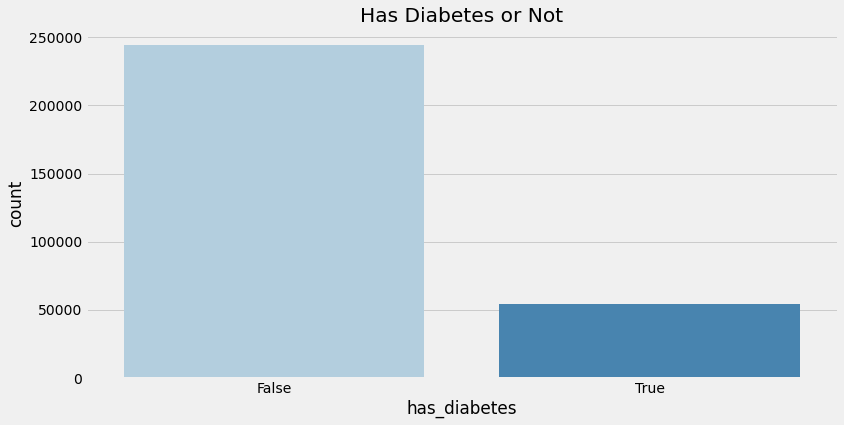

In [53]:
plt.figure(figsize=(12,6))
sns.countplot(local['has_diabetes'],palette=("Blues"))
plt.title('Has Diabetes or Not');

In [54]:
fig = px.pie(local,names='has_diabetes',title='The prevalence of diabetes in Saudi Arabia')
fig.show()

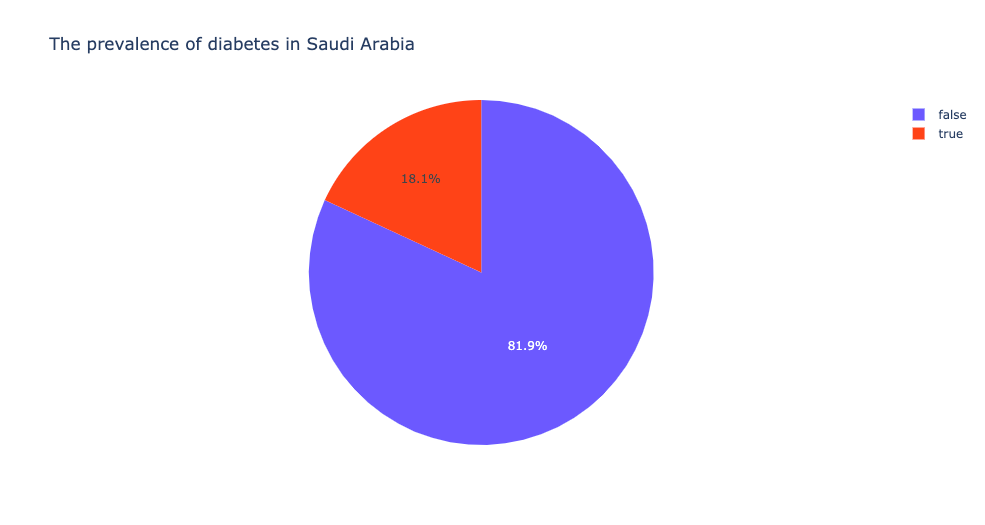

- We can clearly see that our target is unbalanced and biased towards people without diabetes.
- In this case, after taking the unique IDs, we can then see how we deal with the unbalanced data for the modeling.
- The percentage of people suffering from diabetes is `18.1%`, but let us take into account that this percentage may change later, because some patients have frequent IDs due to their multiple visits.

<br><br>

## The most services type used of all patients vs diabetic patients
 

<br><br>

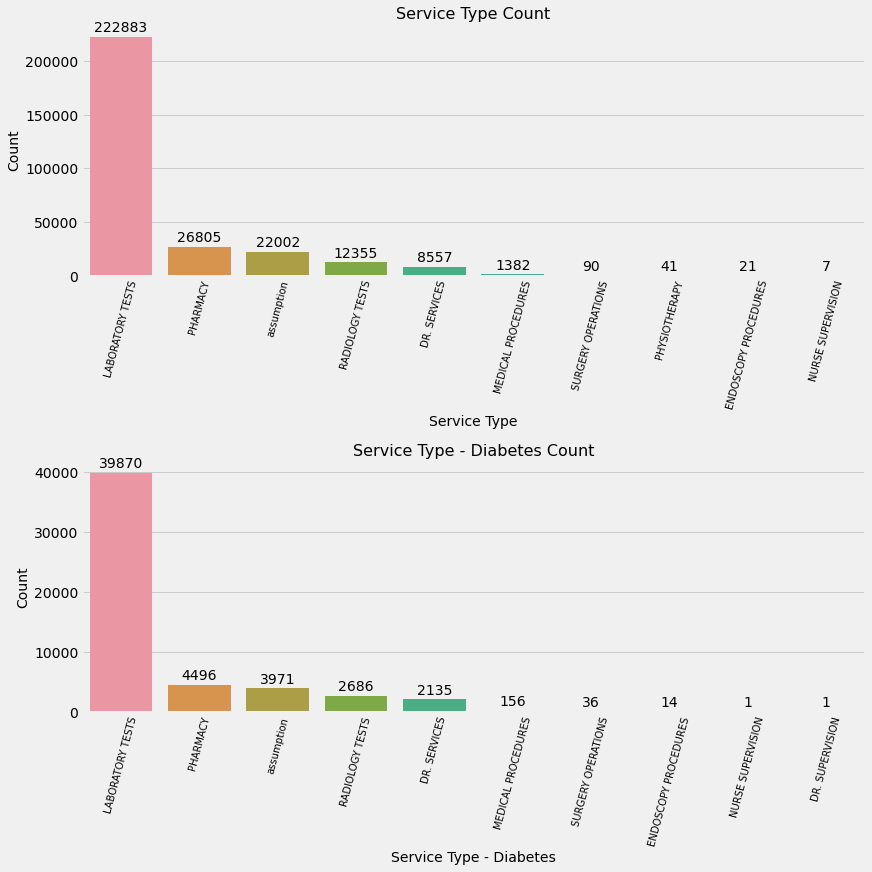

In [55]:
service_type = category_numeric_plots(local, 'Service Type')
service_type

- Lab tests are the most consumed services type for patients, whether diabetics or not. And this is because each diagnosis is only given based on specific tests.

<br><br>

## Top  services of all patients vs diabetic patients


<br><br>

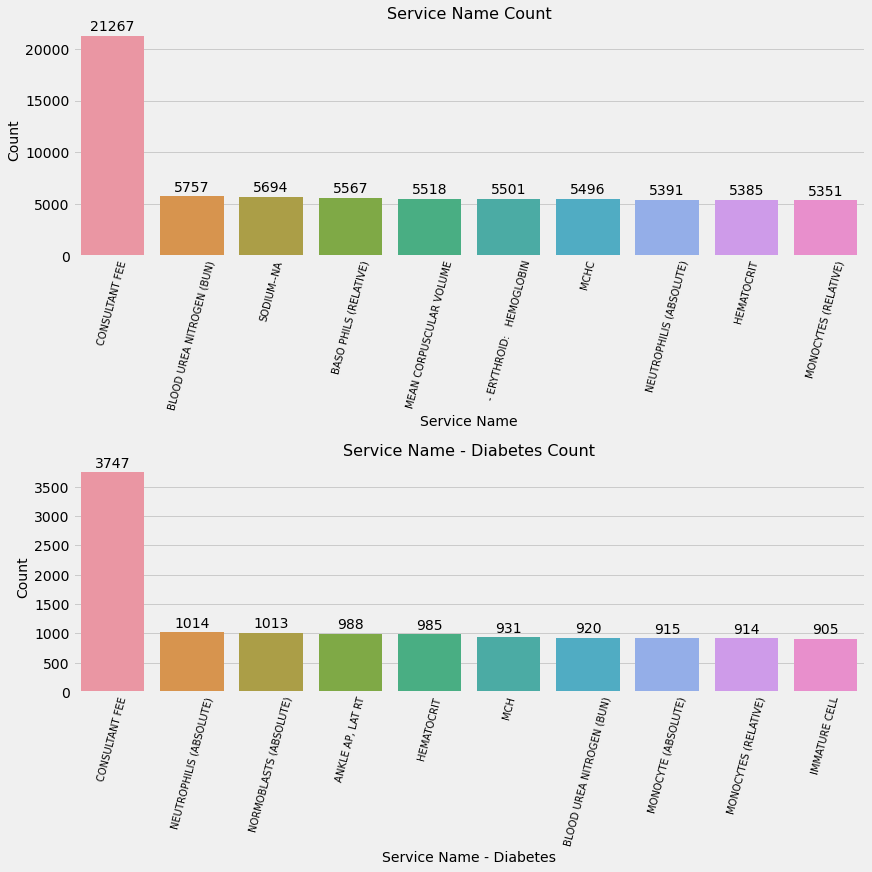

In [56]:
service_name = category_numeric_plots(local, 'Service Name')
service_name

- The most services consumed by patients, whether diabetics or not, are consultations. And then we see other high rates for some tests, which is also logical because all patients first undergo a consultation, and then if the need arises, tests are done or any other measures are taken.


<br><br>

## Month count of all patients vs diabetic patients

<br><br>

To get the months, we must first convert the service date into a date type

In [57]:
local['Service Date'] = pd.to_datetime(local['Service Date'])
local['Month'] = local['Service Date'].dt.month
local['Month'] = local['Month'].fillna(0, axis=0).astype(int)
local['Month Name'] = local['Month'].apply(lambda x: calendar.month_name[x])

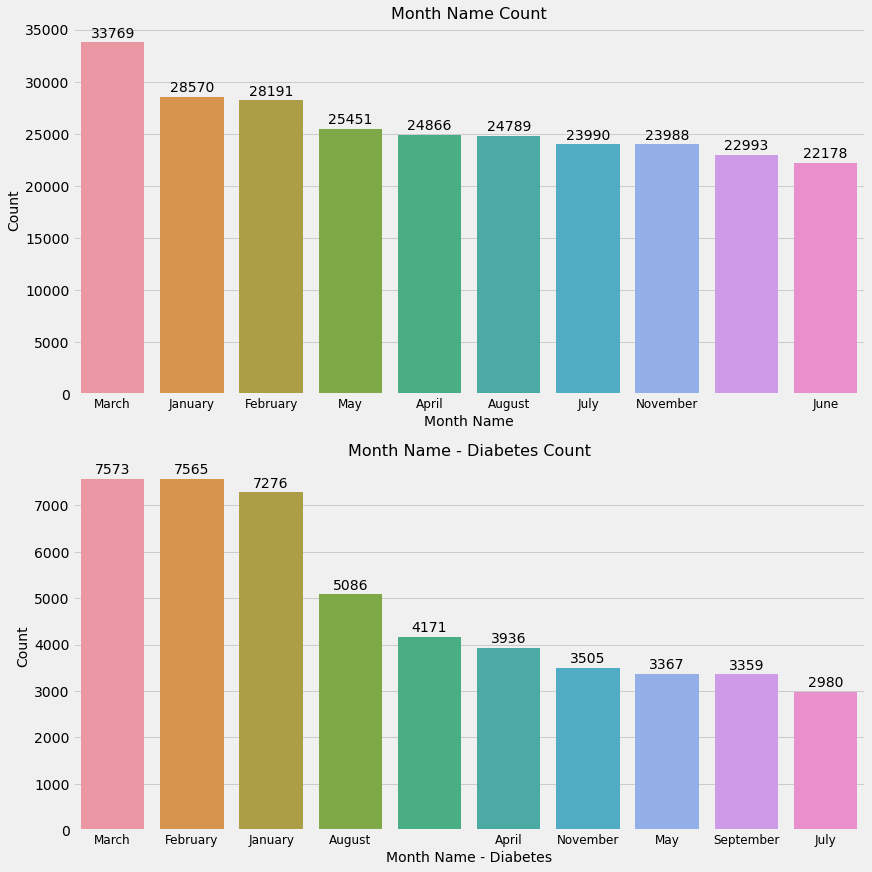

In [58]:
category_numeric_plots(local, 'Month Name')

- We fill the month null with the `0` because of the` calendar.month_name` do not accept anything else than numbers to git the months' name so, it appears as an unnamed column.
- It appears here that diabetics increase for some reason in three specific months, which are `March`, `February` and `January`, but we cannot say this is the truth because we suffer from a lack of data in two ways. First, we do not have data except for the years 2019 and 2018 and also the months of 2019 are not complete. This may be the reason and another reason, such as increasing awareness in those months, which motivates diabetics to regularize their hospital visits. To be sure, we need more investigation and more data, but now it is out of our scope.

<br><br>

## Provider names (Hospital / clinic) offering services of all patients vs diabetic patients

<br><br>

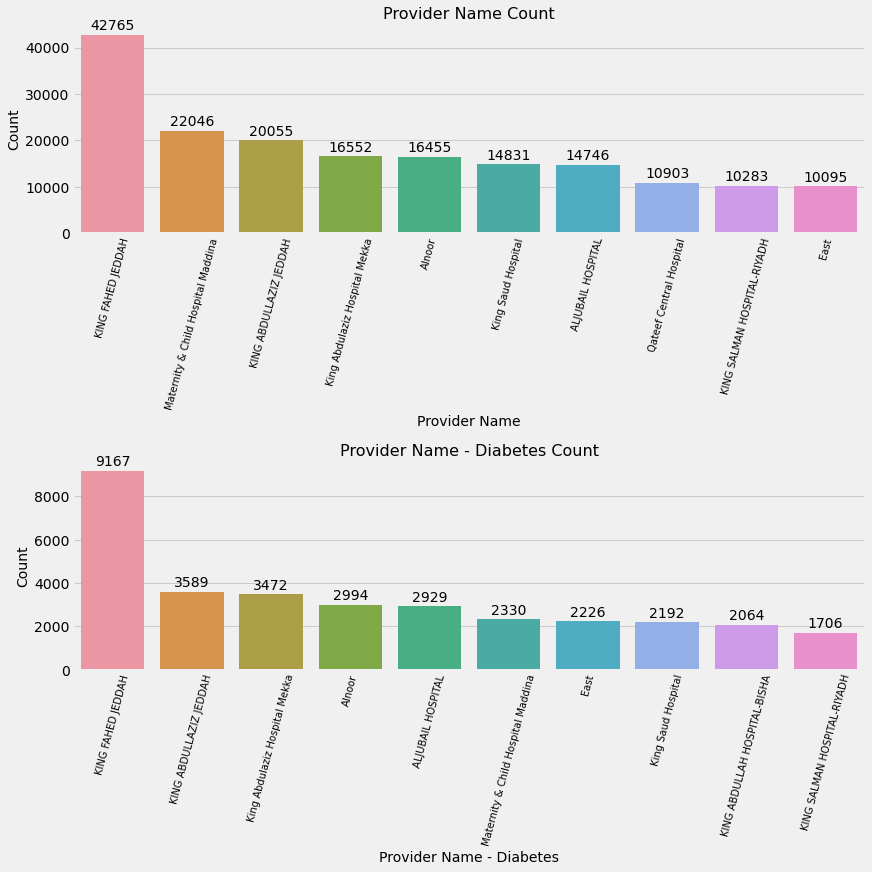

In [59]:
category_numeric_plots(local, 'Provider Name')

The hospital that serves the largest number of patients is King Fahd Hospital in Jeddah, whether diabetics or not, and the reason may be due to the size of the hospital or the quality of service.
Also, the number of patients in general will be much greater if we do this same graph on the complete data before merging it, but here in this project we will focus on our target which is diabetics

<br><br>

<br><br>

## Pie chart representation of all patients Gender vs diabetic patients

<br><br>

In [60]:
local['gender'].value_counts()

M    180380
F    118128
U         6
Name: gender, dtype: int64

In [61]:
local['gender'] = np.where(local['gender'] == 'U', 'M', local['gender'])

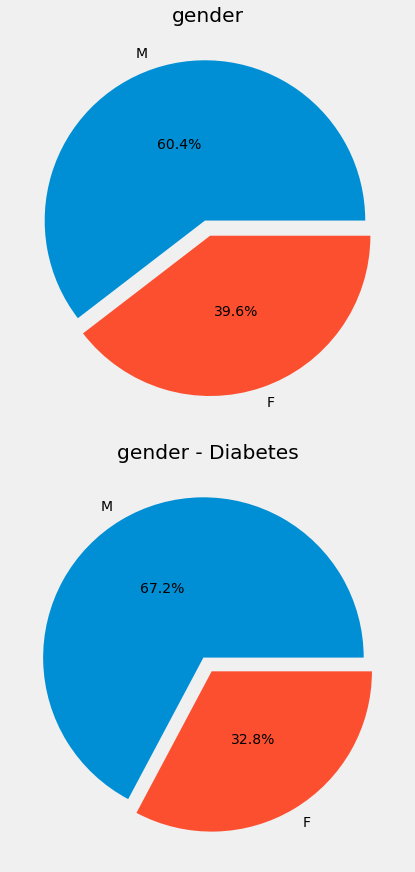

In [62]:
category_numeric_plots(local, 'gender')

- It seems that the men patients are more than women by nearly `10-17%`, whether diabetics or not, and honestly, this percentage is interesting. Do women really have more immunity than men !! Or are men more likely to visit hospitals than women !! Or perhaps the reason is simpler than this, which is the census of the Saudi population and residents, or it may be for any other reason, but it is outside the framework know.

<br><br>

## Nationality of all patients vs diabetic patients

<br><br>

In the previous section, we noticed that there are many synonyms or different writing methods for each nationality, and there is no fixed standard for naming. Therefore, we will build a special index for the nationalities that we have and then see how they are distributed or percentages for each nationality.

In [63]:
# filling null values with text instead of NaN to can converting all values to upper case 
fill_na_nat = local['Nationality'].fillna('AA',axis=0)

# converting all values to upper case and converting to list by split it with space 
# taking only first value if natinality in 'SAUDI', 'ARABIAN' or 'SAUDI', 'ARABIA' 
# else same value then converting to string
nat_lst = fill_na_nat.apply(lambda x: x.upper().split(' '))
nat_lst = [ 
    ''.join(nat[0]) if (nat == ['SAUDI', 'ARABIAN']) | (nat == ['SAUDI', 'ARABIA']) 
    else ''.join(nat) for nat in nat_lst
]

In [64]:
len(nat_lst)

298514

In [65]:
dict_nat = {
    'AFGAN' :['AFGHANI','AFGANI','AFGHAN','AFGHANESTAN','AFGHANISTAN'],
    'ALGERIAN': ['ALGERIA','ALGERIAN'],
    'ETHIOPIAN': ['ATHIOBYA','ATHUBIAN'],
    'BANGLADESHI': ['BANGLADESH','BANGLADISH','BANGLADISHI', 'PANGALADESH','PANGLADISH'],
    'BLOSHY': ['BALOOSHIAN''BELOUSHI','BLOOSHI','BLOSHI'],
    'BURMESE' : ['BORMA','BORMAN', 'PRAMAWY', 'BURMAWI-MAYANMAR','MAIANMAR', 'MAYANMAR', 'MYANMAR','PRAMAWY'],
    'CANADIAN' :['CANADA'],
    'CHADIAN': ['CHAD','CHADI', 'TESHADY'],
    'CHINESE' : ['CHINES'] ,
    'EGYPTIAN': ['EGYPTION'],
    'EMARATI': ['EMIRATE'],
    'ERYTRIAN': ['ERITREA','ERITREAN'],
    'FILIPINO': ['FHILLIPINO', 'PHILPENO','PLIPINO','PHILLIPINO'],
    'INDONESIAN': ['INDONISIAN','INDONISION','INDONISSIA','INDONISYA'],
    'IRAQI' :['IRAGI','LRAQI'],
    'IRANIANAQI' : ['IRIRAN'],
    'JORDANIAN' : ['JORDAN','JORDANAIN','JORDON'],
    'YEMENI': ['SOUTHYAMANIAN', 'YAMANI'],
    'UNKOWN': ['KABAEELNAZEHA','MOQEEM', 'NON-SAUDI','NONSAUDI', 'OTHER', 'OTHERASIAN','OTHERS','OTHERUROB''OTHEREUROPEAN','????', '??????????','AA','ARABSTATESCOOPERATIONCOUNCIL','SPECIALIST','UNKNOWN','WITHOUTID','WITHOUTNATIONALITY'],
    'KAZAKHSTANI' : ['KAZAKH'],
    'LEBANESE' : ['LEBANESS'],
    'MALAYSIAN' :['MALYSIA','MALYSIAN'],
    'MALI' :['MALIAN','MALY'],
    'MORITANIAN': ['MAURITANIAN','MORITANIA'],
    'MOROCCAN': ['MOROCCO','MOROCIAN','MORROCAN'],
    'NIGERIAN': ['NAIGERIAN','NIGER','NIGERIA','NIJIRIAN'],
    'AMERICAN': ['OHIO-USA'],
    'PAKISTANI': ['PAKESTAN','PAKESTANI','PAKISITANI','PAKSTANI','PALASTINIAN'],
    'PALESTINIAN': ['PALESTANINE','PALESTINE','PLASTIN','PALSTINIAN'],
    'Russian': ['RUS.','RUSSIAN'],
    'SENEGALI': ['SANQALI','SENIGAL','SINIGAL'], 
    'SERLANKI': ['SERILANKA'],
    'SOMALI': ['SOMALIA','SOMALIAN'],
    'SPANISH': ['SPANIAN'],
    'SRILANKAN': ['SRI-LANKAN','SRILANKA'],
    'SUDANESE' : ['SUDANE','SUDANI'],
    'SWISS' : ['SWITZERLAND'],
    'SYIRA': ['SYRIAN'],
    'THAILAND' :['THAI'],
    'TUNISIAN': ['TONES','TUNIS','TUNISA','TUNISH','TUNISIA'],
    'TURKISH' : ['TURK','TURKI'],
    'TURKISTANI': ['TURKSHCAICOSIN']
       
         }

In [66]:
local['Nationality'] = modifing_categories(local, 'Nationality', dict_nat)

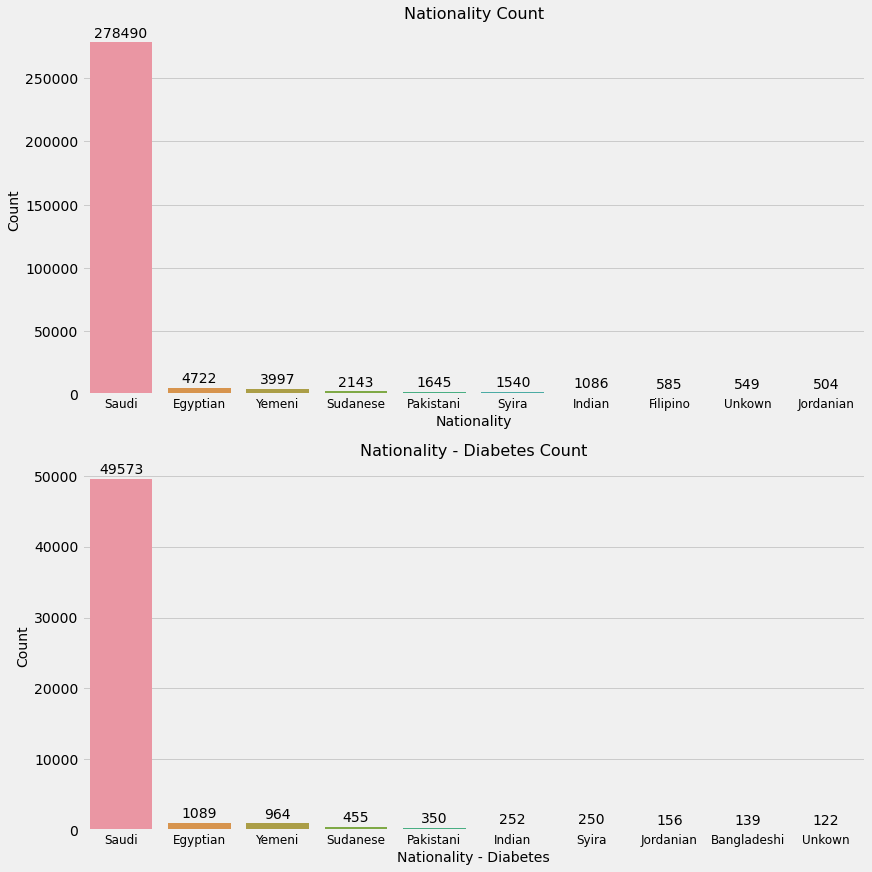

In [67]:
category_numeric_plots(local, 'Nationality')


The overwhelming percentage of patients is Saudis, and once again the result appears correct, because most if not all government hospitals serve only Saudis for free, but to warn again, the number of patients in general will be greater if the same graph is made on the complete data, regardless of whether it is Diabetic or suffering from something else, but it is not our goal.

## Encounter type of all patients vs diabetic patients

<br><br>

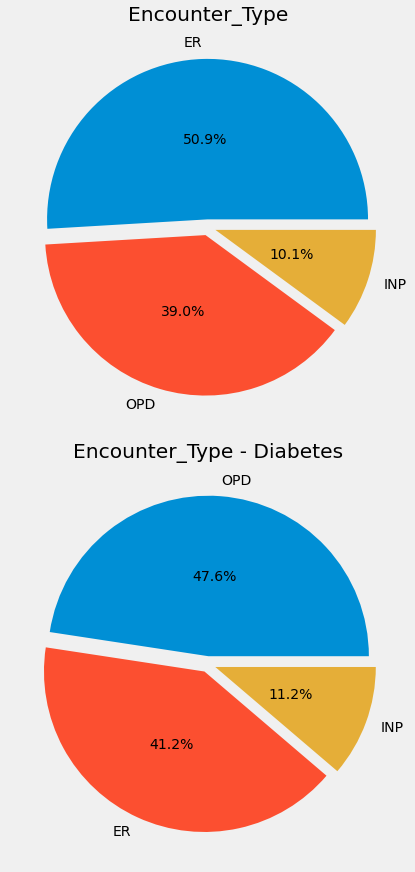

In [68]:
category_numeric_plots(local, 'Encounter_Type')

<br><br>

##  Clinics visited by of all patients vs diabetic patients

<br><br>

We will apply the same thing that we did with the names of the nationalities here again on the names of clinics

In [69]:
dict_clinic ={
    'EMERGENCY DEPARTMENT': ["Emergency",'EMERGENCY','EMERGENCY ROOM', 'Emergency Clinic', 'EMERGANCY DEPT(ED)','EMERGENCY CLINIC','?EMERGENCY', 'EMERGENCYCLINIC', 'Emergecy','--DELETED--', 'AA'],
    'Emergency Male': ['ER MALE','ER Male', 'ER MALE CLINIC'],
    'Diabetic Clinic': ['Diabetic - Specialist', '?Endocrinology & Diabetic Clinic', 'DIABETIC CLINIC','Diabete Clinic', 'Specialist clinic(Diabetic)', ]
   }

In [70]:
local['Clinic'] = modifing_categories(local, 'Clinic', dict_clinic)

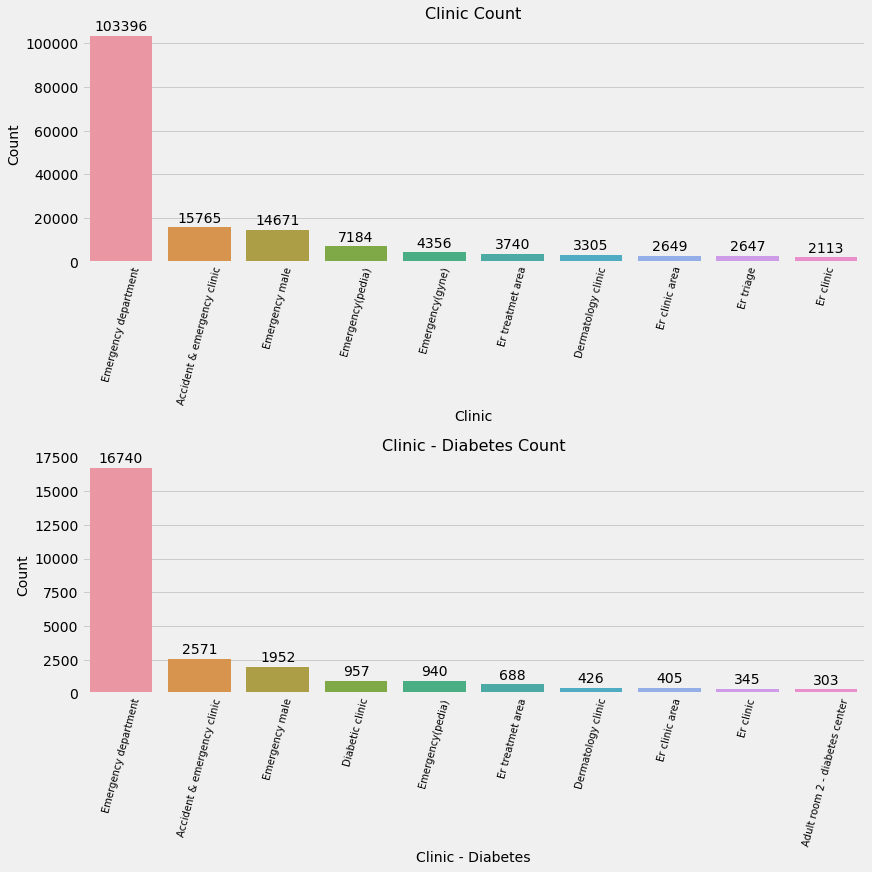

In [71]:
category_numeric_plots(local, 'Clinic')

Half of the patients in general are served first by the emergency department `ER` and then outpatient clinics or the Abbreviation for outpatient department `OPD`, but in diabetics it is almost the opposite and it seems logical because patients in general can complain of anything, accidents, acute pain and other accidents, but diabetics if their visit is normal, they often go to a specific doctor In the outpatient clinic for periodic examinations.

<br><br>

## Top ten Diagnosis description  - diabetic vs none-diabetic

<br><br>

In [72]:
# removing space from the begining of Dignosis
local['Diagnosis Description'] = local['Diagnosis Description'].apply(lambda x: x[1:] if x.startswith(' ') else x.replace(', ', ' ') if ', ' in x else x)

In [73]:
diabetes_dignosis = local[local['has_diabetes'] == True]

diabetes_dignosis = pd.DataFrame(diabetes_dignosis['Diagnosis Description'].value_counts()[:15]).reset_index()
all_dignosis = pd.DataFrame(local['Diagnosis Description'].value_counts()[:15]).reset_index()
diabetes_nondibetes = pd.merge(diabetes_dignosis, all_dignosis, how='inner', on='index')
diabetes_nondibetes = diabetes_nondibetes.rename(columns={
                        'Diagnosis Description_x':'Diagnosis Count - Has Diabetes',
                        'Diagnosis Description_y': 'Diagnosis Count - Has not Diabetes',
                        'index': 'Diagnosis Description'
})
diabetes_nondibetes

,Diagnosis Description,Diagnosis Count - Has Diabetes,Diagnosis Count - Has not Diabetes
0,Acute pain,1917,10453
1,Pain unspecified,1342,7384
2,Essential (primary) hypertension,1232,2913
3,Acute upper respiratory infection unspecified,1160,10174
4,CLINICAL DIAGNOSIS IS NOT FOUND,1099,4231
5,Low back pain,782,4752
6,Cough,756,5122
7,SICKLE-CELL ANAEMIA WITH CRISIS,746,3184
8,Headache,630,3874
9,Abdominal and pelvic pain,614,3879


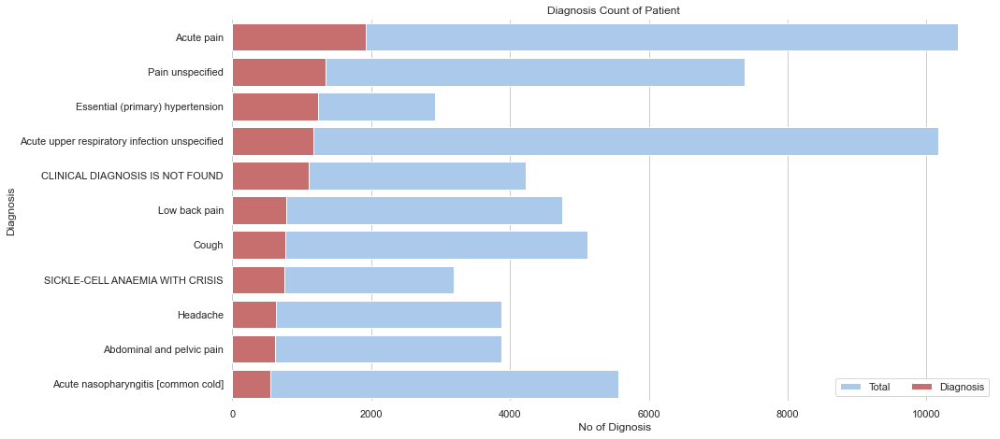

In [74]:
sns.set(style='whitegrid')

f, ax = plt.subplots(figsize=(13,7))

sns.set_color_codes('pastel')
sns.barplot(x='Diagnosis Count - Has not Diabetes', y='Diagnosis Description', data=diabetes_nondibetes,
            label='Total', color='b')

sns.set_color_codes('muted')
sns.barplot(x='Diagnosis Count - Has Diabetes', y='Diagnosis Description', data=diabetes_nondibetes,
            label='Diagnosis', color='r')

ax.legend(ncol=2, loc='lower right', frameon=True)
ax.set(ylabel='Diagnosis', title='Diagnosis Count of Patient',
       xlabel=' No of Dignosis')
sns.despine(left=True, bottom=True)

In general, diabetics do not always complain of multiple pain.

## Diagnosis Type  - diabetic vs none-diabetic

<br><br>

In [75]:
local['Diagnosis Type'].value_counts()

Principal Diagnosis     276777
Additional Diagnosis     21737
Name: Diagnosis Type, dtype: int64

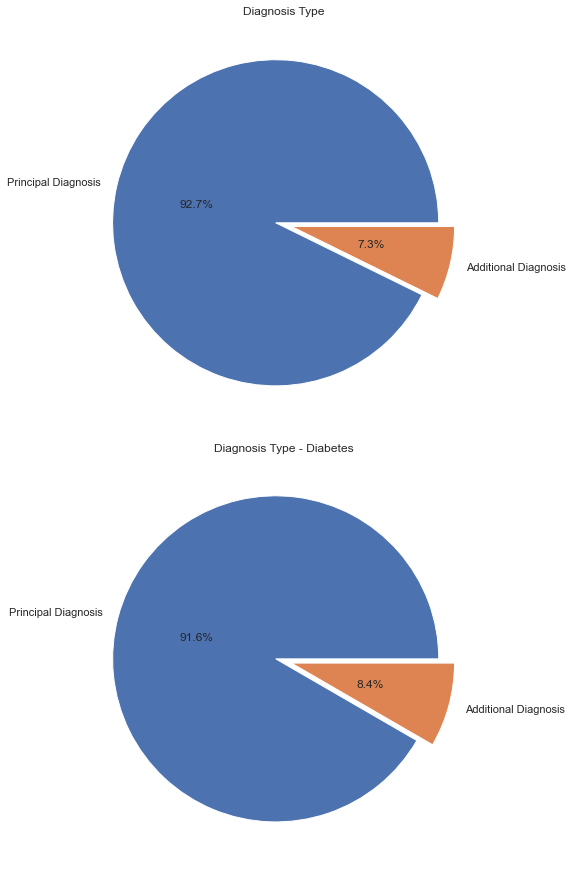

In [76]:
category_numeric_plots(local, 'Diagnosis Type')

- The principal diagnosis is defined as “the condition, after study, which caused the admission to the hospital,” according to the ICD-10-CM Official Guidelines for Coding and Reporting, FY 2016. This is not necessarily what brought the patient to the emergency room.


- Secondary diagnoses are “conditions that coexist at the time of admission, that develop subsequently, or that affect the treatment received and/or length of stay. Diagnoses that relate to an earlier episode which have no bearing on the current inpatient admission should be excluded,” according to the Uniform Hospital Discharge Data Set.

And here the majority of diagnoses come from `The principal diagnosis`.

<br><br>

## Height  - diabetic vs none-diabetic

<br><br>

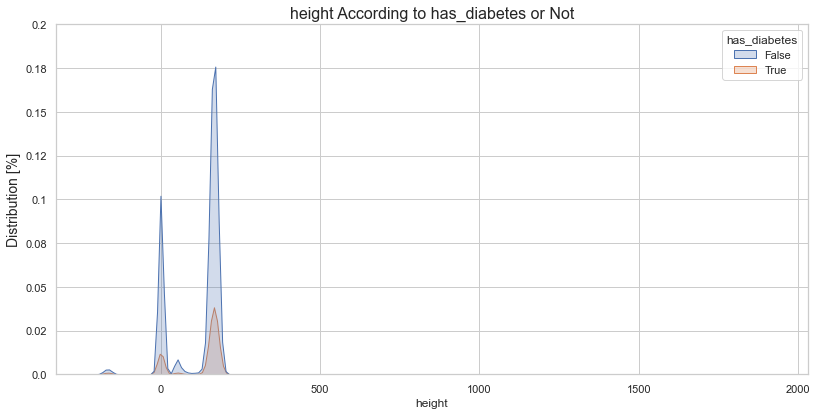

In [77]:
category_numeric_plots(local, 'height')

As we mentioned before, the height contains completely irrational values, so here we clearly see that we have outliers that strongly affect the distribution, and we also have a fair number about ten percent of which their height is zero, and also there are negative values.

## Weight  - diabetic vs none-diabetic

<br><br>

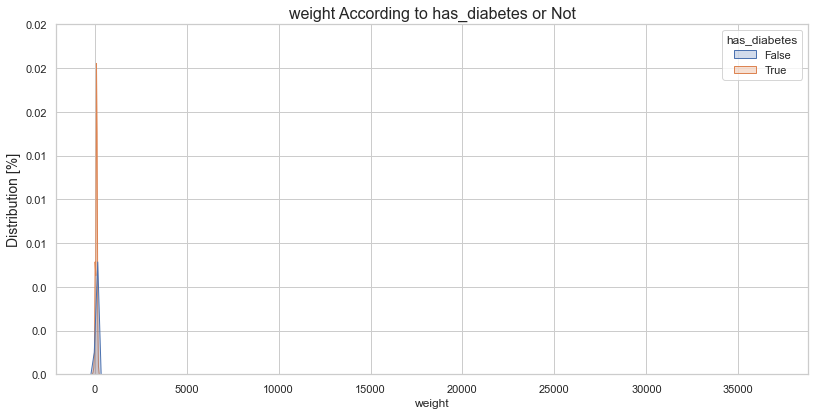

In [78]:
category_numeric_plots(local, 'weight')

The outliers here have a greater effect on the weight than on the height, since all we see is zero, but in fact it is not.

## Age Distribution  - diabetic vs none-diabetic

<br><br>

We extracted age from the Year of Birth column here to get its distribution

In [79]:
local['Date of Birth'] = pd.to_datetime(local['Date of Birth'])
local['Year of Birth'] = local['Date of Birth'].apply(lambda x: x.year)
local['age'] = local['Year of Birth'].apply(lambda x: (2021 - x))

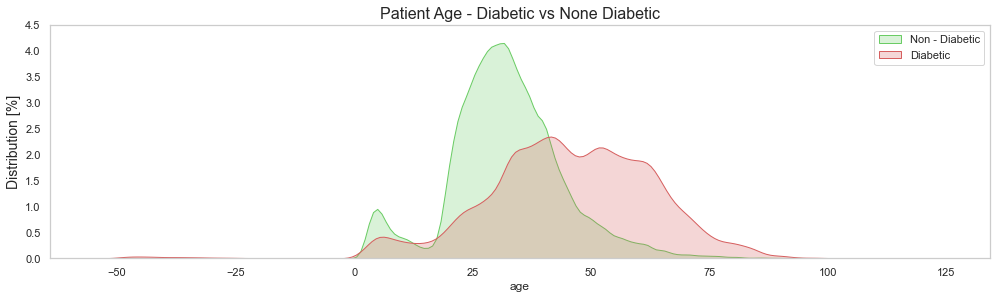

In [80]:
plt.figure(figsize=(15,4))
ax = sns.kdeplot(local.loc[(local['has_diabetes'] == False), 'age'], color='g', shade=True, label='Non - Diabetic')
ax = sns.kdeplot(local.loc[(local['has_diabetes'] == True), 'age'], color='r', shade=True, label='Diabetic')

plt.grid(b=None)
plt.legend()
plt.title('Patient Age - Diabetic vs None Diabetic', fontsize=16)
plt.yticks(ax.get_yticks(), [ round(num*100,2) for num in ax.get_yticks()])
plt.ylabel('Distribution [%]', fontsize=14);

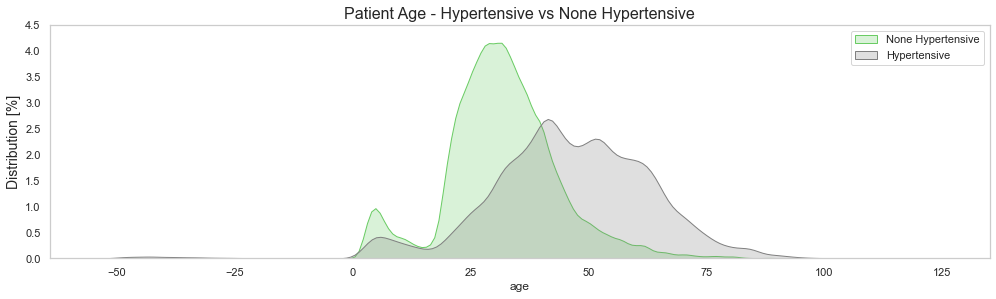

In [81]:
plt.figure(figsize=(15,4))
ax = sns.kdeplot(local.loc[(local['has_hypertension'] == False), 'age'], color='g', shade=True, label='None Hypertensive')
ax = sns.kdeplot(local.loc[(local['has_hypertension'] == True), 'age'], color='gray', shade=True, label='Hypertensive')

plt.grid(b=None)
plt.legend()
plt.title('Patient Age - Hypertensive vs None Hypertensive', fontsize=16)
plt.yticks(ax.get_yticks(), [ round(num*100,2) for num in ax.get_yticks()])
plt.ylabel('Distribution [%]', fontsize=14);

Despite the presence of outliers or negative values that affect the age distribution, it appears clearly that the distribution of people without diabetes is mostly from the youth group, as for the next age group, the number of people with diabetes increases, which is often in the range of thirty to sixty years. This also applies to people with high blood pressure or not.

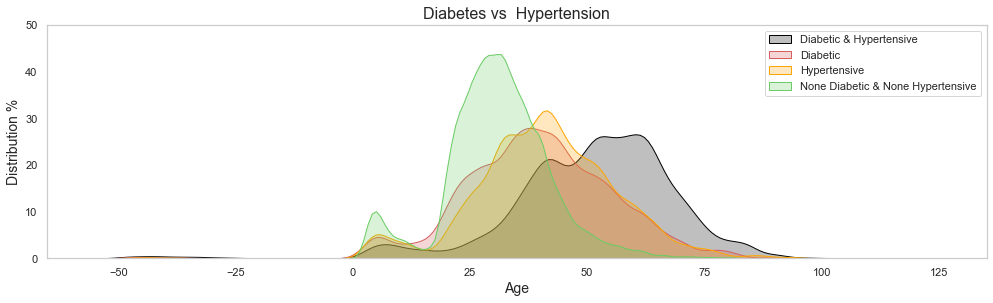

In [82]:
plt.figure(figsize=(15,4))

ax = sns.kdeplot(
    local.loc[(local['has_diabetes'] == True) & (local['has_hypertension'] == True), 'age'], 
    color='black', shade=True, label='Diabetic & Hypertensive')

ax = sns.kdeplot(
    local.loc[(local['has_diabetes'] == True) & (local['has_hypertension'] == False), 'age'],
    color='r', shade=True, label='Diabetic')

ax = sns.kdeplot(
    local.loc[(local['has_diabetes'] == False) & (local['has_hypertension'] == True), 'age'],
    color='orange', shade=True, label='Hypertensive')

ax = sns.kdeplot(
    local.loc[(local['has_diabetes'] == False) & (local['has_hypertension'] == False), 'age'],
    color='g', shade=True, label='None Diabetic & None Hypertensive')

plt.grid(b=None)
plt.legend() #labels=['Diabetic', 'Hypertensive', 'Diabetic & Hypertensive','None Diabetic & None Hypertensive'])

plt.title('Diabetes vs  Hypertension', fontsize=16)
plt.xlabel('Age', fontsize=14)
plt.yticks(ax.get_yticks(), [ round(num*1000) for num in ax.get_yticks()])
plt.ylabel('Distribution %', fontsize=14);

This graph is very useful as it is very clear regardless of outliers and negative values. We can see here that the age group that often suffers from diabetes is the same age group in which a person may suffer from hypertension, as we can see that those who are healthy from hypertension and diabetes are the young group, and the opposite applies to those with hypertension and diabetes together.

Usually this is true because with age, weight gain, poor nutrition or poor lifestyle, and psychological pressures, a person’s susceptibility to acquiring diseases increases.

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_4'>


<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 4: Initial cleaning
        <br><br>


<br><br><br>

We will clean the data Initial cleaning and then take the result to try different cleaning scenarios

### 1-Diagnosis Description column

In [83]:
local['Diagnosis Description'].value_counts().head(20)

Acute pain                                              10453
Acute upper respiratory infection unspecified           10174
Pain unspecified                                         7384
Acute nasopharyngitis [common cold]                      5560
Cough                                                    5122
Low back pain                                            4752
Supervision of normal pregnancy unspecified              4465
Other and unspecified abdominal pain                     4234
CLINICAL DIAGNOSIS IS NOT FOUND                          4231
Abdominal and pelvic pain                                3879
Headache                                                 3874
Sickle-cell anaemia with crisis                          3479
SICKLE-CELL ANAEMIA WITH CRISIS                          3184
Essential (primary) hypertension                         2913
Fever unspecified                                        2861
OTHER DISEASES.                                          2784
Noninfec

Before we found the unique ID, we noticed that some diagnoses are repeated but with other differences. For example, there are many types of pain, acute pain, foot pain, so we collected the diagnoses on the basis of the category and chose only what we find specialized in diabetes, and we did not take it on the basis of recurrence because the pain, for example, is one of the most frequent diagnoses, but it does not necessarily indicate diabetes, meaning that it is medically inaccurate.

In [84]:
type_2 = []
type_1 = []
hyperten = []
obesity = []
hypercholest = []
for value in local[local['has_diabetes'] == True]['Diagnosis Description'].values.tolist():
    if 'Type 1' in value:
        type_1.append(value)
    elif 'type 1' in value:
        type_1.append(value)
    elif 'TYPE 1' in value:
        type_1.append(value)
    elif 'Type 2' in value:
        type_2.append(value)
    elif 'type 2' in value:
        type_2.append(value)
    elif 'TYPE 2' in value:
        type_2.append(value)
    elif 'hyperten' in value:
        hyperten.append(value)
    elif 'Hyperten' in value:
        hyperten.append(value)
    elif 'HYPERTEN' in value:
        hyperten.append(value)
    elif 'obesity' in value:
        obesity.append(value)
    elif 'OBESITY' in value:
        obesity.append(value)
    elif 'Obesity' in value:
        obesity.append(value)
    elif 'hypercholest' in value:
        hypercholest.append(value)

The indicators that we have chosen are `Type 2`, `Hypertension`, `Obesity`, `Type 1`, `Hyperglycaemia` and `hypercholesterolaemia`.
By the way, the columns for type 1 and type 2 diabetes are just diagnoses, and it is not necessary that everyone who is diagnosed with one of them actually has diabetes. Therefore, the sum of their percentage or their number together does not mean that it is the total percentage of diabetics

In [85]:
local['Diagnosis Description'] =  local['Diagnosis Description'].apply(lambda x: 'Type 1' if x in type_1 else 'Type 2' if x in type_2 else x)
local['Diagnosis Description'] =  local['Diagnosis Description'].apply(lambda x: 'Hypertension' if x in hyperten else 'Obesity' if x in obesity else x)
local['Diagnosis Description'] =  local['Diagnosis Description'].apply(lambda x: 'Hyperglycaemia' if x == 'Hyperglycaemia unspecified' else x)
local['Diagnosis Description'] =  local['Diagnosis Description'].apply(lambda x: 'hypercholesterolaemia' if x == 'Pure hypercholesterolaemia' else x)

In [86]:
local['Type 2'] = np.where(local['Diagnosis Description'] == 'Type 2', 1, 0)
local['Hypertension'] = np.where(local['Diagnosis Description'] == 'Hypertension', 1, 0)
local['Obesity'] = np.where(local['Diagnosis Description'] == 'Obesity', 1, 0)
local['Type 1'] = np.where(local['Diagnosis Description'] == 'Type 1', 1, 0)
local['Hyperglycaemia'] = np.where(local['Diagnosis Description'] == 'Hyperglycaemia', 1, 0)
local['hypercholesterolaemia'] = np.where(local['Diagnosis Description'] == 'hypercholesterolaemia', 1, 0)

In [87]:
local[['Type 1','has_diabetes']].value_counts()

Type 1  has_diabetes
0       False           244275
        True             52268
1       True              1779
        False              192
dtype: int64

In [88]:
fig = px.pie(local,names='Type 1',title='Diabetes Type 1 ')
fig.show()

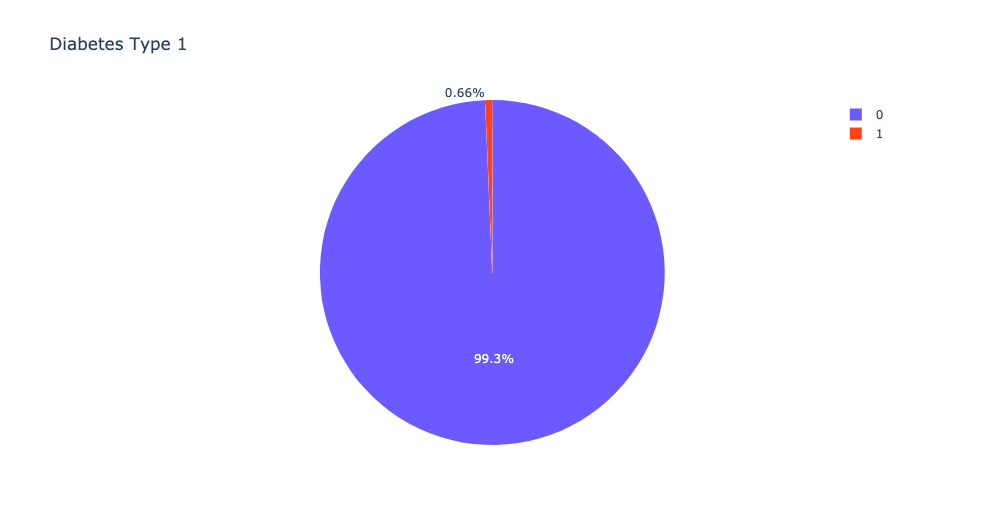

In [89]:
local[['Type 2','has_diabetes']].value_counts()

Type 2  has_diabetes
0       False           244132
        True             50313
1       True              3734
        False              335
dtype: int64

In [90]:
fig = px.pie(local,names='Type 2',title='Diabetes Type 2 ')
fig.show()

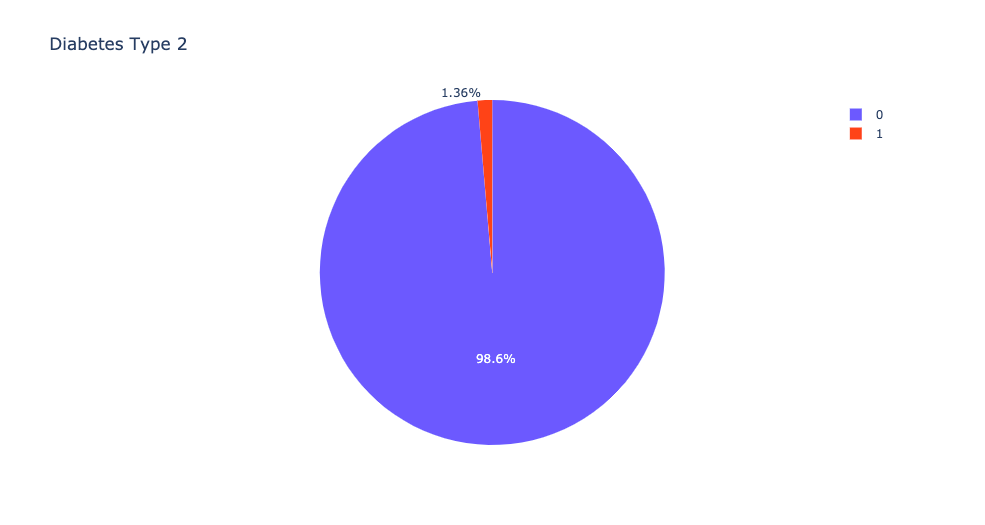

### 2-Patient ID column

Then we sort the `Service Date` and take the last duplicated Id for eatch patient.

In [91]:
sorted = local.sort_values(['Service Date'], ascending = [True], na_position='first')

local = sorted.groupby('Patient_ID').last().reset_index()


In [92]:
local['Patient_ID'].duplicated().sum()

0

In [93]:
local.shape

(94602, 38)

Now, we have a unique Id let's see another column and the local data shape wes `(298514, 28)` and now `(94602, 38)`.

In [94]:
fig = px.pie(local,names='has_diabetes',title='The prevalence of diabetes in Saudi Arabia')
fig.show()

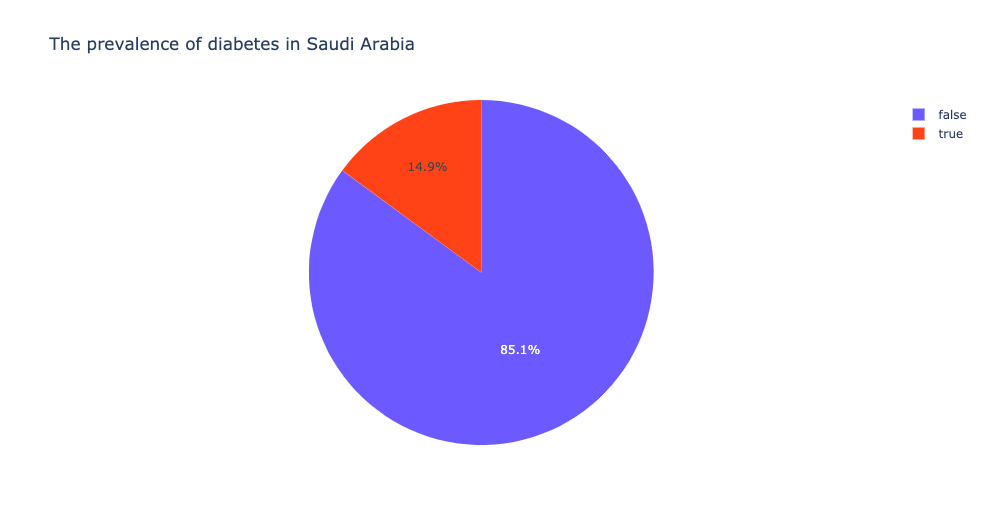

As we expected before, the percentage of diabetic patients decreased when we removed the frequent IDs of patients it was `18.1%`, and now it is `14.9%`.

In [95]:
#removing unneeded columns or column with high percentage of missing value
new_local= local.copy()
new_local.drop(['Patient_ID', 'U_Encounter_ID_x', 'Service Type', 'Service_Code',
       'Service Name', 'Quantity', 'Service Date', 'VitalSigns',
       'U_Encounter_ID_y', 'Provider Name', 'Admission Date/Time',
       'Discharge Date/Time', 'Encounter_Type', 'Duration of leave',
       'Date of Birth', 'Gender',  'Discharge Mode', 'Clinic',
       'MaritalStatus', 'Diagnosis Description', 'Diagnosis Code',
       'Diagnosis Type', 'Month', 'Month Name', 'Year of Birth'],axis=1,inplace=True)

In [96]:
new_local.head(2)

,Nationality,height,weight,gender,has_diabetes,has_hypertension,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia
0,Saudi,162.0,83.0,M,True,False,60.0,0,0,0,0,0,0
1,Saudi,NaN,NaN,M,False,False,39.0,0,0,0,0,0,0


### 3-Age column

<br><br>

From here, we can clearly see outliers and negative values for age, so we will deal with each of us separately after investigation

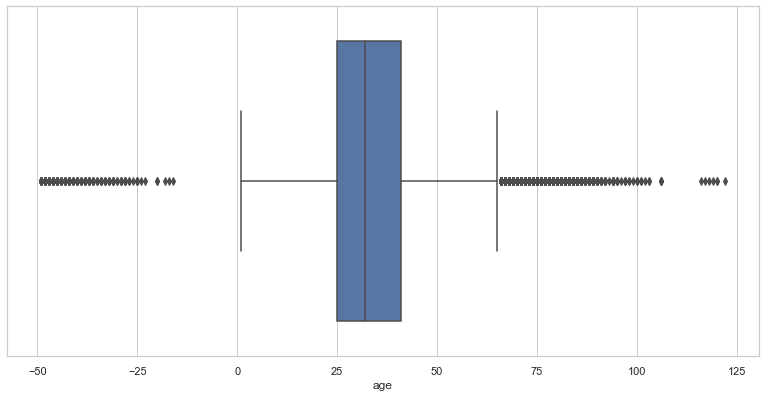

In [97]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['age']);

In [98]:
neg_age=[]
pd.Series(neg_age)
for i in new_local['age']:
    if i <=0:
        neg_age.append(i)
        


In [99]:
len(neg_age)

210

In [100]:
(len(neg_age)/len(new_local['age']))*100

0.22198262193188303

There is `210` negative value in `age` column and it's only `0.221%` of the total column values, we will assume that happened by mistake and deal with the absolute value for the `age` column.

In [101]:
new_local['age']=abs(new_local['age'])

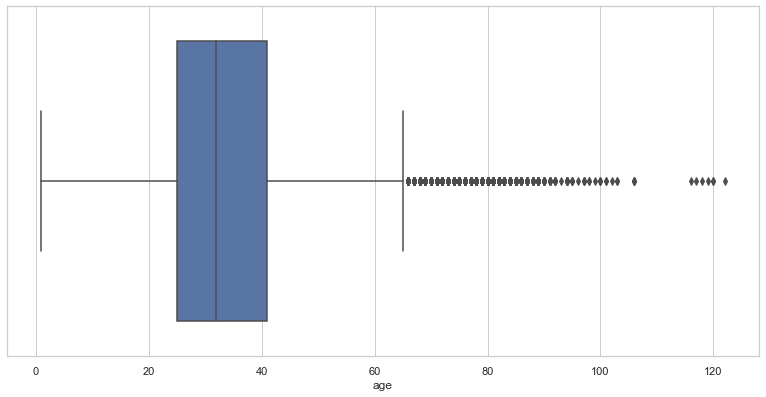

In [102]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['age']);

In [103]:
old_age=[]
pd.Series(old_age)

for i in new_local['age']:
    if i >60:
        old_age.append(i)
        
len(old_age)

4104

In [104]:
(len(old_age)/len(new_local['age']))*100

4.338174668611657

In [105]:
len(new_local[(new_local['has_diabetes']==1) & (new_local['age']>60)])


2605

In [106]:
(len(new_local[(new_local['has_diabetes']==1) & (new_local['age']>60)])/len(new_local['has_diabetes']))*100

2.7536415720597875

In [107]:
old_age=[]
pd.Series(old_age)

for i in new_local['age']:
    if i >100:
        old_age.append(i)
        
len(old_age)

16

In [108]:
(len(old_age)/len(new_local['age']))*100

0.016912961671000613

In [109]:
len(new_local[(new_local['has_diabetes']==1) & (new_local['age']>60)])


2605

In [110]:
(len(new_local[new_local['has_diabetes']==1])/len(new_local['has_diabetes']))*100

14.921460434240291

In [111]:
(len(new_local[(new_local['has_diabetes']==1) & (new_local['age']>100)])/len(new_local['has_diabetes']))*100

0.0021141202088750767

In [112]:
indexNames = new_local[ new_local['age'] >100 ].index
new_local.drop(indexNames , inplace=True)

In the age column, we may not be able to get rid of all the outliers values, because the percentage of people with diabetes and their age over 60 years old is `2%` of diabetics compared to the total percentage of them, which is `14%`.
But the percentage of patients with diabetes and their age above 100 is very small, so we can drop them to reduce noise on the model.

<br><br><br>


---
<br><br><br>

### 4-Nationality column

<br><br>

In [113]:
len(new_local[new_local['Nationality']=='Saudi'])/len(new_local.Nationality)*100

93.23367094496014

- Knowledge of race is a very important indicator for identifying diabetes patients, as it abounds in certain races in a very large percentage, but because `93%` of our patients are Saudis, so this indicator loses its value, and nationality does not necessarily mean knowledge of race, so what we will do is that we will make a column that tells us if it is Saudi or not. 


- `1=Saudi` and `0= not Saudi`

In [114]:
new_local['Saudi'] = new_local.Nationality.map(lambda x:1 if x=='Saudi' else 0)

In [115]:
saudi = new_local[new_local['Saudi']==1]

In [116]:
fig = px.pie(saudi,names='has_diabetes',title='The prevalence of diabetes among Saudis')
fig.show()

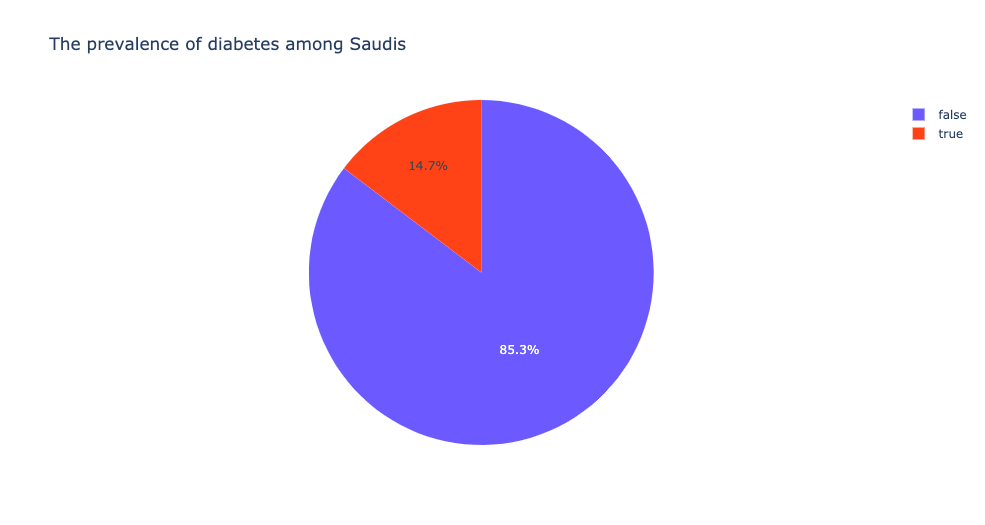

The prevalence of diabetes among Saudis `(14.7%)` is very, very close to the prevalence of diabetes in Saudi Arabia `(14.9)`, including all the nationalities mentioned in our data, and this reason is due to the fact that the number of other nationalities is so small that we cannot compare the prevalence of diabetes in Saudi Arabia between all nationalities and between the Saudis themselves.

In [117]:
new_local.drop(['Nationality'],axis=1,inplace=True)

<br><br><br>


---
<br><br><br>

### 5- Height column


<br><br>

From here, we can clearly see outliers and negative values for age, so we will deal with each of us separately after investigation

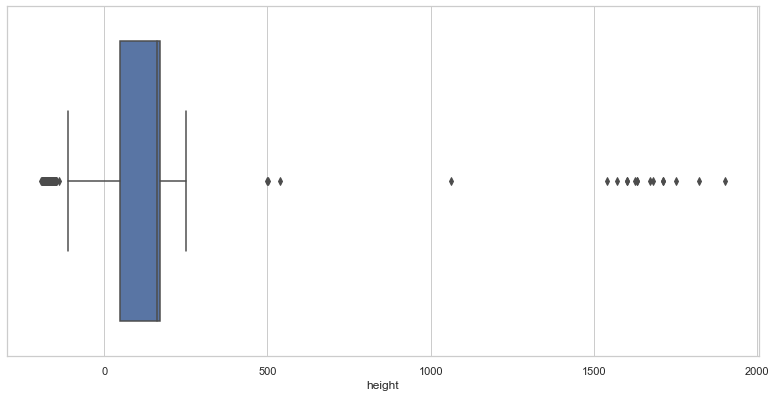

In [118]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['height']);

In [119]:
neg_hight=[]
pd.Series(neg_hight)

for i in new_local['height']:
    if i <=0:
        neg_hight.append(i)
        
len(neg_hight)

11375

In [120]:
(len(neg_hight)/len(new_local['height']))*100

12.026092656418498

`12%` of the hight under `0` so we will deal with it as a mistake and take the  absolute value for the column

In [121]:
new_local['height']=abs(new_local['height'])

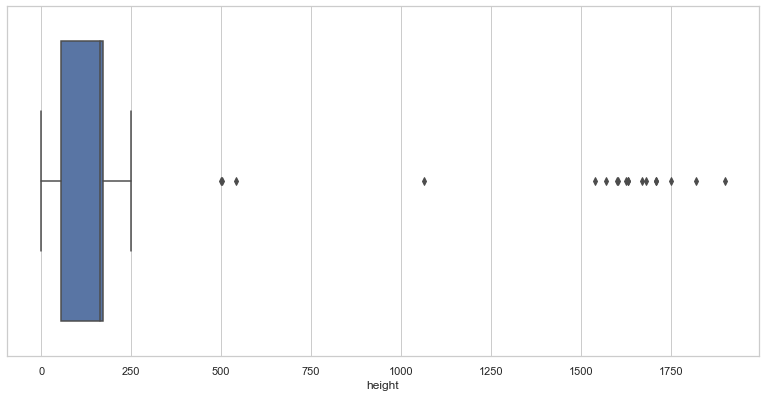

In [122]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['height']);

In [123]:
high_hight=[]
pd.Series(high_hight)

for i in new_local['height']:
    if i >250:
        high_hight.append(i)
        
len(high_hight)

18

In [124]:
(len(high_hight)/len(new_local['height']))*100

0.0190303004672996

Since the percentage of outliers is almost negligible, perhaps it is better to get rid of them.

In [125]:
indexNames = new_local[ new_local['height'] >250 ].index
new_local.drop(indexNames , inplace=True)


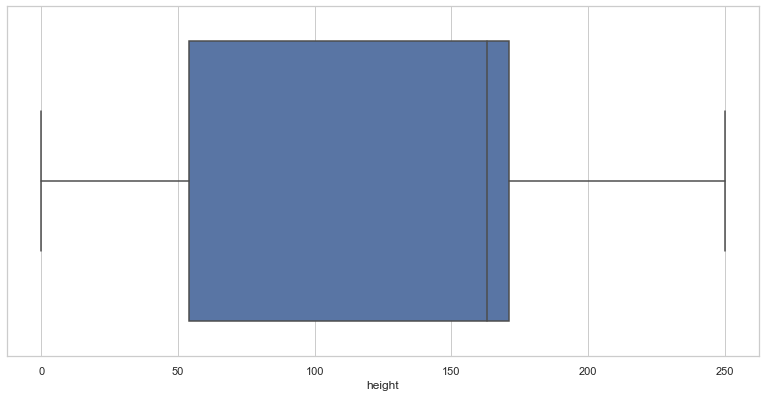

In [126]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['height']);

<br><br><br>


---
<br><br><br>

### 6- Weight column

<br><br>

From here, we can clearly see outliers and negative values for age, so we will deal with each of us separately after investigation

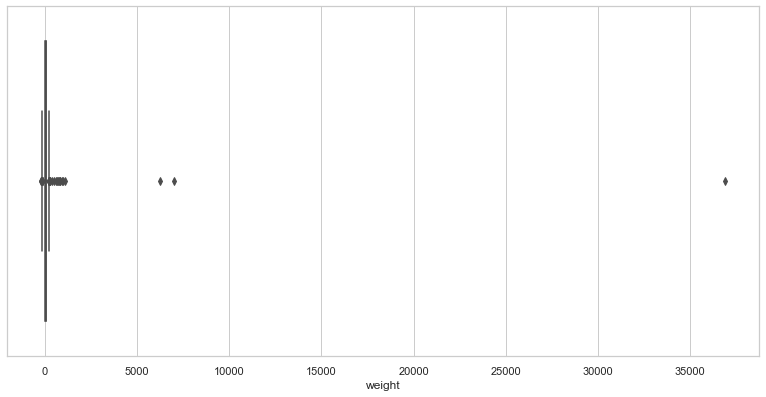

In [127]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['weight']);

In [128]:
high_weight=[]
pd.Series(high_weight)

for i in new_local['weight']:
    if i >200:
        high_weight.append(i)
        
len(high_weight)

26

In [129]:
(len(high_weight)/len(new_local['weight']))*100

0.027493443871076894

In [130]:
neg_weight=[]
pd.Series(neg_weight)

for i in new_local['weight']:
    if i <0:
        neg_weight.append(i)
        
len(neg_weight)

503

In [131]:
(len(neg_weight)/len(new_local['weight']))*100

0.5318923948904491

There is `26` person whose weight is greater than 200 kilograms, and these values are not at all normal, so we will delete them and also there are `503` people whose weight is less than zero. Here also we will deal with it as an error and we will take the absolute value of the weight column.

In [132]:
new_local['weight']=abs(new_local['weight'])

In [133]:
indexNames = new_local[ new_local['weight'] >200 ].index
new_local.drop(indexNames , inplace=True)


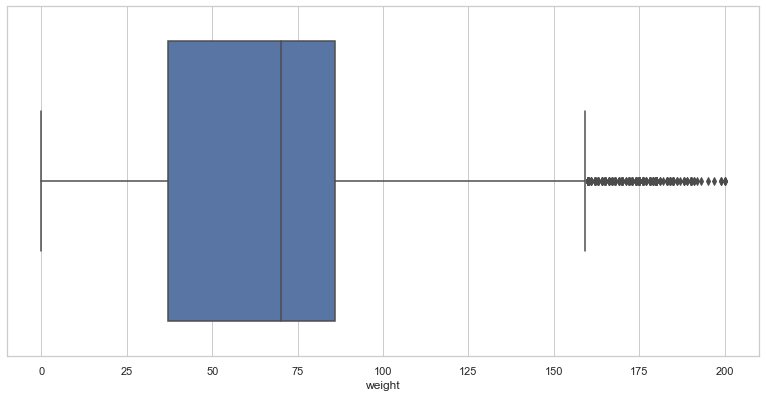

In [134]:
plt.figure(figsize=(12,6))
sns.boxplot(new_local['weight']);

In [135]:
high_weight=[]
pd.Series(high_weight)

for i in new_local['weight']:
    if i >160:
        high_weight.append(i)
        
len(high_weight)

227

In [136]:
(len(high_weight)/len(new_local['weight']))*100

0.24010492691079097

Also, we can drop any value`>160`

In [137]:
indexNames = new_local[ new_local['weight'] >160 ].index
new_local.drop(indexNames , inplace=True)


<br><br><br>


---
<br><br><br>

### 6- Gender column

<br><br>

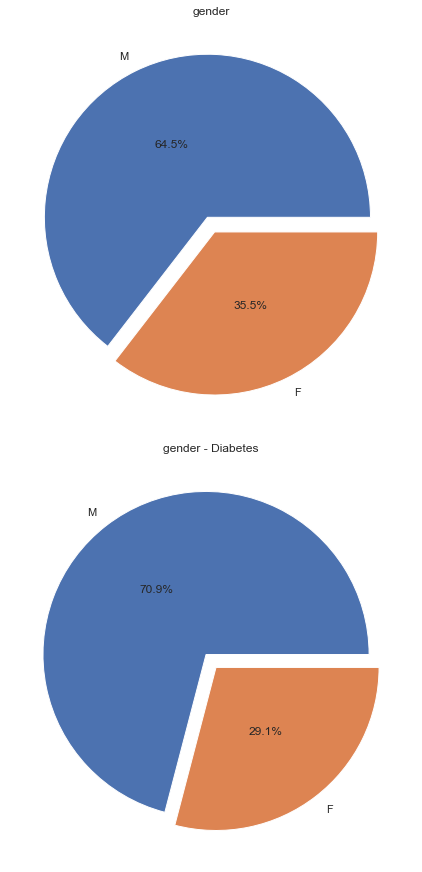

In [138]:
category_numeric_plots(new_local, 'gender')

Before removing the duplicate values of ID for patients, the percentage of male patients was higher than women, especially with diabetes, but after removing the repeated values, this percentage increased to reach that 70% of diabetics are men.
We do not know what is the reason behind this percentage, but it appears to be interesting and needs detailed study.

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_5'>


        
<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 5: Cleaning and features engineering with different scenarios
        <br><br>


<br><br><br>

- As for filling in the missing data, we will follow several procedures due to the sensitivity of the medical data and also because in the height and weight columns, almost half of their data are missing.
- For each scenario we will follow we will build a model.

<br><br><br>

Before we start with the scenarios let's take a look at our data after the initial cleanup

In [139]:
perc_nan(new_local)

,No_NaN,Percent
age,108,0.114510
has_hypertension,6770,7.178073
weight,47379,50.234851
height,47943,50.832847


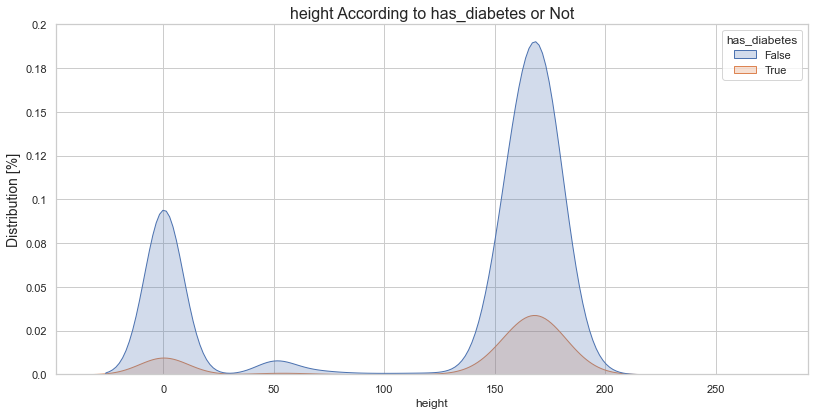

In [140]:
category_numeric_plots(new_local, 'height')

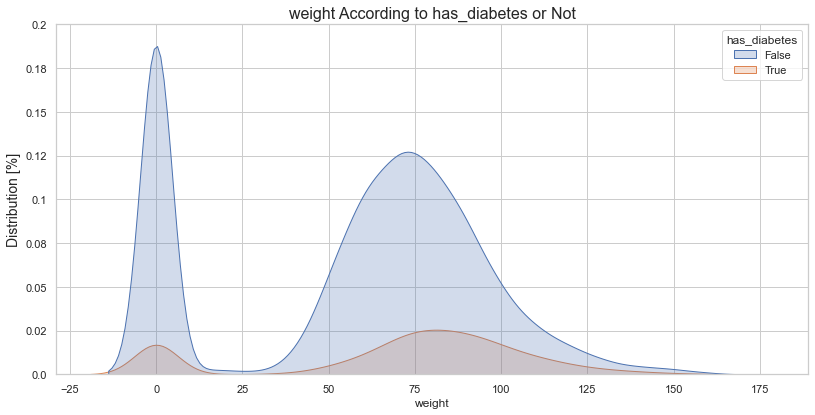

In [141]:
category_numeric_plots(new_local, 'weight')

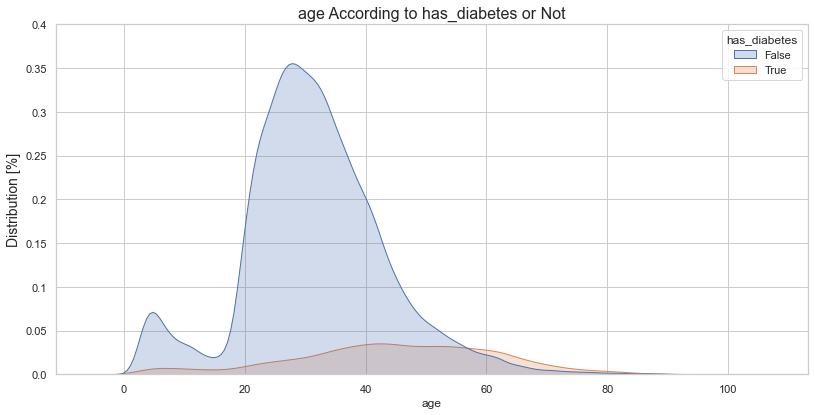

In [142]:
category_numeric_plots(new_local, 'age')

In [143]:
fig = px.pie(new_local,names='has_hypertension',title='Hypertension percentage')
fig.show()

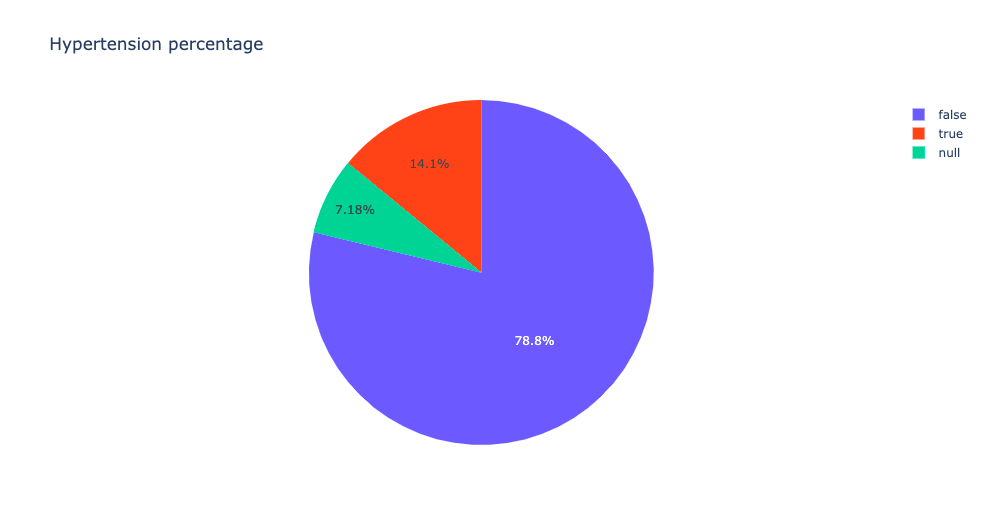

- It seems that age contains missing data, but it is very, very little, and the way it is filled out almost does not affect the data. 


- As for hypertension, it is true that the percentage of missing data is reasonable to some extent, but let us bear in mind that this is satisfactory so this column is very sensitive and we will deal with it in two main way:

   - We will fill in the missing values with the most frequent value.
   - We will cancel any row that contains missing hypertension values.


- Height and weight are missing half of their data, as we previously reviewed that height and weight contain values equal to zero, so we will treat these values as missing.


- Half of the Height and weight are missing, and approximately 10% of the values will be treated as missing. Therefore, when following any scenario that contains height and weight, there are at least 60% of the assumptions, so this should be noted.


Once again, it is difficult to give up height and weight because they are two strong indicators in identifying diabetics because they give us a good picture of whether a person suffers from obesity or not, as we mentioned previously.

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:1
        <br><br>


In this scenario we will fill the `age` and the `weight`  and the `height` with the mean, and the `hypertension` column with the most frequent value.

In [144]:
scenario_1 = new_local.copy()

In [145]:
scenario_1['age'].fillna(scenario_1['age'].mean(),inplace=True)
scenario_1['weight'].fillna(scenario_1['weight'].mean(),inplace=True)
scenario_1['height'].fillna(scenario_1['height'].mean(),inplace=True)


In [146]:
scenario_1['weight'].mean()

59.69145219024149

In [147]:
scenario_1['weight'] = scenario_1.weight.map(lambda x: scenario_1['weight'].mean() if x == 0 else x)

scenario_1['height'] = scenario_1.height.map(lambda x: scenario_1['height'].mean() if x == 0 else x)

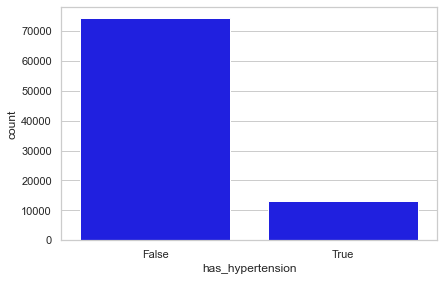

In [148]:
plt.figure()
sns.countplot(x='has_hypertension', data= scenario_1,color='blue');

Number of True and False for has_hypertension

In [149]:
scenario_1['has_hypertension'].fillna(False,inplace=True)


In [150]:
perc_nan(scenario_1)

,No_NaN,Percent


In [151]:
scenario_1.head(2)

,height,weight,gender,has_diabetes,has_hypertension,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi
0,162.000000,83.000000,M,True,False,60.0,0,0,0,0,0,0,1
1,125.095359,59.691452,M,False,False,39.0,0,0,0,0,0,0,1


## Columns distribution after cleaning

## Height 

<br><br>

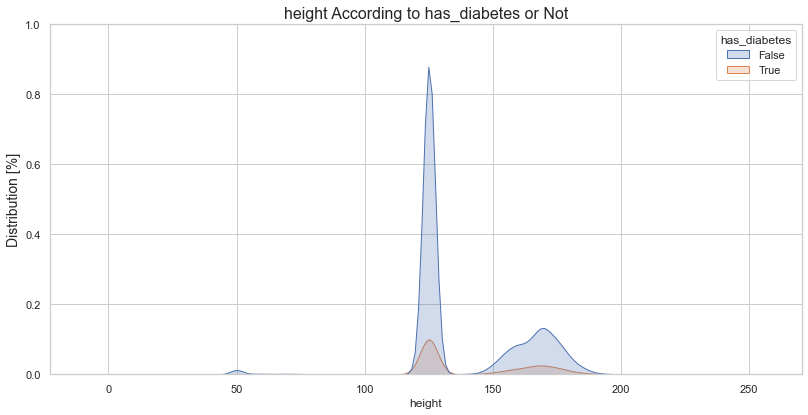

In [152]:
category_numeric_plots(scenario_1, 'height')

The graph here shows an intense strip of data at a height of 125 cm.

## Weight

<br><br>

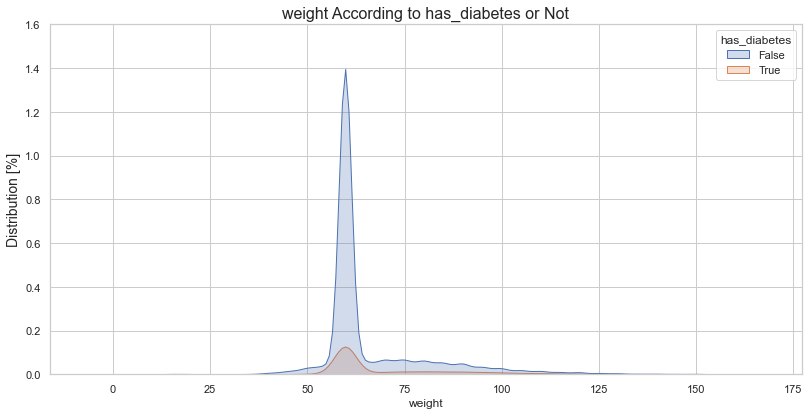

In [153]:
category_numeric_plots(scenario_1, 'weight')

And also the centralization of the data here lies in the weight of about 60 km

## Age and hypertension distribution of diabetic vs none-diabetic patients

<br><br>

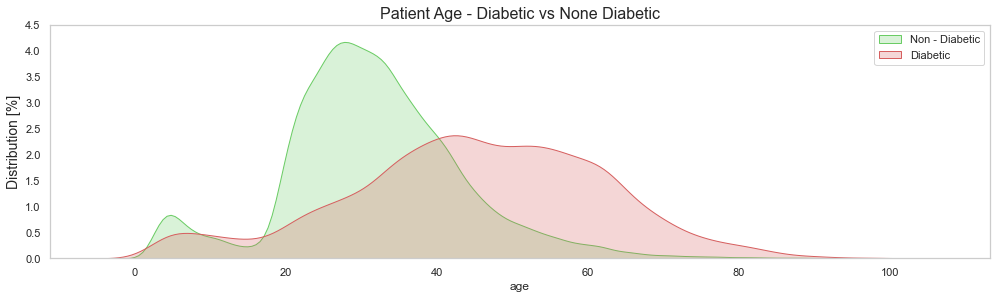

In [154]:
plt.figure(figsize=(15,4))
ax = sns.kdeplot(scenario_1.loc[(scenario_1['has_diabetes'] == False), 'age'], color='g', shade=True, label='Non - Diabetic')
ax = sns.kdeplot(scenario_1.loc[(scenario_1['has_diabetes'] == True), 'age'], color='r', shade=True, label='Diabetic')

plt.grid(b=None)
plt.legend()
plt.title('Patient Age - Diabetic vs None Diabetic', fontsize=16)
plt.yticks(ax.get_yticks(), [ round(num*100,2) for num in ax.get_yticks()])
plt.ylabel('Distribution [%]', fontsize=14);

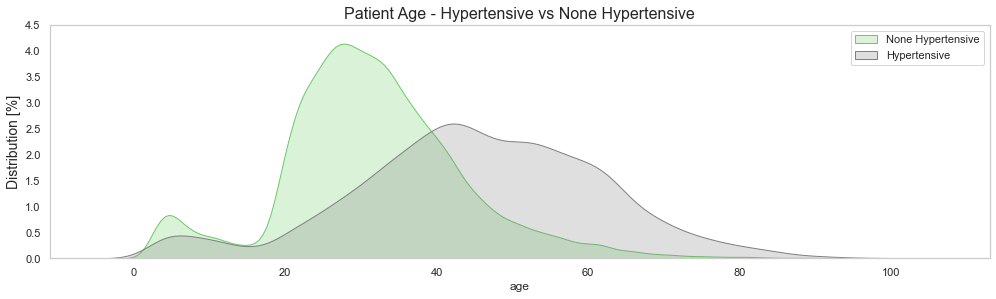

In [155]:
plt.figure(figsize=(15,4))
ax = sns.kdeplot(scenario_1.loc[(scenario_1['has_hypertension'] == False), 'age'], color='g', shade=True, label='None Hypertensive')
ax = sns.kdeplot(scenario_1.loc[(scenario_1['has_hypertension'] == True), 'age'], color='gray', shade=True, label='Hypertensive')

plt.grid(b=None)
plt.legend()
plt.title('Patient Age - Hypertensive vs None Hypertensive', fontsize=16)
plt.yticks(ax.get_yticks(), [ round(num*100,2) for num in ax.get_yticks()])
plt.ylabel('Distribution [%]', fontsize=14);

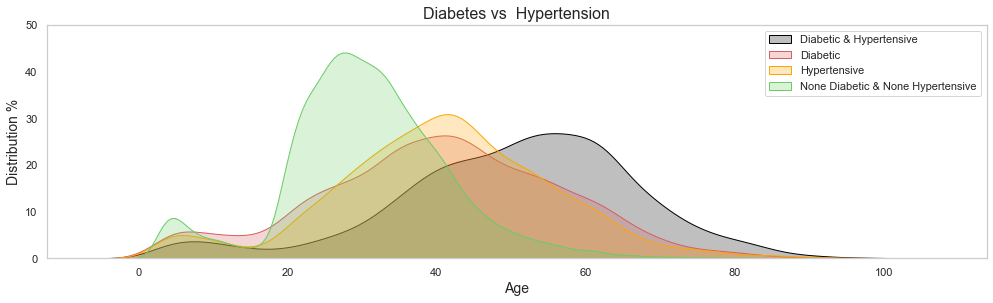

In [156]:
plt.figure(figsize=(15,4))

ax = sns.kdeplot(
    scenario_1.loc[(scenario_1['has_diabetes'] == True) & (scenario_1['has_hypertension'] == True), 'age'], 
    color='black', shade=True, label='Diabetic & Hypertensive')

ax = sns.kdeplot(
    scenario_1.loc[(scenario_1['has_diabetes'] == True) & (scenario_1['has_hypertension'] == False), 'age'],
    color='r', shade=True, label='Diabetic')

ax = sns.kdeplot(
    scenario_1.loc[(scenario_1['has_diabetes'] == False) & (scenario_1['has_hypertension'] == True), 'age'],
    color='orange', shade=True, label='Hypertensive')

ax = sns.kdeplot(
    scenario_1.loc[(scenario_1['has_diabetes'] == False) & (scenario_1['has_hypertension'] == False), 'age'],
    color='g', shade=True, label='None Diabetic & None Hypertensive')

plt.grid(b=None)
plt.legend() #labels=['Diabetic', 'Hypertensive', 'Diabetic & Hypertensive','None Diabetic & None Hypertensive'])

plt.title('Diabetes vs  Hypertension', fontsize=16)
plt.xlabel('Age', fontsize=14)
plt.yticks(ax.get_yticks(), [ round(num*1000) for num in ax.get_yticks()])
plt.ylabel('Distribution %', fontsize=14);

Age distribution did not differ much, but hypertension differed somewhat, so the distribution of people with hypertension became closer to a normal distribution or for people who did not suffer from it, so their distribution became skewed to the right.

In [157]:
fig = px.pie(scenario_1,names='has_hypertension',title='Hypertension percentage')
fig.show()

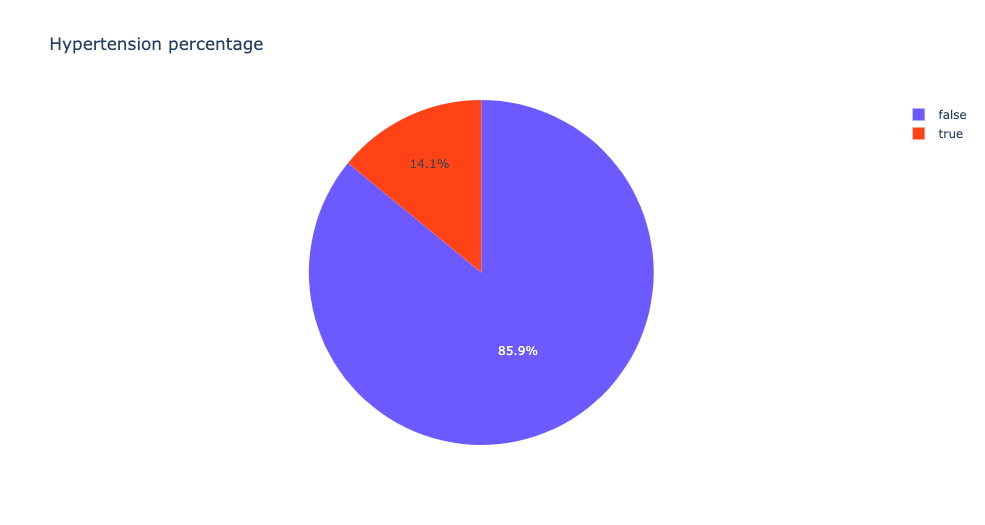

After filling in the missing values in `Hypertension` column by `False`, their percentage increased to reach `85.9%`.

<br><br><br>


---
<br><br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:2
        <br><br>


In this scenario we will fill the age with the mean and the weight and the height with the mean for eatch gender volumn , and the hypertension column with the most frequent value.

In [158]:
scenario_2 = new_local.copy()

### 1-Age and hypertension columns

In [159]:
scenario_2['age'].fillna(scenario_2['age'].mean(),inplace=True)
scenario_2['has_hypertension'].fillna('False',inplace=True)


### 2- Height and Weight

In [160]:
female = scenario_2[scenario_2['gender']=='F']
male = scenario_2[scenario_2['gender']=='M']

In [161]:
female_weight=female.weight.mean()
female_weight

53.081396146197626

In [162]:
male_weight=male.weight.mean()
male_weight

62.67091150743362

In [163]:
female_height=female.height.mean()
female_height


120.68397431471381

In [164]:
male_height=male.height.mean()
male_height

127.09887421995046

It is clear that the average weight of women differs from men, as is the case in their height, as:
- Average Height of Women: `120.6`
- Average Male Height: `127`
- Average Weight of Women: `53`
- Average Male Weight: `62.6`


Let's take into account that adjustments are made to height and weight in addition to losing half of the data, so this may not be the true average height and weight.

In [165]:
#to fill the nulls
scenario_2.loc[(scenario_2['gender']=='F'),'height'] =scenario_2.loc[(scenario_2['gender']=='F')  ,'height'].fillna(female_height)

scenario_2.loc[(scenario_2['gender']=='F') ,'weight'] =scenario_2.loc[(scenario_2['gender']=='F')  ,'weight'].fillna(female_weight)

scenario_2.loc[(scenario_2['gender']=='M'),'height'] =scenario_2.loc[(scenario_2['gender']=='M')  ,'height'].fillna(male_height)

scenario_2.loc[(scenario_2['gender']=='M') ,'weight'] =scenario_2.loc[(scenario_2['gender']=='M')  ,'weight'].fillna(male_weight)


In [166]:
#to fill the value =0 because we treat it as a null
scenario_2.loc[(scenario_2['weight'] == 0) & (scenario_2['gender'] == 'F'), 'weight'] = female_weight 
scenario_2.loc[(scenario_2['height'] == 0) & (scenario_2['gender'] == 'F'), 'height'] = female_height 
scenario_2.loc[(scenario_2['weight'] == 0) & (scenario_2['gender'] == 'M'), 'weight'] = male_weight 
scenario_2.loc[(scenario_2['height'] == 0) & (scenario_2['gender'] == 'M'), 'height'] = male_height 

In [167]:
scenario_2.isnull().sum()

height                   0
weight                   0
gender                   0
has_diabetes             0
has_hypertension         0
age                      0
Type 2                   0
Hypertension             0
Obesity                  0
Type 1                   0
Hyperglycaemia           0
hypercholesterolaemia    0
Saudi                    0
dtype: int64

## Columns distribution after cleaning

## Height and Weight columns

<br><br>

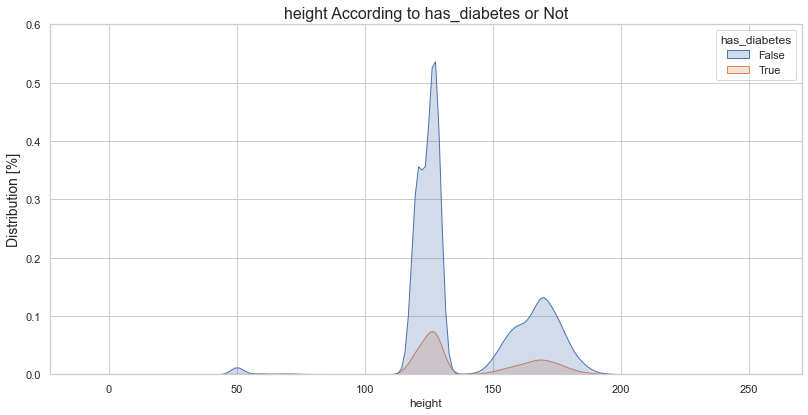

In [168]:
category_numeric_plots(scenario_2, 'height')

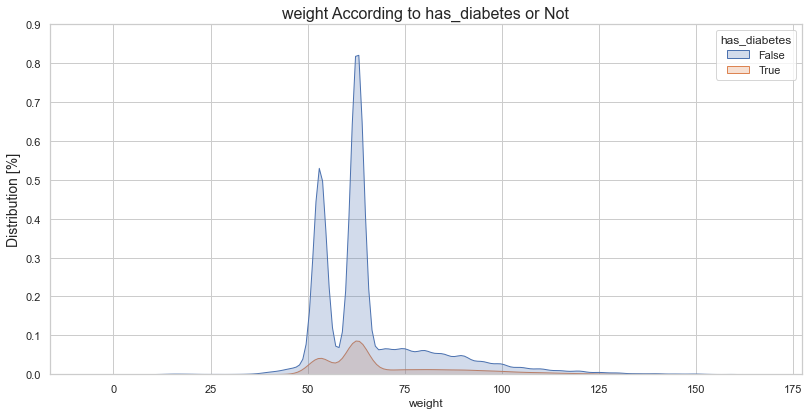

In [169]:
category_numeric_plots(scenario_2, 'weight')

- The data distribution differed in height and weight in this scenario from its predecessor, so we see that the data distribution has become wider, which means that it contains a wider spectrum.

- We will not plot the age and hypertention agian hear because it's as in `Scenario 1`.

<br><br><br>


---
<br><br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:3
        <br><br>


In this scenario we will drop the `height` and `weight` columns since half of the data are missing , and we will fill the hypertension column with the most frequent value. As for the `age` column we wil fill it with the mean.

In [170]:
scenario_3 = new_local.copy()

In [171]:
scenario_3['age'].fillna(scenario_3['age'].mean(),inplace=True)


In [172]:
scenario_3['has_hypertension'].fillna('False',inplace=True)


In [173]:
scenario_3.isnull().sum()

height                   47943
weight                   47379
gender                       0
has_diabetes                 0
has_hypertension             0
age                          0
Type 2                       0
Hypertension                 0
Obesity                      0
Type 1                       0
Hyperglycaemia               0
hypercholesterolaemia        0
Saudi                        0
dtype: int64

There is no need to replot the age and hypertention columns since it's the same as `Scenario 1`.

<br><br><br>


---
<br><br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:4
        <br><br>


In this scenario we will drop the `height` and `weight` columns since half of the data are missing , and we will drop the nulls in `hypertension` column . As for the `age` column we wil fill it with the mean.

In [174]:
scenario_4 = new_local.copy()

In [175]:
scenario_4['age'].fillna(scenario_4['age'].mean(),inplace=True)


In [176]:
scenario_4.dropna(subset=['has_hypertension'], how='all', inplace=True)


In [177]:
fig = px.pie(scenario_4,names='has_hypertension',title='Hypertension percentage')
fig.show()

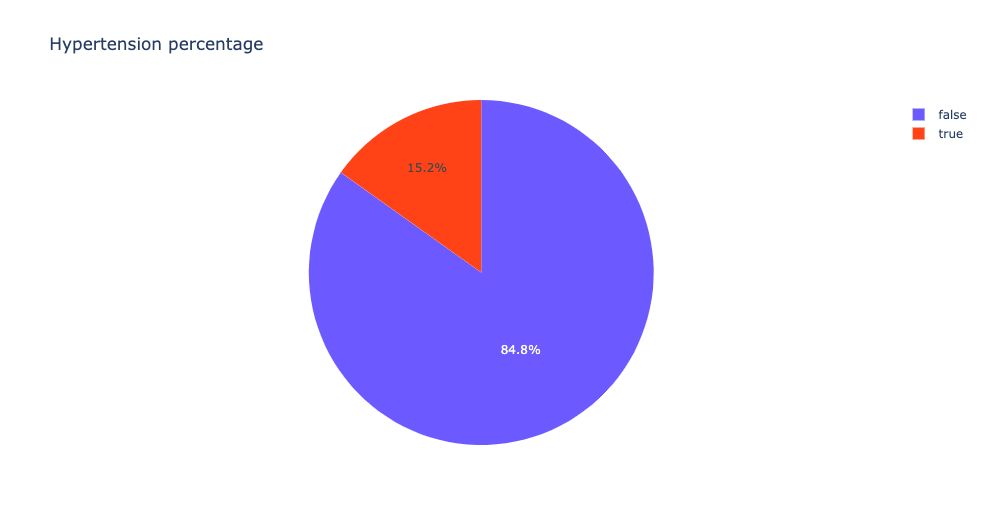

The percentage of people with hypertension and healthy people did not change much, as the difference was not even `1.1%`.

In [178]:
scenario_4.isnull().sum()

height                   43683
weight                   43203
gender                       0
has_diabetes                 0
has_hypertension             0
age                          0
Type 2                       0
Hypertension                 0
Obesity                      0
Type 1                       0
Hyperglycaemia               0
hypercholesterolaemia        0
Saudi                        0
dtype: int64

<br><br><br>


---
<br><br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:5
        <br><br>


In this scenario we will fixe the height and weight columns, and we will fill the null in scenario `5.1` and drop the nulls in scenario `5.2` for the hypertension column . As for the age column we wil fill it with the mode.

We used this site as our reference to refill the missing values in height and weight

- Average Height to Weight Chart: Babies to Teenagers (https://www.disabled-world.com/calculators-charts/height-weight-teens.php)


- computing female & male weight and height with mean/median
    - condition1: male/female aged 0-20, fill with reference range (Average Height to Weight Chart: Babies to Teenagers)
    - condition2: male/femlae aged > 20, fill weight with median and height with mean for each gender height and weight
    
    
Note: 
- condition1 contained non logical values. Therefore refilled values with reference range above.
- condition2 contained null values. Therefore filled with mean/median of non null values. 



In [179]:
scenario_5 = new_local.copy()

In [180]:
scenario_5['age'].fillna(scenario_5['age'].value_counts().keys()[0],inplace=True)

In [181]:
femal_w_h={
    '0-1': [[3.3, 4.3, 5.3, 6.0, 6.6, 7.1, 7.5, 7.9, 8.2, 8.5, 8.8, 9.0], [49.2, 53.8, 56.1, 59.9, 62.2, 64.2, 64.1, 67.3, 68.8, 70.1, 71.6, 72.8]],
    '1-2': [[9.2, 9.5, 9.7, 9.9, 10.2, 10.4, 10.6, 10.8, 11.0, 11.3, 11.5, 11.7],[74.1, 75.1, 76.4, 77.7, 78.4, 79.7, 80.7, 81.7, 82.8, 83.5, 84.8, 85.1]],
    '2-12': [[12.0, 14.2, 15.4, 17.9, 19.9, 22,4, 25.8, 28.1, 31.1, 36.9, 41.5], [85.5, 94.0, 100.3, 107.9, 115.5, 121.1, 128.2, 133.3, 138.4, 144.0, 149.8]],
    '13-20':[[45.8, 47.6, 52.1, 53.3, 54.4, 56.7, 57.1, 58.0], [156.7, 158.7, 159.7, 162.5, 162.5, 163.0, 163.0, 163.3]],
              }

male_w_h={
    '0-1': [[3.3, 4.4, 5.6, 6.4, 7.0, 7.5, 7.8, 8.3, 8.6, 8.9, 9.1, 9.4],[49.8, 54.8, 58.4, 61.4, 64.0, 66.0, 67.5, 69.0, 70.6, 71.8, 73.1, 74.4]],
    '1-2': [[9.6, 9.9, 10.1, 10.3, 10.5, 10.7, 10.9, 11.2, 11.3, 11.5, 11.7, 11.9],[75.7, 76.9, 77.9, 79.2, 80.2, 81.2, 82.2, 83.3, 84.0, 85.0, 86.1, 86.8]],
    '2-12': [[12.5, 14.0, 16.3, 18.4, 20.6, 22.9, 25.6, 28.6, 32.0, 35.6, 39.9], [86.8, 95.2, 102.3, 109.2, 115.5, 121.9, 128.0, 133.3, 138.4, 143.5, 149.1]],
    '13-20': [[45.3, 50.8, 56.0, 60.8, 64.4, 66.9, 68.9, 70.3], [156.2, 163.8, 170.1, 173.4, 175.2, 175.7, 176.5, 177.0]], 
}

In [182]:
female_w_h_avg = calculate_mean_weight_height(femal_w_h)
male_w_h_avg = calculate_mean_weight_height(male_w_h)

In [183]:
print(f'Femal weight / height average: \n {female_w_h_avg}', f'Male weight / height average: \n {male_w_h_avg}', sep='\n')

Femal weight / height average: 
 {'0-1': (6.9, 63.3), '1-2': (10.5, 80.0), '2-12': (22.4, 119.8), '13-20': (53.1, 161.2)}
Male weight / height average: 
 {'0-1': (7.2, 65.1), '1-2': (10.8, 81.5), '2-12': (24.2, 120.3), '13-20': (60.4, 171.0)}


In [184]:
female_adult_height_mean = round(scenario_5[
                                    (scenario_5['gender'] == 'F') & (scenario_5['age'] > 21) & (scenario_5['height'] > 100) & 
                                    (scenario_5['height'] <= 250)]['height'].mean(), 1)

male_adult_height_mean = round(scenario_5[
                                    (scenario_5['gender'] == 'M') & (scenario_5['age'] > 21) & (scenario_5['height'] > 100) & 
                                    (scenario_5['height'] <= 250)]['height'].mean(), 1)

# obtaining median weight for male and female (age > 21)
female_adult_weight_median = scenario_5[(scenario_5['gender'] == 'F') & (scenario_5['age'] > 21)]['weight'].median() 
male_adult_weight_median = scenario_5[(scenario_5['gender'] == 'M') & (scenario_5['age'] > 21)]['weight'].median()

In [185]:
# filling null values with 'aa'
scenario_5['height'].fillna('aa', inplace=True)
scenario_5['weight'].fillna('aa', inplace=True)

## Filling Height & Weight in case Gender `Male`


### Age >=21

In [186]:
# Height
for i in scenario_5[(scenario_5['age'] >= 21) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = male_adult_height_mean
        
    elif (scenario_5.loc[i,'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = male_adult_height_mean

In [187]:
# Weight
for i in scenario_5[(scenario_5['age'] >= 21) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = male_adult_weight_median
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = male_adult_weight_median

### 12 < Age < 21

In [188]:
# Height
for i in scenario_5[((scenario_5['age'] < 21) & (scenario_5['age'] >12)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
            scenario_5.loc[i, 'height'] = male_w_h_avg['13-20'][1]
            
    elif (scenario_5.loc[i, 'height'] ==  'aa'):
        scenario_5.loc[i, 'height'] = male_w_h_avg['13-20'][1]

In [189]:
# Weight
for i in scenario_5[((scenario_5['age'] < 21) & (scenario_5['age'] >12)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['13-20'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['13-20'][0]

### 2 < Age <= 12

In [190]:
# Height
for i in scenario_5[((scenario_5['age'] >= 2) & (scenario_5['age'] <=12)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = male_w_h_avg['2-12'][1]
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = male_w_h_avg['2-12'][1]

In [191]:
# Weight
for i in scenario_5[((scenario_5['age'] >= 2) & (scenario_5['age'] <=12)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['2-12'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['2-12'][0]

### 1 <= Age < 2

In [192]:
# Height
for i in scenario_5[((scenario_5['age'] >= 1) & (scenario_5['age'] < 2)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = male_w_h_avg['1-2'][1]
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = male_w_h_avg['1-2'][1]

In [193]:
# Weight
for i in scenario_5[((scenario_5['age'] >= 1) & (scenario_5['age'] < 2)) & (scenario_5['gender'] == 'M')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['1-2'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = male_w_h_avg['1-2'][0]

## Filling Height & Weight in case Gender `Female`

### Age >= 21

In [194]:
# Height
for i in scenario_5[(scenario_5['age'] >= 21) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = female_adult_height_mean
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = female_adult_height_mean

In [195]:
# Weight
for i in scenario_5[(scenario_5['age'] >= 21) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = female_adult_weight_median
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = female_adult_weight_median

### 12 < Age < 21

In [196]:
# Height
for i in scenario_5[((scenario_5['age'] < 21) & (scenario_5['age'] >12)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = female_w_h_avg['13-20'][1]
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = female_w_h_avg['13-20'][1]

In [197]:
# Weight
for i in scenario_5[((scenario_5['age'] < 21) & (scenario_5['age'] >12)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['13-20'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['13-20'][0]

### 2 <= Age <= 12

In [198]:
# Height
for i in scenario_5[((scenario_5['age'] >= 2) & (scenario_5['age'] <=12)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = female_w_h_avg['2-12'][1]
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = female_w_h_avg['2-12'][1]

In [199]:
# Weight
for i in scenario_5[((scenario_5['age'] >= 2) & (scenario_5['age'] <=12)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['2-12'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['2-12'][0]

### 1 <= Age < 2

In [200]:
# Height
for i in scenario_5[((scenario_5['age'] >= 1) & (scenario_5['age'] < 2)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'height'] == 0.0):
        scenario_5.loc[i, 'height'] = female_w_h_avg['1-2'][1]
        
    elif (scenario_5.loc[i, 'height'] == 'aa'):
        scenario_5.loc[i, 'height'] = female_w_h_avg['1-2'][1]

In [201]:
# Weight
for i in scenario_5[((scenario_5['age'] >= 1) & (scenario_5['age'] < 2)) & (scenario_5['gender'] == 'F')].index:
    
    if (scenario_5.loc[i, 'weight'] == 0.0):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['1-2'][0]
        
    elif (scenario_5.loc[i, 'weight'] == 'aa'):
        scenario_5.loc[i, 'weight'] = female_w_h_avg['1-2'][0]

In [202]:
#to be sure if we fill all the null
scenario_5[scenario_5['height'] == 'aa']

,height,weight,gender,has_diabetes,has_hypertension,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi


In [203]:
scenario_5.isna().sum()

height                      0
weight                      0
gender                      0
has_diabetes                0
has_hypertension         6770
age                         0
Type 2                      0
Hypertension                0
Obesity                     0
Type 1                      0
Hyperglycaemia              0
hypercholesterolaemia       0
Saudi                       0
dtype: int64

In [204]:
scenario_5['height'] = scenario_5['height'].astype(float)
scenario_5['weight'] = scenario_5['weight'].astype(float)

`BMI` is the weight per square meter and through this column we can dispense with the height and weight columns

In [205]:
# Computing BMI (weight / height ^ 2)
scenario_5['BMI'] = scenario_5['weight'] / ((scenario_5['height']/100)**2)

In [206]:
scenario_5['BMI'] = scenario_5['BMI'].round(1)

## Columns distribution after cleaning

## Height and Weight columns

<br><br>

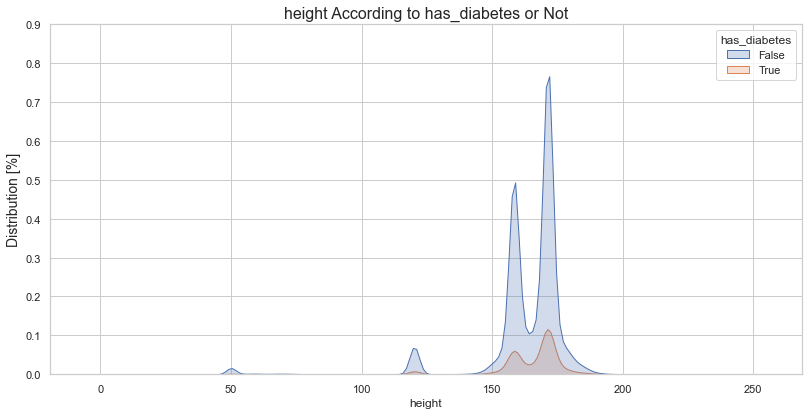

In [207]:
category_numeric_plots(scenario_5, 'height')

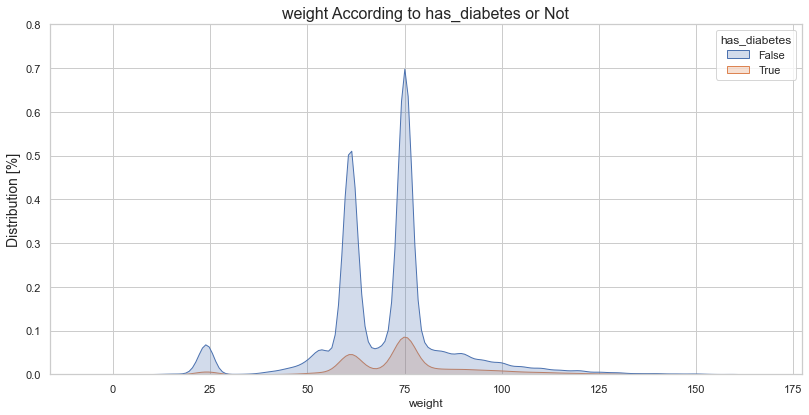

In [208]:
category_numeric_plots(scenario_5, 'weight')

The distribution of height and weight greatly improved in this scenario, and it covered the spectrum more than its predecessors

<br><br><br>


---
<br><br><br>

<br><br>
    <font color='6DB8F4' size='10px'> Scenario:5.1
        <br><br>


In [209]:
scenario_5_1 = scenario_5.copy()

In [210]:
scenario_5_1['has_hypertension'].fillna('False',inplace=True)


In [211]:
scenario_5_1.isna().sum()

height                   0
weight                   0
gender                   0
has_diabetes             0
has_hypertension         0
age                      0
Type 2                   0
Hypertension             0
Obesity                  0
Type 1                   0
Hyperglycaemia           0
hypercholesterolaemia    0
Saudi                    0
BMI                      0
dtype: int64

<br><br>
    <font color='6DB8F4' size='10px'> Scenario:5.2
        <br><br>


In [212]:
scenario_5_2 = scenario_5.copy()

In [213]:
scenario_5_2.dropna(subset=['has_hypertension'], how='all', inplace=True)

In [214]:
scenario_5_2.isna().sum()

height                   0
weight                   0
gender                   0
has_diabetes             0
has_hypertension         0
age                      0
Type 2                   0
Hypertension             0
Obesity                  0
Type 1                   0
Hyperglycaemia           0
hypercholesterolaemia    0
Saudi                    0
BMI                      0
dtype: int64

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_6'>


<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 6: preprocessing data for the model
        <br><br>

<br><br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:1
        <br><br>


In [215]:
scenario_1['female'] = scenario_1.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_1['diabetetic'] = scenario_1['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_1['has-hypertension'] = scenario_1['has_hypertension'].map(lambda x: 1 if x == True else 0)

In [216]:
scenario_1.drop(['gender', 'has_diabetes', 'has_hypertension'],axis=1,inplace=True)

In [217]:
scenario_1.head(2)

,height,weight,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,female,diabetetic,has-hypertension
0,162.000000,83.000000,60.0,0,0,0,0,0,0,1,0,1,0
1,125.095359,59.691452,39.0,0,0,0,0,0,0,1,0,0,0


In [218]:
scenario_1.to_csv('D:\capiston\cleaning\scenario_1.csv')

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:2
        <br><br>


In [219]:
scenario_2['female'] = scenario_2.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_2['diabetetic'] = scenario_2['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_2['has-hypertension'] = scenario_2['has_hypertension'].map(lambda x: 1 if x == True else 0)


In [220]:
scenario_2.drop(['gender', 'has_diabetes', 'has_hypertension'],axis=1,inplace=True)

In [221]:
scenario_2.head(2)

,height,weight,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,female,diabetetic,has-hypertension
0,162.000000,83.000000,60.0,0,0,0,0,0,0,1,0,1,0
1,127.098874,62.670912,39.0,0,0,0,0,0,0,1,0,0,0


In [222]:
scenario_2.to_csv('D:\capiston\cleaning\scenario_2.csv')

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:3
        <br><br>


In [223]:
scenario_3['female'] = scenario_3.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_3['diabetetic'] = scenario_3['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_3['has-hypertension'] = scenario_3['has_hypertension'].map(lambda x: 1 if x == True else 0)

In [224]:
scenario_3.drop(['gender', 'has_diabetes', 'has_hypertension','height','weight'],axis=1,inplace=True)

In [225]:
scenario_3.head(2)

,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,female,diabetetic,has-hypertension
0,60.0,0,0,0,0,0,0,1,0,1,0
1,39.0,0,0,0,0,0,0,1,0,0,0


In [226]:
scenario_3.to_csv('D:\capiston\cleaning\scenario_3.csv')

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:4
        <br><br>


In [227]:
scenario_4['female'] = scenario_4.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_4['diabetetic'] = scenario_4['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_4['has-hypertension'] = scenario_4['has_hypertension'].map(lambda x: 1 if x == True else 0)

In [228]:
scenario_4.drop(['gender', 'has_diabetes', 'has_hypertension','height','weight'],axis=1,inplace=True)

In [229]:
scenario_4.head(2)

,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,female,diabetetic,has-hypertension
0,60.0,0,0,0,0,0,0,1,0,1,0
1,39.0,0,0,0,0,0,0,1,0,0,0


In [230]:
scenario_4.to_csv('D:\capiston\cleaning\scenario_4.csv')

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:5.1
        <br><br>


In [231]:
scenario_5_1['female'] = scenario_5_1.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_5_1['diabetetic'] = scenario_5_1['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_5_1['has-hypertension'] = scenario_5_1['has_hypertension'].map(lambda x: 1 if x == True else 0)

In [232]:
scenario_5_1.drop(['gender', 'has_diabetes', 'has_hypertension','height','weight'],axis=1,inplace=True)

In [233]:
scenario_5_1.head(2)

,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,BMI,female,diabetetic,has-hypertension
0,60.0,0,0,0,0,0,0,1,31.6,0,1,0
1,39.0,0,0,0,0,0,0,1,25.5,0,0,0


In [234]:
scenario_5_1.to_csv('D:\capiston\cleaning\scenario_5_1.csv')

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:5.2
        <br><br>


In [235]:
scenario_5_2['female'] = scenario_5_2.gender.map(lambda x: 1 if x == 'F' else 0)
scenario_5_2['diabetetic'] = scenario_5_2['has_diabetes'].map(lambda x: 1 if x == True else 0)
scenario_5_2['has-hypertension'] = scenario_5_2['has_hypertension'].map(lambda x: 1 if x == True else 0)

In [236]:
scenario_5_2.drop(['gender', 'has_diabetes', 'has_hypertension','height','weight'],axis=1,inplace=True)

In [237]:
scenario_5_2.head(2)

,age,Type 2,Hypertension,Obesity,Type 1,Hyperglycaemia,hypercholesterolaemia,Saudi,BMI,female,diabetetic,has-hypertension
0,60.0,0,0,0,0,0,0,1,31.6,0,1,0
1,39.0,0,0,0,0,0,0,1,25.5,0,0,0


In [238]:
scenario_5_2.to_csv('D:\capiston\cleaning\scenario_5_2.csv')

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>
<a id='Part_7'>



        
  <br><br>
<center> 
    <font color='2B059F' size='50px'> Part 7: Modeling
        <br><br>

<br><br><br>

## Basiline score

In [239]:
scenario_1[scenario_1['diabetetic'] == 0].shape[0]/scenario_1.shape[0]

0.8510947357260245

- As it was explained previously, and here also, our target is not balanced, as our data is biased by `85%` to zero more than to one, so we will first work to make it balanced, and to achieve this goal, we have taken several different methods like `under sampling`, `over sampling with SMOTE` or `Rebalance Target Class (Randomly Chosen)` to compare them later.

- Model score sometimes gives us a high  but the impacts of imbalanced data are implicit, i.e. it does not raise an immediate error we you build and run our model, but the results can be delusive. If the degree of class imbalance for the majority class is extreme, then a machine trained classifier may yield high overall prediction accuracy since the model is most likely to predict most samples belonging to the majority class.


- Insted of using the model.score, we will use the `ROC AUC` score, `confusion matrix` and `Classification Report` to evaluate our models.

---

In [240]:
models = {
  
    'Logistic Regression': LogisticRegression(), 
    'Gradient Boosting Classifier': GradientBoostingClassifier(),
    'Bagging Classifier ': BaggingClassifier(),
    'Cat Boost Classifier': CatBoostClassifier()

}


<br><br>
    <font color='6DB8F4' size='20px'> Scenario:1
        <br><br>


<br><br>

<font color='506AF1' size='10px'> 1)Random Undersampling

<br><br>

In [241]:
scenario_1_under_over = scenario_1.copy()

### Split
y=scenario_1_under_over.pop('diabetetic')
X=scenario_1_under_over
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=2, stratify=y)

#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)



In [242]:
# summarize class distribution
print("Before undersampling: ", Counter(y_train))

# define undersampling strategy
undersample = RandomUnderSampler(sampling_strategy='majority')

# fit and apply the transform
Xs_train_under, y_train_under = undersample.fit_resample(Xs_train, y_train)

# summarize class distribution
print("After undersampling: ", Counter(y_train_under))


Before undersampling:  Counter({0: 56189, 1: 9831})
After undersampling:  Counter({0: 9831, 1: 9831})


In [243]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train_under, Xs_test, y_train_under, y_test)
    print(f'F1-Score { model}: {f1_sc}')

F1-Score Logistic Regression: 0.5283268703300861
F1-Score Gradient Boosting Classifier: 0.5209868082919308
F1-Score Bagging Classifier : 0.4796372629843364
Learning rate set to 0.036755
0:	learn: 0.6785961	total: 338ms	remaining: 5m 37s
1:	learn: 0.6650721	total: 347ms	remaining: 2m 53s
2:	learn: 0.6523825	total: 356ms	remaining: 1m 58s
3:	learn: 0.6413020	total: 365ms	remaining: 1m 30s
4:	learn: 0.6306905	total: 374ms	remaining: 1m 14s
5:	learn: 0.6222512	total: 382ms	remaining: 1m 3s
6:	learn: 0.6134287	total: 391ms	remaining: 55.5s
7:	learn: 0.6054611	total: 400ms	remaining: 49.6s
8:	learn: 0.5979355	total: 409ms	remaining: 45s
9:	learn: 0.5911218	total: 418ms	remaining: 41.4s
10:	learn: 0.5857223	total: 427ms	remaining: 38.4s
11:	learn: 0.5796227	total: 436ms	remaining: 35.9s
12:	learn: 0.5737730	total: 445ms	remaining: 33.8s
13:	learn: 0.5693206	total: 452ms	remaining: 31.8s
14:	learn: 0.5643905	total: 460ms	remaining: 30.2s
15:	learn: 0.5602960	total: 467ms	remaining: 28.7s
16:	l

168:	learn: 0.4906928	total: 1.81s	remaining: 8.9s
169:	learn: 0.4906568	total: 1.82s	remaining: 8.88s
170:	learn: 0.4905809	total: 1.82s	remaining: 8.85s
171:	learn: 0.4905539	total: 1.83s	remaining: 8.83s
172:	learn: 0.4905193	total: 1.84s	remaining: 8.82s
173:	learn: 0.4904872	total: 1.85s	remaining: 8.8s
174:	learn: 0.4904396	total: 1.86s	remaining: 8.78s
175:	learn: 0.4903750	total: 1.87s	remaining: 8.75s
176:	learn: 0.4903373	total: 1.88s	remaining: 8.74s
177:	learn: 0.4902916	total: 1.89s	remaining: 8.72s
178:	learn: 0.4902508	total: 1.9s	remaining: 8.7s
179:	learn: 0.4902160	total: 1.9s	remaining: 8.68s
180:	learn: 0.4901854	total: 1.91s	remaining: 8.66s
181:	learn: 0.4901330	total: 1.92s	remaining: 8.63s
182:	learn: 0.4900886	total: 1.93s	remaining: 8.62s
183:	learn: 0.4900557	total: 1.94s	remaining: 8.59s
184:	learn: 0.4900187	total: 1.95s	remaining: 8.57s
185:	learn: 0.4899823	total: 1.95s	remaining: 8.55s
186:	learn: 0.4899240	total: 1.96s	remaining: 8.54s
187:	learn: 0.489

330:	learn: 0.4844762	total: 3.23s	remaining: 6.54s
331:	learn: 0.4844467	total: 3.24s	remaining: 6.53s
332:	learn: 0.4843997	total: 3.25s	remaining: 6.51s
333:	learn: 0.4843524	total: 3.26s	remaining: 6.5s
334:	learn: 0.4843439	total: 3.27s	remaining: 6.49s
335:	learn: 0.4842979	total: 3.28s	remaining: 6.48s
336:	learn: 0.4842593	total: 3.29s	remaining: 6.46s
337:	learn: 0.4842292	total: 3.29s	remaining: 6.45s
338:	learn: 0.4842053	total: 3.3s	remaining: 6.44s
339:	learn: 0.4841247	total: 3.31s	remaining: 6.43s
340:	learn: 0.4840751	total: 3.32s	remaining: 6.42s
341:	learn: 0.4840081	total: 3.33s	remaining: 6.4s
342:	learn: 0.4839671	total: 3.34s	remaining: 6.39s
343:	learn: 0.4839023	total: 3.34s	remaining: 6.38s
344:	learn: 0.4838352	total: 3.35s	remaining: 6.37s
345:	learn: 0.4837856	total: 3.36s	remaining: 6.35s
346:	learn: 0.4837526	total: 3.37s	remaining: 6.34s
347:	learn: 0.4837125	total: 3.38s	remaining: 6.33s
348:	learn: 0.4836778	total: 3.39s	remaining: 6.32s
349:	learn: 0.4

494:	learn: 0.4782057	total: 4.68s	remaining: 4.78s
495:	learn: 0.4781633	total: 4.69s	remaining: 4.77s
496:	learn: 0.4781617	total: 4.7s	remaining: 4.75s
497:	learn: 0.4781469	total: 4.71s	remaining: 4.74s
498:	learn: 0.4780958	total: 4.71s	remaining: 4.73s
499:	learn: 0.4780441	total: 4.72s	remaining: 4.72s
500:	learn: 0.4780200	total: 4.73s	remaining: 4.71s
501:	learn: 0.4779959	total: 4.74s	remaining: 4.7s
502:	learn: 0.4779551	total: 4.75s	remaining: 4.69s
503:	learn: 0.4779122	total: 4.75s	remaining: 4.68s
504:	learn: 0.4778787	total: 4.76s	remaining: 4.67s
505:	learn: 0.4778717	total: 4.77s	remaining: 4.66s
506:	learn: 0.4778297	total: 4.78s	remaining: 4.64s
507:	learn: 0.4777925	total: 4.78s	remaining: 4.63s
508:	learn: 0.4777437	total: 4.79s	remaining: 4.62s
509:	learn: 0.4777077	total: 4.8s	remaining: 4.61s
510:	learn: 0.4776734	total: 4.81s	remaining: 4.6s
511:	learn: 0.4776421	total: 4.82s	remaining: 4.59s
512:	learn: 0.4776215	total: 4.82s	remaining: 4.58s
513:	learn: 0.47

662:	learn: 0.4731875	total: 6.13s	remaining: 3.11s
663:	learn: 0.4731731	total: 6.13s	remaining: 3.1s
664:	learn: 0.4731517	total: 6.14s	remaining: 3.09s
665:	learn: 0.4731138	total: 6.15s	remaining: 3.08s
666:	learn: 0.4731055	total: 6.16s	remaining: 3.08s
667:	learn: 0.4730827	total: 6.17s	remaining: 3.07s
668:	learn: 0.4730286	total: 6.18s	remaining: 3.06s
669:	learn: 0.4729907	total: 6.19s	remaining: 3.05s
670:	learn: 0.4729570	total: 6.19s	remaining: 3.04s
671:	learn: 0.4729332	total: 6.2s	remaining: 3.03s
672:	learn: 0.4729100	total: 6.21s	remaining: 3.02s
673:	learn: 0.4728996	total: 6.22s	remaining: 3.01s
674:	learn: 0.4728778	total: 6.23s	remaining: 3s
675:	learn: 0.4728567	total: 6.24s	remaining: 2.99s
676:	learn: 0.4728189	total: 6.24s	remaining: 2.98s
677:	learn: 0.4727865	total: 6.25s	remaining: 2.97s
678:	learn: 0.4727648	total: 6.26s	remaining: 2.96s
679:	learn: 0.4727267	total: 6.27s	remaining: 2.95s
680:	learn: 0.4726907	total: 6.28s	remaining: 2.94s
681:	learn: 0.472

831:	learn: 0.4683702	total: 7.57s	remaining: 1.53s
832:	learn: 0.4683576	total: 7.58s	remaining: 1.52s
833:	learn: 0.4683386	total: 7.59s	remaining: 1.51s
834:	learn: 0.4683269	total: 7.59s	remaining: 1.5s
835:	learn: 0.4683115	total: 7.6s	remaining: 1.49s
836:	learn: 0.4682944	total: 7.61s	remaining: 1.48s
837:	learn: 0.4682767	total: 7.62s	remaining: 1.47s
838:	learn: 0.4682461	total: 7.63s	remaining: 1.46s
839:	learn: 0.4682088	total: 7.64s	remaining: 1.45s
840:	learn: 0.4681698	total: 7.65s	remaining: 1.45s
841:	learn: 0.4681389	total: 7.65s	remaining: 1.44s
842:	learn: 0.4681106	total: 7.66s	remaining: 1.43s
843:	learn: 0.4680754	total: 7.67s	remaining: 1.42s
844:	learn: 0.4680614	total: 7.68s	remaining: 1.41s
845:	learn: 0.4680572	total: 7.69s	remaining: 1.4s
846:	learn: 0.4680267	total: 7.7s	remaining: 1.39s
847:	learn: 0.4679958	total: 7.7s	remaining: 1.38s
848:	learn: 0.4679723	total: 7.71s	remaining: 1.37s
849:	learn: 0.4679644	total: 7.72s	remaining: 1.36s
850:	learn: 0.467

998:	learn: 0.4641641	total: 9.02s	remaining: 9.03ms
999:	learn: 0.4641636	total: 9.03s	remaining: 0us
F1-Score Cat Boost Classifier: 0.5117867555185339


Learning rate set to 0.036755
0:	learn: 0.6785961	total: 8.99ms	remaining: 8.98s
1:	learn: 0.6650721	total: 18.1ms	remaining: 9.02s
2:	learn: 0.6523825	total: 27.1ms	remaining: 8.99s
3:	learn: 0.6413020	total: 35.8ms	remaining: 8.93s
4:	learn: 0.6306905	total: 44.8ms	remaining: 8.91s
5:	learn: 0.6222512	total: 53.6ms	remaining: 8.88s
6:	learn: 0.6134287	total: 63.2ms	remaining: 8.97s
7:	learn: 0.6054611	total: 71.2ms	remaining: 8.83s
8:	learn: 0.5979355	total: 79.4ms	remaining: 8.75s
9:	learn: 0.5911218	total: 87.5ms	remaining: 8.66s
10:	learn: 0.5857223	total: 95.9ms	remaining: 8.63s
11:	learn: 0.5796227	total: 104ms	remaining: 8.57s
12:	learn: 0.5737730	total: 112ms	remaining: 8.54s
13:	learn: 0.5693206	total: 119ms	remaining: 8.4s
14:	learn: 0.5643905	total: 128ms	remaining: 8.41s
15:	learn: 0.5602960	total: 136ms	remaining: 8.38s
16:	learn: 0.5567202	total: 145ms	remaining: 8.37s
17:	learn: 0.5534801	total: 151ms	remaining: 8.25s
18:	learn: 0.5503502	total: 160ms	remaining: 8.24s
1

165:	learn: 0.4908611	total: 1.45s	remaining: 7.29s
166:	learn: 0.4908235	total: 1.46s	remaining: 7.28s
167:	learn: 0.4907646	total: 1.47s	remaining: 7.27s
168:	learn: 0.4906928	total: 1.48s	remaining: 7.25s
169:	learn: 0.4906568	total: 1.49s	remaining: 7.25s
170:	learn: 0.4905809	total: 1.49s	remaining: 7.24s
171:	learn: 0.4905539	total: 1.5s	remaining: 7.23s
172:	learn: 0.4905193	total: 1.51s	remaining: 7.21s
173:	learn: 0.4904872	total: 1.52s	remaining: 7.21s
174:	learn: 0.4904396	total: 1.53s	remaining: 7.2s
175:	learn: 0.4903750	total: 1.53s	remaining: 7.18s
176:	learn: 0.4903373	total: 1.54s	remaining: 7.17s
177:	learn: 0.4902916	total: 1.55s	remaining: 7.17s
178:	learn: 0.4902508	total: 1.56s	remaining: 7.16s
179:	learn: 0.4902160	total: 1.57s	remaining: 7.14s
180:	learn: 0.4901854	total: 1.57s	remaining: 7.13s
181:	learn: 0.4901330	total: 1.58s	remaining: 7.12s
182:	learn: 0.4900886	total: 1.59s	remaining: 7.11s
183:	learn: 0.4900557	total: 1.6s	remaining: 7.1s
184:	learn: 0.49

336:	learn: 0.4842593	total: 2.88s	remaining: 5.67s
337:	learn: 0.4842292	total: 2.89s	remaining: 5.66s
338:	learn: 0.4842053	total: 2.9s	remaining: 5.65s
339:	learn: 0.4841247	total: 2.91s	remaining: 5.64s
340:	learn: 0.4840751	total: 2.92s	remaining: 5.63s
341:	learn: 0.4840081	total: 2.92s	remaining: 5.62s
342:	learn: 0.4839671	total: 2.93s	remaining: 5.62s
343:	learn: 0.4839023	total: 2.94s	remaining: 5.61s
344:	learn: 0.4838352	total: 2.95s	remaining: 5.6s
345:	learn: 0.4837856	total: 2.96s	remaining: 5.59s
346:	learn: 0.4837526	total: 2.96s	remaining: 5.58s
347:	learn: 0.4837125	total: 2.97s	remaining: 5.57s
348:	learn: 0.4836778	total: 2.98s	remaining: 5.56s
349:	learn: 0.4836356	total: 2.99s	remaining: 5.55s
350:	learn: 0.4835562	total: 3s	remaining: 5.54s
351:	learn: 0.4835134	total: 3.01s	remaining: 5.54s
352:	learn: 0.4834747	total: 3.02s	remaining: 5.53s
353:	learn: 0.4834212	total: 3.02s	remaining: 5.52s
354:	learn: 0.4833980	total: 3.03s	remaining: 5.51s
355:	learn: 0.483

510:	learn: 0.4776734	total: 4.32s	remaining: 4.13s
511:	learn: 0.4776421	total: 4.33s	remaining: 4.13s
512:	learn: 0.4776215	total: 4.35s	remaining: 4.13s
513:	learn: 0.4775778	total: 4.36s	remaining: 4.12s
514:	learn: 0.4775604	total: 4.37s	remaining: 4.11s
515:	learn: 0.4775221	total: 4.37s	remaining: 4.1s
516:	learn: 0.4774975	total: 4.38s	remaining: 4.09s
517:	learn: 0.4774812	total: 4.39s	remaining: 4.08s
518:	learn: 0.4774386	total: 4.4s	remaining: 4.08s
519:	learn: 0.4774372	total: 4.41s	remaining: 4.07s
520:	learn: 0.4774025	total: 4.41s	remaining: 4.06s
521:	learn: 0.4773706	total: 4.42s	remaining: 4.05s
522:	learn: 0.4773570	total: 4.43s	remaining: 4.04s
523:	learn: 0.4773130	total: 4.44s	remaining: 4.03s
524:	learn: 0.4772692	total: 4.44s	remaining: 4.02s
525:	learn: 0.4772231	total: 4.45s	remaining: 4.01s
526:	learn: 0.4771804	total: 4.46s	remaining: 4s
527:	learn: 0.4771565	total: 4.47s	remaining: 3.99s
528:	learn: 0.4771171	total: 4.48s	remaining: 3.98s
529:	learn: 0.477

679:	learn: 0.4727267	total: 5.76s	remaining: 2.71s
680:	learn: 0.4726907	total: 5.77s	remaining: 2.7s
681:	learn: 0.4726562	total: 5.78s	remaining: 2.69s
682:	learn: 0.4726544	total: 5.79s	remaining: 2.69s
683:	learn: 0.4725927	total: 5.79s	remaining: 2.68s
684:	learn: 0.4725600	total: 5.8s	remaining: 2.67s
685:	learn: 0.4725348	total: 5.81s	remaining: 2.66s
686:	learn: 0.4725156	total: 5.82s	remaining: 2.65s
687:	learn: 0.4724897	total: 5.83s	remaining: 2.64s
688:	learn: 0.4724601	total: 5.84s	remaining: 2.63s
689:	learn: 0.4724069	total: 5.85s	remaining: 2.63s
690:	learn: 0.4723725	total: 5.86s	remaining: 2.62s
691:	learn: 0.4723560	total: 5.86s	remaining: 2.61s
692:	learn: 0.4723140	total: 5.87s	remaining: 2.6s
693:	learn: 0.4723065	total: 5.88s	remaining: 2.59s
694:	learn: 0.4722742	total: 5.89s	remaining: 2.58s
695:	learn: 0.4722472	total: 5.9s	remaining: 2.58s
696:	learn: 0.4722010	total: 5.91s	remaining: 2.57s
697:	learn: 0.4721698	total: 5.92s	remaining: 2.56s
698:	learn: 0.47

850:	learn: 0.4679491	total: 7.21s	remaining: 1.26s
851:	learn: 0.4678972	total: 7.21s	remaining: 1.25s
852:	learn: 0.4678968	total: 7.22s	remaining: 1.24s
853:	learn: 0.4678896	total: 7.23s	remaining: 1.24s
854:	learn: 0.4678582	total: 7.24s	remaining: 1.23s
855:	learn: 0.4678130	total: 7.25s	remaining: 1.22s
856:	learn: 0.4677804	total: 7.26s	remaining: 1.21s
857:	learn: 0.4677401	total: 7.26s	remaining: 1.2s
858:	learn: 0.4677282	total: 7.27s	remaining: 1.19s
859:	learn: 0.4677076	total: 7.28s	remaining: 1.19s
860:	learn: 0.4676630	total: 7.29s	remaining: 1.18s
861:	learn: 0.4676603	total: 7.3s	remaining: 1.17s
862:	learn: 0.4676259	total: 7.31s	remaining: 1.16s
863:	learn: 0.4676148	total: 7.32s	remaining: 1.15s
864:	learn: 0.4675989	total: 7.33s	remaining: 1.14s
865:	learn: 0.4675850	total: 7.34s	remaining: 1.14s
866:	learn: 0.4675551	total: 7.35s	remaining: 1.13s
867:	learn: 0.4674868	total: 7.36s	remaining: 1.12s
868:	learn: 0.4674537	total: 7.36s	remaining: 1.11s
869:	learn: 0.

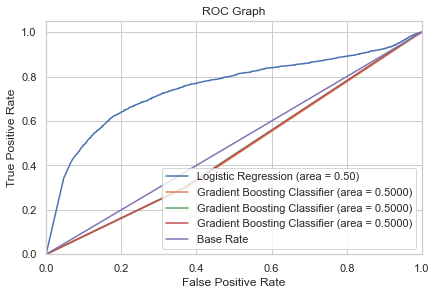

In [244]:
lr = LogisticRegression()
lr.fit(Xs_train_under, y_train_under)
lr_auc = roc_auc_score(y_test, lr.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(X_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train_under, y_train_under)
gbc_auc = roc_auc_score(y_test, gbc.predict(X_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(X_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train_under, y_train_under)
bagg_auc = roc_auc_score(y_test, bagg.predict(X_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(X_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train_under, y_train_under)
cat_auc = roc_auc_score(y_test, cat.predict(X_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(X_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)

# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % cat_auc)


# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

---

<br><br>

<font color='506AF1' size='10px'> 2)Oversampling with SMOTE

<br><br>

In [245]:
from imblearn.over_sampling import SMOTE

In [246]:
# summarize class distribution
print("Before oversampling: ",Counter(y_train))

# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
Xs_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(Xs_train, y_train)

# summarize class distribution
print("After oversampling: ",Counter(y_train_SMOTE))

Before oversampling:  Counter({0: 56189, 1: 9831})
After oversampling:  Counter({0: 56189, 1: 56189})


In [247]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train_SMOTE, Xs_test, y_train_SMOTE, y_test)
    print(f'F1-Score { model}: {f1_sc}')

F1-Score Logistic Regression: 0.5275199249882795
F1-Score Gradient Boosting Classifier: 0.5245149911816578
F1-Score Bagging Classifier : 0.47791378392762107
Learning rate set to 0.07737
0:	learn: 0.6617627	total: 26ms	remaining: 25.9s
1:	learn: 0.6352933	total: 51.1ms	remaining: 25.5s
2:	learn: 0.6133027	total: 76.9ms	remaining: 25.6s
3:	learn: 0.5953094	total: 101ms	remaining: 25.2s
4:	learn: 0.5807509	total: 135ms	remaining: 26.8s
5:	learn: 0.5691790	total: 158ms	remaining: 26.3s
6:	learn: 0.5597754	total: 183ms	remaining: 26s
7:	learn: 0.5510067	total: 214ms	remaining: 26.5s
8:	learn: 0.5432656	total: 239ms	remaining: 26.3s
9:	learn: 0.5374186	total: 262ms	remaining: 26s
10:	learn: 0.5317315	total: 290ms	remaining: 26.1s
11:	learn: 0.5276343	total: 317ms	remaining: 26.1s
12:	learn: 0.5232475	total: 341ms	remaining: 25.9s
13:	learn: 0.5197037	total: 372ms	remaining: 26.2s
14:	learn: 0.5166596	total: 404ms	remaining: 26.5s
15:	learn: 0.5137421	total: 434ms	remaining: 26.7s
16:	learn: 

162:	learn: 0.4209179	total: 4.34s	remaining: 22.3s
163:	learn: 0.4205457	total: 4.36s	remaining: 22.2s
164:	learn: 0.4193524	total: 4.39s	remaining: 22.2s
165:	learn: 0.4191324	total: 4.44s	remaining: 22.3s
166:	learn: 0.4187859	total: 4.47s	remaining: 22.3s
167:	learn: 0.4181922	total: 4.5s	remaining: 22.3s
168:	learn: 0.4179972	total: 4.52s	remaining: 22.2s
169:	learn: 0.4177992	total: 4.55s	remaining: 22.2s
170:	learn: 0.4174989	total: 4.58s	remaining: 22.2s
171:	learn: 0.4173597	total: 4.6s	remaining: 22.1s
172:	learn: 0.4171342	total: 4.63s	remaining: 22.1s
173:	learn: 0.4165742	total: 4.66s	remaining: 22.1s
174:	learn: 0.4163912	total: 4.68s	remaining: 22.1s
175:	learn: 0.4161805	total: 4.71s	remaining: 22.1s
176:	learn: 0.4159796	total: 4.74s	remaining: 22.1s
177:	learn: 0.4154604	total: 4.77s	remaining: 22s
178:	learn: 0.4147962	total: 4.79s	remaining: 22s
179:	learn: 0.4146983	total: 4.82s	remaining: 22s
180:	learn: 0.4144933	total: 4.85s	remaining: 21.9s
181:	learn: 0.413721

325:	learn: 0.3848480	total: 8.72s	remaining: 18s
326:	learn: 0.3846803	total: 8.75s	remaining: 18s
327:	learn: 0.3846014	total: 8.78s	remaining: 18s
328:	learn: 0.3843916	total: 8.8s	remaining: 18s
329:	learn: 0.3841449	total: 8.83s	remaining: 17.9s
330:	learn: 0.3840195	total: 8.87s	remaining: 17.9s
331:	learn: 0.3839337	total: 8.89s	remaining: 17.9s
332:	learn: 0.3837905	total: 8.92s	remaining: 17.9s
333:	learn: 0.3836447	total: 8.94s	remaining: 17.8s
334:	learn: 0.3835143	total: 8.97s	remaining: 17.8s
335:	learn: 0.3832260	total: 9s	remaining: 17.8s
336:	learn: 0.3831470	total: 9.02s	remaining: 17.8s
337:	learn: 0.3830543	total: 9.05s	remaining: 17.7s
338:	learn: 0.3830165	total: 9.08s	remaining: 17.7s
339:	learn: 0.3829329	total: 9.11s	remaining: 17.7s
340:	learn: 0.3828683	total: 9.14s	remaining: 17.7s
341:	learn: 0.3828049	total: 9.17s	remaining: 17.6s
342:	learn: 0.3827666	total: 9.19s	remaining: 17.6s
343:	learn: 0.3827052	total: 9.22s	remaining: 17.6s
344:	learn: 0.3826711	to

490:	learn: 0.3723261	total: 13.1s	remaining: 13.6s
491:	learn: 0.3721802	total: 13.1s	remaining: 13.5s
492:	learn: 0.3721266	total: 13.1s	remaining: 13.5s
493:	learn: 0.3720403	total: 13.2s	remaining: 13.5s
494:	learn: 0.3719877	total: 13.2s	remaining: 13.5s
495:	learn: 0.3719016	total: 13.2s	remaining: 13.4s
496:	learn: 0.3718488	total: 13.3s	remaining: 13.4s
497:	learn: 0.3718233	total: 13.3s	remaining: 13.4s
498:	learn: 0.3717096	total: 13.3s	remaining: 13.4s
499:	learn: 0.3716321	total: 13.3s	remaining: 13.3s
500:	learn: 0.3715807	total: 13.4s	remaining: 13.3s
501:	learn: 0.3714544	total: 13.4s	remaining: 13.3s
502:	learn: 0.3713463	total: 13.4s	remaining: 13.3s
503:	learn: 0.3712447	total: 13.4s	remaining: 13.2s
504:	learn: 0.3712058	total: 13.5s	remaining: 13.2s
505:	learn: 0.3711215	total: 13.5s	remaining: 13.2s
506:	learn: 0.3709623	total: 13.5s	remaining: 13.2s
507:	learn: 0.3708989	total: 13.6s	remaining: 13.1s
508:	learn: 0.3708705	total: 13.6s	remaining: 13.1s
509:	learn: 

650:	learn: 0.3650873	total: 17.3s	remaining: 9.29s
651:	learn: 0.3650651	total: 17.3s	remaining: 9.26s
652:	learn: 0.3650355	total: 17.4s	remaining: 9.23s
653:	learn: 0.3650117	total: 17.4s	remaining: 9.2s
654:	learn: 0.3649503	total: 17.4s	remaining: 9.18s
655:	learn: 0.3649322	total: 17.5s	remaining: 9.16s
656:	learn: 0.3649057	total: 17.5s	remaining: 9.13s
657:	learn: 0.3648870	total: 17.5s	remaining: 9.11s
658:	learn: 0.3648654	total: 17.5s	remaining: 9.08s
659:	learn: 0.3647905	total: 17.6s	remaining: 9.05s
660:	learn: 0.3647694	total: 17.6s	remaining: 9.02s
661:	learn: 0.3647553	total: 17.6s	remaining: 8.99s
662:	learn: 0.3647472	total: 17.6s	remaining: 8.96s
663:	learn: 0.3647213	total: 17.7s	remaining: 8.94s
664:	learn: 0.3646702	total: 17.7s	remaining: 8.91s
665:	learn: 0.3646441	total: 17.7s	remaining: 8.88s
666:	learn: 0.3646252	total: 17.7s	remaining: 8.86s
667:	learn: 0.3646018	total: 17.8s	remaining: 8.83s
668:	learn: 0.3645812	total: 17.8s	remaining: 8.8s
669:	learn: 0.

810:	learn: 0.3605652	total: 21.5s	remaining: 5.02s
811:	learn: 0.3605399	total: 21.6s	remaining: 4.99s
812:	learn: 0.3604773	total: 21.6s	remaining: 4.96s
813:	learn: 0.3604544	total: 21.6s	remaining: 4.94s
814:	learn: 0.3604456	total: 21.6s	remaining: 4.91s
815:	learn: 0.3604005	total: 21.7s	remaining: 4.88s
816:	learn: 0.3603873	total: 21.7s	remaining: 4.86s
817:	learn: 0.3603522	total: 21.7s	remaining: 4.83s
818:	learn: 0.3603289	total: 21.7s	remaining: 4.8s
819:	learn: 0.3603007	total: 21.8s	remaining: 4.78s
820:	learn: 0.3602721	total: 21.8s	remaining: 4.75s
821:	learn: 0.3602651	total: 21.8s	remaining: 4.73s
822:	learn: 0.3602216	total: 21.9s	remaining: 4.7s
823:	learn: 0.3602095	total: 21.9s	remaining: 4.67s
824:	learn: 0.3601797	total: 21.9s	remaining: 4.65s
825:	learn: 0.3601599	total: 21.9s	remaining: 4.62s
826:	learn: 0.3601232	total: 22s	remaining: 4.59s
827:	learn: 0.3601035	total: 22s	remaining: 4.57s
828:	learn: 0.3600680	total: 22s	remaining: 4.54s
829:	learn: 0.360033

969:	learn: 0.3569611	total: 25.7s	remaining: 795ms
970:	learn: 0.3569535	total: 25.7s	remaining: 768ms
971:	learn: 0.3569318	total: 25.7s	remaining: 742ms
972:	learn: 0.3569201	total: 25.8s	remaining: 715ms
973:	learn: 0.3569099	total: 25.8s	remaining: 688ms
974:	learn: 0.3568931	total: 25.8s	remaining: 662ms
975:	learn: 0.3568794	total: 25.8s	remaining: 635ms
976:	learn: 0.3568553	total: 25.9s	remaining: 609ms
977:	learn: 0.3568299	total: 25.9s	remaining: 582ms
978:	learn: 0.3568097	total: 25.9s	remaining: 556ms
979:	learn: 0.3568069	total: 26s	remaining: 530ms
980:	learn: 0.3567941	total: 26s	remaining: 503ms
981:	learn: 0.3567790	total: 26s	remaining: 477ms
982:	learn: 0.3567654	total: 26s	remaining: 450ms
983:	learn: 0.3567484	total: 26.1s	remaining: 424ms
984:	learn: 0.3567404	total: 26.1s	remaining: 397ms
985:	learn: 0.3566996	total: 26.1s	remaining: 371ms
986:	learn: 0.3566848	total: 26.1s	remaining: 344ms
987:	learn: 0.3566666	total: 26.2s	remaining: 318ms
988:	learn: 0.356654

Learning rate set to 0.07737
0:	learn: 0.6617627	total: 29.1ms	remaining: 29.1s
1:	learn: 0.6352933	total: 54.9ms	remaining: 27.4s
2:	learn: 0.6133027	total: 80ms	remaining: 26.6s
3:	learn: 0.5953094	total: 105ms	remaining: 26.2s
4:	learn: 0.5807509	total: 129ms	remaining: 25.6s
5:	learn: 0.5691790	total: 152ms	remaining: 25.2s
6:	learn: 0.5597754	total: 176ms	remaining: 24.9s
7:	learn: 0.5510067	total: 233ms	remaining: 28.8s
8:	learn: 0.5432656	total: 273ms	remaining: 30s
9:	learn: 0.5374186	total: 311ms	remaining: 30.7s
10:	learn: 0.5317315	total: 347ms	remaining: 31.2s
11:	learn: 0.5276343	total: 380ms	remaining: 31.3s
12:	learn: 0.5232475	total: 407ms	remaining: 30.9s
13:	learn: 0.5197037	total: 435ms	remaining: 30.6s
14:	learn: 0.5166596	total: 461ms	remaining: 30.3s
15:	learn: 0.5137421	total: 486ms	remaining: 29.9s
16:	learn: 0.5110508	total: 510ms	remaining: 29.5s
17:	learn: 0.5087345	total: 534ms	remaining: 29.1s
18:	learn: 0.5069737	total: 556ms	remaining: 28.7s
19:	learn: 0.

162:	learn: 0.4209179	total: 4.41s	remaining: 22.6s
163:	learn: 0.4205457	total: 4.43s	remaining: 22.6s
164:	learn: 0.4193524	total: 4.45s	remaining: 22.5s
165:	learn: 0.4191324	total: 4.48s	remaining: 22.5s
166:	learn: 0.4187859	total: 4.51s	remaining: 22.5s
167:	learn: 0.4181922	total: 4.53s	remaining: 22.4s
168:	learn: 0.4179972	total: 4.56s	remaining: 22.4s
169:	learn: 0.4177992	total: 4.58s	remaining: 22.4s
170:	learn: 0.4174989	total: 4.61s	remaining: 22.3s
171:	learn: 0.4173597	total: 4.63s	remaining: 22.3s
172:	learn: 0.4171342	total: 4.65s	remaining: 22.3s
173:	learn: 0.4165742	total: 4.68s	remaining: 22.2s
174:	learn: 0.4163912	total: 4.7s	remaining: 22.2s
175:	learn: 0.4161805	total: 4.73s	remaining: 22.2s
176:	learn: 0.4159796	total: 4.77s	remaining: 22.2s
177:	learn: 0.4154604	total: 4.79s	remaining: 22.1s
178:	learn: 0.4147962	total: 4.82s	remaining: 22.1s
179:	learn: 0.4146983	total: 4.84s	remaining: 22.1s
180:	learn: 0.4144933	total: 4.87s	remaining: 22s
181:	learn: 0.4

323:	learn: 0.3853501	total: 8.67s	remaining: 18.1s
324:	learn: 0.3850576	total: 8.7s	remaining: 18.1s
325:	learn: 0.3848480	total: 8.72s	remaining: 18s
326:	learn: 0.3846803	total: 8.75s	remaining: 18s
327:	learn: 0.3846014	total: 8.79s	remaining: 18s
328:	learn: 0.3843916	total: 8.81s	remaining: 18s
329:	learn: 0.3841449	total: 8.84s	remaining: 17.9s
330:	learn: 0.3840195	total: 8.87s	remaining: 17.9s
331:	learn: 0.3839337	total: 8.89s	remaining: 17.9s
332:	learn: 0.3837905	total: 8.92s	remaining: 17.9s
333:	learn: 0.3836447	total: 8.94s	remaining: 17.8s
334:	learn: 0.3835143	total: 8.97s	remaining: 17.8s
335:	learn: 0.3832260	total: 8.99s	remaining: 17.8s
336:	learn: 0.3831470	total: 9.02s	remaining: 17.7s
337:	learn: 0.3830543	total: 9.04s	remaining: 17.7s
338:	learn: 0.3830165	total: 9.06s	remaining: 17.7s
339:	learn: 0.3829329	total: 9.09s	remaining: 17.6s
340:	learn: 0.3828683	total: 9.12s	remaining: 17.6s
341:	learn: 0.3828049	total: 9.16s	remaining: 17.6s
342:	learn: 0.3827666

487:	learn: 0.3725088	total: 13s	remaining: 13.7s
488:	learn: 0.3724839	total: 13.1s	remaining: 13.7s
489:	learn: 0.3723940	total: 13.1s	remaining: 13.6s
490:	learn: 0.3723261	total: 13.1s	remaining: 13.6s
491:	learn: 0.3721802	total: 13.1s	remaining: 13.6s
492:	learn: 0.3721266	total: 13.2s	remaining: 13.6s
493:	learn: 0.3720403	total: 13.2s	remaining: 13.5s
494:	learn: 0.3719877	total: 13.2s	remaining: 13.5s
495:	learn: 0.3719016	total: 13.3s	remaining: 13.5s
496:	learn: 0.3718488	total: 13.3s	remaining: 13.4s
497:	learn: 0.3718233	total: 13.3s	remaining: 13.4s
498:	learn: 0.3717096	total: 13.3s	remaining: 13.4s
499:	learn: 0.3716321	total: 13.4s	remaining: 13.4s
500:	learn: 0.3715807	total: 13.4s	remaining: 13.3s
501:	learn: 0.3714544	total: 13.4s	remaining: 13.3s
502:	learn: 0.3713463	total: 13.4s	remaining: 13.3s
503:	learn: 0.3712447	total: 13.5s	remaining: 13.2s
504:	learn: 0.3712058	total: 13.5s	remaining: 13.2s
505:	learn: 0.3711215	total: 13.5s	remaining: 13.2s
506:	learn: 0.

652:	learn: 0.3650355	total: 17.4s	remaining: 9.27s
653:	learn: 0.3650117	total: 17.5s	remaining: 9.24s
654:	learn: 0.3649503	total: 17.5s	remaining: 9.22s
655:	learn: 0.3649322	total: 17.5s	remaining: 9.19s
656:	learn: 0.3649057	total: 17.6s	remaining: 9.17s
657:	learn: 0.3648870	total: 17.6s	remaining: 9.14s
658:	learn: 0.3648654	total: 17.6s	remaining: 9.11s
659:	learn: 0.3647905	total: 17.6s	remaining: 9.08s
660:	learn: 0.3647694	total: 17.7s	remaining: 9.05s
661:	learn: 0.3647553	total: 17.7s	remaining: 9.03s
662:	learn: 0.3647472	total: 17.7s	remaining: 9s
663:	learn: 0.3647213	total: 17.7s	remaining: 8.97s
664:	learn: 0.3646702	total: 17.8s	remaining: 8.95s
665:	learn: 0.3646441	total: 17.8s	remaining: 8.93s
666:	learn: 0.3646252	total: 17.8s	remaining: 8.9s
667:	learn: 0.3646018	total: 17.8s	remaining: 8.87s
668:	learn: 0.3645812	total: 17.9s	remaining: 8.84s
669:	learn: 0.3645448	total: 17.9s	remaining: 8.81s
670:	learn: 0.3644458	total: 17.9s	remaining: 8.79s
671:	learn: 0.36

817:	learn: 0.3603522	total: 21.7s	remaining: 4.82s
818:	learn: 0.3603289	total: 21.7s	remaining: 4.79s
819:	learn: 0.3603007	total: 21.7s	remaining: 4.77s
820:	learn: 0.3602721	total: 21.7s	remaining: 4.74s
821:	learn: 0.3602651	total: 21.8s	remaining: 4.71s
822:	learn: 0.3602216	total: 21.8s	remaining: 4.69s
823:	learn: 0.3602095	total: 21.8s	remaining: 4.66s
824:	learn: 0.3601797	total: 21.8s	remaining: 4.63s
825:	learn: 0.3601599	total: 21.9s	remaining: 4.61s
826:	learn: 0.3601232	total: 21.9s	remaining: 4.58s
827:	learn: 0.3601035	total: 21.9s	remaining: 4.55s
828:	learn: 0.3600680	total: 21.9s	remaining: 4.53s
829:	learn: 0.3600337	total: 22s	remaining: 4.5s
830:	learn: 0.3600262	total: 22s	remaining: 4.47s
831:	learn: 0.3600049	total: 22s	remaining: 4.45s
832:	learn: 0.3599701	total: 22.1s	remaining: 4.42s
833:	learn: 0.3599286	total: 22.1s	remaining: 4.39s
834:	learn: 0.3599116	total: 22.1s	remaining: 4.37s
835:	learn: 0.3598814	total: 22.1s	remaining: 4.34s
836:	learn: 0.35986

977:	learn: 0.3568299	total: 26.3s	remaining: 591ms
978:	learn: 0.3568097	total: 26.3s	remaining: 564ms
979:	learn: 0.3568069	total: 26.3s	remaining: 537ms
980:	learn: 0.3567941	total: 26.4s	remaining: 511ms
981:	learn: 0.3567790	total: 26.4s	remaining: 484ms
982:	learn: 0.3567654	total: 26.4s	remaining: 457ms
983:	learn: 0.3567484	total: 26.5s	remaining: 430ms
984:	learn: 0.3567404	total: 26.5s	remaining: 403ms
985:	learn: 0.3566996	total: 26.5s	remaining: 377ms
986:	learn: 0.3566848	total: 26.6s	remaining: 350ms
987:	learn: 0.3566666	total: 26.6s	remaining: 323ms
988:	learn: 0.3566542	total: 26.6s	remaining: 296ms
989:	learn: 0.3566361	total: 26.6s	remaining: 269ms
990:	learn: 0.3566318	total: 26.7s	remaining: 242ms
991:	learn: 0.3566214	total: 26.7s	remaining: 215ms
992:	learn: 0.3566024	total: 26.7s	remaining: 188ms
993:	learn: 0.3565772	total: 26.8s	remaining: 162ms
994:	learn: 0.3565662	total: 26.8s	remaining: 135ms
995:	learn: 0.3565414	total: 26.8s	remaining: 108ms
996:	learn: 

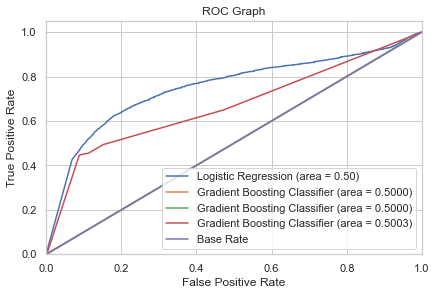

In [248]:
lr = LogisticRegression()
lr.fit(Xs_train_SMOTE, y_train_SMOTE)
lr_auc = roc_auc_score(y_test, lr.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(X_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train_SMOTE, y_train_SMOTE)
gbc_auc = roc_auc_score(y_test, gbc.predict(X_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(X_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train_SMOTE, y_train_SMOTE)
bagg_auc = roc_auc_score(y_test, bagg.predict(X_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(X_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train_SMOTE, y_train_SMOTE)
cat_auc = roc_auc_score(y_test, cat.predict(X_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(X_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % cat_auc)


# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

In [249]:
from sklearn.metrics import f1_score

F1-Score for train data:     0.7392174299688751
F1-Score for test data:      0.5283268703300861

ROC AUC score for undersampled test data:  0.7574145455199917
ROC AUC score for undersampled train data:  0.7613671040585901


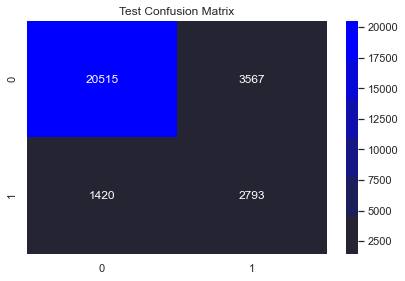

Classification Report For Train Set:
              precision    recall  f1-score   support

     class 0       0.72      0.85      0.78      9831
     class 1       0.81      0.68      0.74      9831

    accuracy                           0.76     19662
   macro avg       0.77      0.76      0.76     19662
weighted avg       0.77      0.76      0.76     19662

Classification Report For Test Set:
              precision    recall  f1-score   support

     class 0       0.94      0.85      0.89     24082
     class 1       0.44      0.66      0.53      4213

    accuracy                           0.82     28295
   macro avg       0.69      0.76      0.71     28295
weighted avg       0.86      0.82      0.84     28295



In [250]:
model=LogisticRegression()
clf_under = model.fit(Xs_train_under, y_train_under)

#prediction
pred_test = clf_under.predict(Xs_test)
pred_train = clf_under.predict(Xs_train_under)

#scores
print('F1-Score for train data:    ',f1_score(y_train_under, pred_train))
print('F1-Score for test data:     ',f1_score(y_test, pred_test))
print()
print("ROC AUC score for undersampled test data: ", roc_auc_score(y_test, pred_test))
print("ROC AUC score for undersampled train data: ", roc_auc_score(y_train_under, pred_train))

cm = confusion_matrix(y_test, pred_test)
sns.heatmap(cm, annot=True, fmt='d' , cmap=sns.dark_palette('blue'))
plt.title('Test Confusion Matrix')
plt.show()

target_names = ['class 0', 'class 1']
print(f"Classification Report For Train Set:\n{classification_report(y_train_under,pred_train, target_names=target_names)}")
print(f"Classification Report For Test Set:\n{classification_report(y_test, pred_test, target_names=target_names)}")

We noticed that the two previous methods give us a low score, and to find out the reason, we printed the full report of the Under Sample to find out the reason.
It turns out that the values of zero and one are not balanced, so we will try the third method and generalize it to the rest of the scenarios.

<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

### Resample the data and apply models

In [251]:
scenario_1[scenario_1['diabetetic'] == 1].shape

(14044, 13)

In [252]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_1_sample_class_1 = scenario_1[scenario_1['diabetetic'] == 1]
scenario_1_sample_class_0 = scenario_1[scenario_1['diabetetic'] == 0][:14044]


df = scenario_1_sample_class_1.append(scenario_1_sample_class_0)

In [253]:

y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [254]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [255]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.6418703506907546
F1-ScoreGradient Boosting Classifier: 0.7406321959388739
F1-ScoreBagging Classifier : 0.6984671454603923
Learning rate set to 0.035609
0:	learn: 0.6799967	total: 20.5ms	remaining: 20.5s
1:	learn: 0.6680766	total: 39.6ms	remaining: 19.7s
2:	learn: 0.6572588	total: 76.2ms	remaining: 25.3s
3:	learn: 0.6473788	total: 88.1ms	remaining: 21.9s
4:	learn: 0.6397806	total: 97.8ms	remaining: 19.5s
5:	learn: 0.6315049	total: 106ms	remaining: 17.6s
6:	learn: 0.6242564	total: 116ms	remaining: 16.4s
7:	learn: 0.6181493	total: 124ms	remaining: 15.3s
8:	learn: 0.6120428	total: 131ms	remaining: 14.4s
9:	learn: 0.6068968	total: 139ms	remaining: 13.8s
10:	learn: 0.6018019	total: 148ms	remaining: 13.3s
11:	learn: 0.5963306	total: 156ms	remaining: 12.9s
12:	learn: 0.5924708	total: 164ms	remaining: 12.5s
13:	learn: 0.5883033	total: 172ms	remaining: 12.1s
14:	learn: 0.5843694	total: 181ms	remaining: 11.9s
15:	learn: 0.5807044	total: 189ms	remaining: 11.6s
16:	le

175:	learn: 0.5124896	total: 1.72s	remaining: 8.03s
176:	learn: 0.5124193	total: 1.72s	remaining: 8.02s
177:	learn: 0.5123443	total: 1.73s	remaining: 8.01s
178:	learn: 0.5123098	total: 1.75s	remaining: 8.02s
179:	learn: 0.5122639	total: 1.76s	remaining: 8.02s
180:	learn: 0.5121951	total: 1.77s	remaining: 8s
181:	learn: 0.5121751	total: 1.78s	remaining: 7.99s
182:	learn: 0.5120910	total: 1.79s	remaining: 7.99s
183:	learn: 0.5120500	total: 1.8s	remaining: 7.97s
184:	learn: 0.5120025	total: 1.81s	remaining: 7.96s
185:	learn: 0.5119407	total: 1.82s	remaining: 7.95s
186:	learn: 0.5118803	total: 1.82s	remaining: 7.94s
187:	learn: 0.5118054	total: 1.83s	remaining: 7.92s
188:	learn: 0.5117645	total: 1.84s	remaining: 7.91s
189:	learn: 0.5116659	total: 1.85s	remaining: 7.91s
190:	learn: 0.5115992	total: 1.86s	remaining: 7.9s
191:	learn: 0.5115825	total: 1.87s	remaining: 7.88s
192:	learn: 0.5115453	total: 1.88s	remaining: 7.87s
193:	learn: 0.5114948	total: 1.9s	remaining: 7.88s
194:	learn: 0.5114

335:	learn: 0.5053178	total: 3.33s	remaining: 6.58s
336:	learn: 0.5052667	total: 3.34s	remaining: 6.57s
337:	learn: 0.5052508	total: 3.35s	remaining: 6.56s
338:	learn: 0.5052072	total: 3.36s	remaining: 6.55s
339:	learn: 0.5051974	total: 3.37s	remaining: 6.54s
340:	learn: 0.5051208	total: 3.38s	remaining: 6.53s
341:	learn: 0.5050516	total: 3.39s	remaining: 6.51s
342:	learn: 0.5050185	total: 3.4s	remaining: 6.5s
343:	learn: 0.5049335	total: 3.41s	remaining: 6.5s
344:	learn: 0.5048857	total: 3.42s	remaining: 6.49s
345:	learn: 0.5048237	total: 3.43s	remaining: 6.48s
346:	learn: 0.5047759	total: 3.44s	remaining: 6.47s
347:	learn: 0.5047103	total: 3.45s	remaining: 6.46s
348:	learn: 0.5046686	total: 3.46s	remaining: 6.45s
349:	learn: 0.5046102	total: 3.47s	remaining: 6.44s
350:	learn: 0.5045994	total: 3.48s	remaining: 6.43s
351:	learn: 0.5045504	total: 3.49s	remaining: 6.42s
352:	learn: 0.5045148	total: 3.5s	remaining: 6.41s
353:	learn: 0.5044911	total: 3.5s	remaining: 6.4s
354:	learn: 0.5044

494:	learn: 0.4985124	total: 4.96s	remaining: 5.06s
495:	learn: 0.4984889	total: 4.96s	remaining: 5.04s
496:	learn: 0.4984526	total: 4.97s	remaining: 5.03s
497:	learn: 0.4984055	total: 4.99s	remaining: 5.03s
498:	learn: 0.4983260	total: 5s	remaining: 5.02s
499:	learn: 0.4983207	total: 5.01s	remaining: 5.01s
500:	learn: 0.4982922	total: 5.02s	remaining: 5s
501:	learn: 0.4982345	total: 5.03s	remaining: 4.99s
502:	learn: 0.4982022	total: 5.04s	remaining: 4.97s
503:	learn: 0.4981702	total: 5.04s	remaining: 4.96s
504:	learn: 0.4981286	total: 5.05s	remaining: 4.95s
505:	learn: 0.4981130	total: 5.06s	remaining: 4.94s
506:	learn: 0.4980860	total: 5.07s	remaining: 4.93s
507:	learn: 0.4980816	total: 5.08s	remaining: 4.92s
508:	learn: 0.4980643	total: 5.09s	remaining: 4.91s
509:	learn: 0.4980502	total: 5.1s	remaining: 4.9s
510:	learn: 0.4980030	total: 5.11s	remaining: 4.89s
511:	learn: 0.4979529	total: 5.12s	remaining: 4.88s
512:	learn: 0.4979227	total: 5.13s	remaining: 4.87s
513:	learn: 0.497895

658:	learn: 0.4926449	total: 6.58s	remaining: 3.41s
659:	learn: 0.4926087	total: 6.59s	remaining: 3.4s
660:	learn: 0.4925844	total: 6.6s	remaining: 3.39s
661:	learn: 0.4925394	total: 6.61s	remaining: 3.38s
662:	learn: 0.4925258	total: 6.62s	remaining: 3.37s
663:	learn: 0.4924899	total: 6.63s	remaining: 3.35s
664:	learn: 0.4924785	total: 6.64s	remaining: 3.34s
665:	learn: 0.4924551	total: 6.65s	remaining: 3.33s
666:	learn: 0.4924298	total: 6.66s	remaining: 3.32s
667:	learn: 0.4923858	total: 6.67s	remaining: 3.31s
668:	learn: 0.4923267	total: 6.67s	remaining: 3.3s
669:	learn: 0.4922898	total: 6.69s	remaining: 3.29s
670:	learn: 0.4922707	total: 6.7s	remaining: 3.28s
671:	learn: 0.4922494	total: 6.7s	remaining: 3.27s
672:	learn: 0.4921909	total: 6.71s	remaining: 3.26s
673:	learn: 0.4921783	total: 6.73s	remaining: 3.25s
674:	learn: 0.4921616	total: 6.74s	remaining: 3.24s
675:	learn: 0.4921180	total: 6.74s	remaining: 3.23s
676:	learn: 0.4920640	total: 6.75s	remaining: 3.22s
677:	learn: 0.492

822:	learn: 0.4875843	total: 8.2s	remaining: 1.76s
823:	learn: 0.4875755	total: 8.2s	remaining: 1.75s
824:	learn: 0.4875610	total: 8.21s	remaining: 1.74s
825:	learn: 0.4875316	total: 8.22s	remaining: 1.73s
826:	learn: 0.4875128	total: 8.23s	remaining: 1.72s
827:	learn: 0.4875103	total: 8.24s	remaining: 1.71s
828:	learn: 0.4874758	total: 8.25s	remaining: 1.7s
829:	learn: 0.4874662	total: 8.26s	remaining: 1.69s
830:	learn: 0.4874476	total: 8.27s	remaining: 1.68s
831:	learn: 0.4873972	total: 8.28s	remaining: 1.67s
832:	learn: 0.4873519	total: 8.29s	remaining: 1.66s
833:	learn: 0.4873389	total: 8.31s	remaining: 1.65s
834:	learn: 0.4872999	total: 8.32s	remaining: 1.64s
835:	learn: 0.4872759	total: 8.32s	remaining: 1.63s
836:	learn: 0.4872470	total: 8.33s	remaining: 1.62s
837:	learn: 0.4871946	total: 8.35s	remaining: 1.61s
838:	learn: 0.4871392	total: 8.36s	remaining: 1.6s
839:	learn: 0.4871188	total: 8.38s	remaining: 1.59s
840:	learn: 0.4870615	total: 8.39s	remaining: 1.58s
841:	learn: 0.48

984:	learn: 0.4833014	total: 9.82s	remaining: 150ms
985:	learn: 0.4832450	total: 9.83s	remaining: 140ms
986:	learn: 0.4832240	total: 9.84s	remaining: 130ms
987:	learn: 0.4831842	total: 9.85s	remaining: 120ms
988:	learn: 0.4831440	total: 9.86s	remaining: 110ms
989:	learn: 0.4831214	total: 9.87s	remaining: 99.7ms
990:	learn: 0.4830855	total: 9.88s	remaining: 89.8ms
991:	learn: 0.4830808	total: 9.89s	remaining: 79.8ms
992:	learn: 0.4830701	total: 9.9s	remaining: 69.8ms
993:	learn: 0.4830554	total: 9.91s	remaining: 59.8ms
994:	learn: 0.4829994	total: 9.92s	remaining: 49.9ms
995:	learn: 0.4829894	total: 9.94s	remaining: 39.9ms
996:	learn: 0.4829498	total: 9.95s	remaining: 29.9ms
997:	learn: 0.4829268	total: 9.96s	remaining: 20ms
998:	learn: 0.4828829	total: 9.97s	remaining: 9.98ms
999:	learn: 0.4828507	total: 9.98s	remaining: 0us
F1-ScoreCat Boost Classifier: 0.7388535031847134


Learning rate set to 0.035609
0:	learn: 0.6799967	total: 9.34ms	remaining: 9.33s
1:	learn: 0.6680766	total: 18.4ms	remaining: 9.19s
2:	learn: 0.6572588	total: 27.2ms	remaining: 9.04s
3:	learn: 0.6473788	total: 36ms	remaining: 8.96s
4:	learn: 0.6397806	total: 45ms	remaining: 8.95s
5:	learn: 0.6315049	total: 53.9ms	remaining: 8.92s
6:	learn: 0.6242564	total: 63ms	remaining: 8.94s
7:	learn: 0.6181493	total: 72ms	remaining: 8.93s
8:	learn: 0.6120428	total: 80.6ms	remaining: 8.88s
9:	learn: 0.6068968	total: 89.4ms	remaining: 8.85s
10:	learn: 0.6018019	total: 98.8ms	remaining: 8.88s
11:	learn: 0.5963306	total: 107ms	remaining: 8.8s
12:	learn: 0.5924708	total: 116ms	remaining: 8.78s
13:	learn: 0.5883033	total: 125ms	remaining: 8.79s
14:	learn: 0.5843694	total: 133ms	remaining: 8.74s
15:	learn: 0.5807044	total: 142ms	remaining: 8.74s
16:	learn: 0.5771552	total: 151ms	remaining: 8.73s
17:	learn: 0.5739806	total: 160ms	remaining: 8.72s
18:	learn: 0.5710157	total: 169ms	remaining: 8.72s
19:	learn

170:	learn: 0.5127778	total: 1.63s	remaining: 7.92s
171:	learn: 0.5126970	total: 1.64s	remaining: 7.92s
172:	learn: 0.5125960	total: 1.66s	remaining: 7.92s
173:	learn: 0.5125757	total: 1.67s	remaining: 7.91s
174:	learn: 0.5125435	total: 1.67s	remaining: 7.89s
175:	learn: 0.5124896	total: 1.68s	remaining: 7.88s
176:	learn: 0.5124193	total: 1.7s	remaining: 7.91s
177:	learn: 0.5123443	total: 1.71s	remaining: 7.9s
178:	learn: 0.5123098	total: 1.72s	remaining: 7.88s
179:	learn: 0.5122639	total: 1.73s	remaining: 7.88s
180:	learn: 0.5121951	total: 1.74s	remaining: 7.87s
181:	learn: 0.5121751	total: 1.75s	remaining: 7.85s
182:	learn: 0.5120910	total: 1.76s	remaining: 7.84s
183:	learn: 0.5120500	total: 1.77s	remaining: 7.85s
184:	learn: 0.5120025	total: 1.78s	remaining: 7.84s
185:	learn: 0.5119407	total: 1.79s	remaining: 7.83s
186:	learn: 0.5118803	total: 1.8s	remaining: 7.82s
187:	learn: 0.5118054	total: 1.81s	remaining: 7.81s
188:	learn: 0.5117645	total: 1.82s	remaining: 7.8s
189:	learn: 0.51

344:	learn: 0.5048857	total: 3.44s	remaining: 6.54s
345:	learn: 0.5048237	total: 3.45s	remaining: 6.53s
346:	learn: 0.5047759	total: 3.46s	remaining: 6.52s
347:	learn: 0.5047103	total: 3.47s	remaining: 6.51s
348:	learn: 0.5046686	total: 3.48s	remaining: 6.5s
349:	learn: 0.5046102	total: 3.49s	remaining: 6.49s
350:	learn: 0.5045994	total: 3.5s	remaining: 6.47s
351:	learn: 0.5045504	total: 3.51s	remaining: 6.46s
352:	learn: 0.5045148	total: 3.52s	remaining: 6.45s
353:	learn: 0.5044911	total: 3.53s	remaining: 6.44s
354:	learn: 0.5044262	total: 3.54s	remaining: 6.43s
355:	learn: 0.5043856	total: 3.55s	remaining: 6.42s
356:	learn: 0.5043429	total: 3.56s	remaining: 6.41s
357:	learn: 0.5042887	total: 3.57s	remaining: 6.4s
358:	learn: 0.5042318	total: 3.58s	remaining: 6.39s
359:	learn: 0.5041845	total: 3.59s	remaining: 6.38s
360:	learn: 0.5041252	total: 3.6s	remaining: 6.37s
361:	learn: 0.5040860	total: 3.61s	remaining: 6.36s
362:	learn: 0.5040270	total: 3.62s	remaining: 6.35s
363:	learn: 0.50

503:	learn: 0.4981702	total: 5.06s	remaining: 4.98s
504:	learn: 0.4981286	total: 5.07s	remaining: 4.97s
505:	learn: 0.4981130	total: 5.08s	remaining: 4.96s
506:	learn: 0.4980860	total: 5.09s	remaining: 4.95s
507:	learn: 0.4980816	total: 5.1s	remaining: 4.94s
508:	learn: 0.4980643	total: 5.11s	remaining: 4.93s
509:	learn: 0.4980502	total: 5.12s	remaining: 4.92s
510:	learn: 0.4980030	total: 5.13s	remaining: 4.91s
511:	learn: 0.4979529	total: 5.14s	remaining: 4.9s
512:	learn: 0.4979227	total: 5.15s	remaining: 4.89s
513:	learn: 0.4978951	total: 5.16s	remaining: 4.88s
514:	learn: 0.4978860	total: 5.17s	remaining: 4.87s
515:	learn: 0.4978555	total: 5.18s	remaining: 4.86s
516:	learn: 0.4978280	total: 5.19s	remaining: 4.85s
517:	learn: 0.4977920	total: 5.2s	remaining: 4.84s
518:	learn: 0.4977852	total: 5.21s	remaining: 4.83s
519:	learn: 0.4977427	total: 5.22s	remaining: 4.82s
520:	learn: 0.4976899	total: 5.23s	remaining: 4.8s
521:	learn: 0.4976283	total: 5.24s	remaining: 4.79s
522:	learn: 0.49

663:	learn: 0.4924899	total: 6.69s	remaining: 3.38s
664:	learn: 0.4924785	total: 6.7s	remaining: 3.37s
665:	learn: 0.4924551	total: 6.71s	remaining: 3.36s
666:	learn: 0.4924298	total: 6.72s	remaining: 3.35s
667:	learn: 0.4923858	total: 6.72s	remaining: 3.34s
668:	learn: 0.4923267	total: 6.74s	remaining: 3.33s
669:	learn: 0.4922898	total: 6.75s	remaining: 3.32s
670:	learn: 0.4922707	total: 6.75s	remaining: 3.31s
671:	learn: 0.4922494	total: 6.76s	remaining: 3.3s
672:	learn: 0.4921909	total: 6.78s	remaining: 3.29s
673:	learn: 0.4921783	total: 6.79s	remaining: 3.28s
674:	learn: 0.4921616	total: 6.8s	remaining: 3.27s
675:	learn: 0.4921180	total: 6.81s	remaining: 3.26s
676:	learn: 0.4920640	total: 6.82s	remaining: 3.25s
677:	learn: 0.4920292	total: 6.83s	remaining: 3.24s
678:	learn: 0.4919879	total: 6.84s	remaining: 3.23s
679:	learn: 0.4919570	total: 6.85s	remaining: 3.22s
680:	learn: 0.4919088	total: 6.86s	remaining: 3.21s
681:	learn: 0.4918807	total: 6.88s	remaining: 3.21s
682:	learn: 0.4

823:	learn: 0.4875755	total: 8.32s	remaining: 1.78s
824:	learn: 0.4875610	total: 8.34s	remaining: 1.77s
825:	learn: 0.4875316	total: 8.35s	remaining: 1.76s
826:	learn: 0.4875128	total: 8.36s	remaining: 1.75s
827:	learn: 0.4875103	total: 8.37s	remaining: 1.74s
828:	learn: 0.4874758	total: 8.38s	remaining: 1.73s
829:	learn: 0.4874662	total: 8.39s	remaining: 1.72s
830:	learn: 0.4874476	total: 8.4s	remaining: 1.71s
831:	learn: 0.4873972	total: 8.41s	remaining: 1.7s
832:	learn: 0.4873519	total: 8.42s	remaining: 1.69s
833:	learn: 0.4873389	total: 8.43s	remaining: 1.68s
834:	learn: 0.4872999	total: 8.44s	remaining: 1.67s
835:	learn: 0.4872759	total: 8.45s	remaining: 1.66s
836:	learn: 0.4872470	total: 8.46s	remaining: 1.65s
837:	learn: 0.4871946	total: 8.47s	remaining: 1.64s
838:	learn: 0.4871392	total: 8.48s	remaining: 1.63s
839:	learn: 0.4871188	total: 8.49s	remaining: 1.62s
840:	learn: 0.4870615	total: 8.5s	remaining: 1.61s
841:	learn: 0.4870284	total: 8.51s	remaining: 1.6s
842:	learn: 0.48

997:	learn: 0.4829268	total: 10.1s	remaining: 20.3ms
998:	learn: 0.4828829	total: 10.1s	remaining: 10.1ms
999:	learn: 0.4828507	total: 10.1s	remaining: 0us


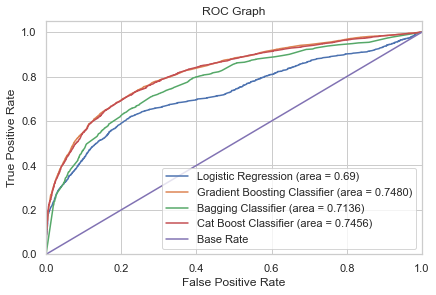

In [256]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)


# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:2
        <br><br>


<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

In [257]:
scenario_2[scenario_2['diabetetic'] == 1].shape

(14044, 13)

In [258]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_2_sample_class_1 = scenario_2[scenario_2['diabetetic'] == 1]
scenario_2_sample_class_0 = scenario_2[scenario_2['diabetetic'] == 0][:14044]


df = scenario_2_sample_class_1.append(scenario_2_sample_class_0)

In [259]:

y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [260]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [261]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.6417857564662809
F1-ScoreGradient Boosting Classifier: 0.738892398399663
F1-ScoreBagging Classifier : 0.7025013304949442
Learning rate set to 0.035609
0:	learn: 0.6799967	total: 9.42ms	remaining: 9.41s
1:	learn: 0.6680766	total: 18.7ms	remaining: 9.32s
2:	learn: 0.6572588	total: 27.5ms	remaining: 9.14s
3:	learn: 0.6473788	total: 37ms	remaining: 9.21s
4:	learn: 0.6397806	total: 45.5ms	remaining: 9.06s
5:	learn: 0.6315049	total: 54.1ms	remaining: 8.96s
6:	learn: 0.6242564	total: 63.4ms	remaining: 8.99s
7:	learn: 0.6181493	total: 72ms	remaining: 8.93s
8:	learn: 0.6120428	total: 80.5ms	remaining: 8.86s
9:	learn: 0.6068968	total: 89.2ms	remaining: 8.83s
10:	learn: 0.6018019	total: 125ms	remaining: 11.3s
11:	learn: 0.5963306	total: 135ms	remaining: 11.1s
12:	learn: 0.5924708	total: 144ms	remaining: 10.9s
13:	learn: 0.5883033	total: 153ms	remaining: 10.8s
14:	learn: 0.5843694	total: 162ms	remaining: 10.6s
15:	learn: 0.5807044	total: 171ms	remaining: 10.5s
16:	le

171:	learn: 0.5128082	total: 1.79s	remaining: 8.63s
172:	learn: 0.5127366	total: 1.81s	remaining: 8.64s
173:	learn: 0.5126480	total: 1.82s	remaining: 8.63s
174:	learn: 0.5126233	total: 1.83s	remaining: 8.61s
175:	learn: 0.5125968	total: 1.84s	remaining: 8.6s
176:	learn: 0.5125608	total: 1.84s	remaining: 8.58s
177:	learn: 0.5125086	total: 1.85s	remaining: 8.56s
178:	learn: 0.5124280	total: 1.86s	remaining: 8.55s
179:	learn: 0.5123999	total: 1.88s	remaining: 8.55s
180:	learn: 0.5123553	total: 1.89s	remaining: 8.53s
181:	learn: 0.5122935	total: 1.89s	remaining: 8.52s
182:	learn: 0.5122505	total: 1.9s	remaining: 8.5s
183:	learn: 0.5121657	total: 1.91s	remaining: 8.49s
184:	learn: 0.5121296	total: 1.92s	remaining: 8.47s
185:	learn: 0.5120938	total: 1.93s	remaining: 8.45s
186:	learn: 0.5120360	total: 1.94s	remaining: 8.44s
187:	learn: 0.5120055	total: 1.95s	remaining: 8.42s
188:	learn: 0.5119478	total: 1.96s	remaining: 8.41s
189:	learn: 0.5119051	total: 1.97s	remaining: 8.4s
190:	learn: 0.51

330:	learn: 0.5061752	total: 3.42s	remaining: 6.91s
331:	learn: 0.5061615	total: 3.43s	remaining: 6.9s
332:	learn: 0.5061362	total: 3.44s	remaining: 6.88s
333:	learn: 0.5060751	total: 3.45s	remaining: 6.88s
334:	learn: 0.5060661	total: 3.46s	remaining: 6.86s
335:	learn: 0.5060104	total: 3.47s	remaining: 6.86s
336:	learn: 0.5060076	total: 3.48s	remaining: 6.84s
337:	learn: 0.5059642	total: 3.49s	remaining: 6.83s
338:	learn: 0.5059060	total: 3.5s	remaining: 6.83s
339:	learn: 0.5058182	total: 3.51s	remaining: 6.82s
340:	learn: 0.5057728	total: 3.53s	remaining: 6.82s
341:	learn: 0.5057201	total: 3.54s	remaining: 6.82s
342:	learn: 0.5056538	total: 3.55s	remaining: 6.81s
343:	learn: 0.5056419	total: 3.56s	remaining: 6.79s
344:	learn: 0.5055899	total: 3.57s	remaining: 6.78s
345:	learn: 0.5055250	total: 3.58s	remaining: 6.77s
346:	learn: 0.5054656	total: 3.59s	remaining: 6.76s
347:	learn: 0.5054376	total: 3.61s	remaining: 6.76s
348:	learn: 0.5054001	total: 3.62s	remaining: 6.74s
349:	learn: 0.

497:	learn: 0.4984119	total: 5.23s	remaining: 5.27s
498:	learn: 0.4983575	total: 5.24s	remaining: 5.26s
499:	learn: 0.4983270	total: 5.25s	remaining: 5.25s
500:	learn: 0.4982944	total: 5.26s	remaining: 5.24s
501:	learn: 0.4982628	total: 5.27s	remaining: 5.23s
502:	learn: 0.4982330	total: 5.28s	remaining: 5.21s
503:	learn: 0.4982258	total: 5.29s	remaining: 5.21s
504:	learn: 0.4981810	total: 5.3s	remaining: 5.2s
505:	learn: 0.4981539	total: 5.31s	remaining: 5.18s
506:	learn: 0.4981132	total: 5.32s	remaining: 5.17s
507:	learn: 0.4980708	total: 5.33s	remaining: 5.16s
508:	learn: 0.4980553	total: 5.34s	remaining: 5.15s
509:	learn: 0.4979938	total: 5.35s	remaining: 5.14s
510:	learn: 0.4979166	total: 5.36s	remaining: 5.13s
511:	learn: 0.4978760	total: 5.37s	remaining: 5.12s
512:	learn: 0.4978184	total: 5.38s	remaining: 5.11s
513:	learn: 0.4977881	total: 5.39s	remaining: 5.1s
514:	learn: 0.4977700	total: 5.4s	remaining: 5.09s
515:	learn: 0.4977389	total: 5.42s	remaining: 5.08s
516:	learn: 0.49

663:	learn: 0.4925839	total: 7.05s	remaining: 3.57s
664:	learn: 0.4925470	total: 7.06s	remaining: 3.56s
665:	learn: 0.4924834	total: 7.07s	remaining: 3.55s
666:	learn: 0.4924412	total: 7.1s	remaining: 3.54s
667:	learn: 0.4924367	total: 7.11s	remaining: 3.53s
668:	learn: 0.4924037	total: 7.12s	remaining: 3.52s
669:	learn: 0.4923783	total: 7.14s	remaining: 3.52s
670:	learn: 0.4923520	total: 7.15s	remaining: 3.5s
671:	learn: 0.4922705	total: 7.16s	remaining: 3.49s
672:	learn: 0.4922251	total: 7.17s	remaining: 3.48s
673:	learn: 0.4921677	total: 7.18s	remaining: 3.47s
674:	learn: 0.4921180	total: 7.19s	remaining: 3.46s
675:	learn: 0.4920727	total: 7.2s	remaining: 3.45s
676:	learn: 0.4920531	total: 7.21s	remaining: 3.44s
677:	learn: 0.4920334	total: 7.22s	remaining: 3.43s
678:	learn: 0.4919955	total: 7.23s	remaining: 3.42s
679:	learn: 0.4919285	total: 7.25s	remaining: 3.41s
680:	learn: 0.4918869	total: 7.26s	remaining: 3.4s
681:	learn: 0.4918587	total: 7.27s	remaining: 3.39s
682:	learn: 0.49

830:	learn: 0.4873553	total: 8.85s	remaining: 1.8s
831:	learn: 0.4873411	total: 8.86s	remaining: 1.79s
832:	learn: 0.4873128	total: 8.87s	remaining: 1.78s
833:	learn: 0.4873106	total: 8.88s	remaining: 1.77s
834:	learn: 0.4872758	total: 8.89s	remaining: 1.76s
835:	learn: 0.4872547	total: 8.9s	remaining: 1.75s
836:	learn: 0.4872162	total: 8.91s	remaining: 1.74s
837:	learn: 0.4871870	total: 8.93s	remaining: 1.73s
838:	learn: 0.4871561	total: 8.94s	remaining: 1.71s
839:	learn: 0.4871339	total: 8.95s	remaining: 1.7s
840:	learn: 0.4870925	total: 8.96s	remaining: 1.69s
841:	learn: 0.4870759	total: 8.97s	remaining: 1.68s
842:	learn: 0.4870203	total: 8.98s	remaining: 1.67s
843:	learn: 0.4869877	total: 8.99s	remaining: 1.66s
844:	learn: 0.4869757	total: 9s	remaining: 1.65s
845:	learn: 0.4869198	total: 9.01s	remaining: 1.64s
846:	learn: 0.4869145	total: 9.02s	remaining: 1.63s
847:	learn: 0.4868639	total: 9.03s	remaining: 1.62s
848:	learn: 0.4868337	total: 9.04s	remaining: 1.61s
849:	learn: 0.4868

F1-ScoreCat Boost Classifier: 0.739680217368586


Learning rate set to 0.035609
0:	learn: 0.6799967	total: 9.06ms	remaining: 9.05s
1:	learn: 0.6680766	total: 18.5ms	remaining: 9.23s
2:	learn: 0.6572588	total: 27.8ms	remaining: 9.23s
3:	learn: 0.6473788	total: 37.9ms	remaining: 9.43s
4:	learn: 0.6397806	total: 48.1ms	remaining: 9.57s
5:	learn: 0.6315049	total: 58.2ms	remaining: 9.64s
6:	learn: 0.6242564	total: 77.8ms	remaining: 11s
7:	learn: 0.6181493	total: 87.7ms	remaining: 10.9s
8:	learn: 0.6120428	total: 97ms	remaining: 10.7s
9:	learn: 0.6068968	total: 106ms	remaining: 10.5s
10:	learn: 0.6018019	total: 115ms	remaining: 10.4s
11:	learn: 0.5963306	total: 124ms	remaining: 10.2s
12:	learn: 0.5924708	total: 132ms	remaining: 10s
13:	learn: 0.5883033	total: 140ms	remaining: 9.89s
14:	learn: 0.5843694	total: 149ms	remaining: 9.79s
15:	learn: 0.5807044	total: 158ms	remaining: 9.71s
16:	learn: 0.5771552	total: 166ms	remaining: 9.63s
17:	learn: 0.5739806	total: 175ms	remaining: 9.56s
18:	learn: 0.5710157	total: 184ms	remaining: 9.49s
19:	lear

164:	learn: 0.5131346	total: 1.64s	remaining: 8.28s
165:	learn: 0.5131164	total: 1.65s	remaining: 8.27s
166:	learn: 0.5130842	total: 1.66s	remaining: 8.26s
167:	learn: 0.5130324	total: 1.67s	remaining: 8.26s
168:	learn: 0.5129334	total: 1.68s	remaining: 8.25s
169:	learn: 0.5128780	total: 1.69s	remaining: 8.24s
170:	learn: 0.5128511	total: 1.7s	remaining: 8.23s
171:	learn: 0.5128082	total: 1.71s	remaining: 8.21s
172:	learn: 0.5127366	total: 1.72s	remaining: 8.2s
173:	learn: 0.5126480	total: 1.73s	remaining: 8.19s
174:	learn: 0.5126233	total: 1.74s	remaining: 8.2s
175:	learn: 0.5125968	total: 1.75s	remaining: 8.18s
176:	learn: 0.5125608	total: 1.76s	remaining: 8.17s
177:	learn: 0.5125086	total: 1.77s	remaining: 8.16s
178:	learn: 0.5124280	total: 1.78s	remaining: 8.15s
179:	learn: 0.5123999	total: 1.79s	remaining: 8.14s
180:	learn: 0.5123553	total: 1.8s	remaining: 8.13s
181:	learn: 0.5122935	total: 1.81s	remaining: 8.12s
182:	learn: 0.5122505	total: 1.82s	remaining: 8.11s
183:	learn: 0.51

326:	learn: 0.5063610	total: 3.27s	remaining: 6.72s
327:	learn: 0.5062645	total: 3.28s	remaining: 6.72s
328:	learn: 0.5062579	total: 3.29s	remaining: 6.71s
329:	learn: 0.5062199	total: 3.3s	remaining: 6.7s
330:	learn: 0.5061752	total: 3.31s	remaining: 6.7s
331:	learn: 0.5061615	total: 3.32s	remaining: 6.69s
332:	learn: 0.5061362	total: 3.33s	remaining: 6.68s
333:	learn: 0.5060751	total: 3.35s	remaining: 6.68s
334:	learn: 0.5060661	total: 3.36s	remaining: 6.67s
335:	learn: 0.5060104	total: 3.37s	remaining: 6.66s
336:	learn: 0.5060076	total: 3.38s	remaining: 6.65s
337:	learn: 0.5059642	total: 3.39s	remaining: 6.63s
338:	learn: 0.5059060	total: 3.4s	remaining: 6.62s
339:	learn: 0.5058182	total: 3.41s	remaining: 6.61s
340:	learn: 0.5057728	total: 3.42s	remaining: 6.6s
341:	learn: 0.5057201	total: 3.43s	remaining: 6.59s
342:	learn: 0.5056538	total: 3.44s	remaining: 6.58s
343:	learn: 0.5056419	total: 3.45s	remaining: 6.58s
344:	learn: 0.5055899	total: 3.46s	remaining: 6.57s
345:	learn: 0.505

496:	learn: 0.4984756	total: 5.08s	remaining: 5.14s
497:	learn: 0.4984119	total: 5.09s	remaining: 5.13s
498:	learn: 0.4983575	total: 5.1s	remaining: 5.12s
499:	learn: 0.4983270	total: 5.11s	remaining: 5.11s
500:	learn: 0.4982944	total: 5.12s	remaining: 5.1s
501:	learn: 0.4982628	total: 5.13s	remaining: 5.08s
502:	learn: 0.4982330	total: 5.13s	remaining: 5.07s
503:	learn: 0.4982258	total: 5.15s	remaining: 5.07s
504:	learn: 0.4981810	total: 5.16s	remaining: 5.06s
505:	learn: 0.4981539	total: 5.17s	remaining: 5.05s
506:	learn: 0.4981132	total: 5.18s	remaining: 5.04s
507:	learn: 0.4980708	total: 5.2s	remaining: 5.03s
508:	learn: 0.4980553	total: 5.21s	remaining: 5.02s
509:	learn: 0.4979938	total: 5.22s	remaining: 5.01s
510:	learn: 0.4979166	total: 5.23s	remaining: 5s
511:	learn: 0.4978760	total: 5.24s	remaining: 4.99s
512:	learn: 0.4978184	total: 5.25s	remaining: 4.98s
513:	learn: 0.4977881	total: 5.26s	remaining: 4.97s
514:	learn: 0.4977700	total: 5.27s	remaining: 4.96s
515:	learn: 0.4977

668:	learn: 0.4924037	total: 6.92s	remaining: 3.42s
669:	learn: 0.4923783	total: 6.92s	remaining: 3.41s
670:	learn: 0.4923520	total: 6.93s	remaining: 3.4s
671:	learn: 0.4922705	total: 6.94s	remaining: 3.39s
672:	learn: 0.4922251	total: 6.95s	remaining: 3.38s
673:	learn: 0.4921677	total: 6.97s	remaining: 3.37s
674:	learn: 0.4921180	total: 6.98s	remaining: 3.36s
675:	learn: 0.4920727	total: 6.99s	remaining: 3.35s
676:	learn: 0.4920531	total: 7s	remaining: 3.34s
677:	learn: 0.4920334	total: 7.01s	remaining: 3.33s
678:	learn: 0.4919955	total: 7.01s	remaining: 3.32s
679:	learn: 0.4919285	total: 7.02s	remaining: 3.31s
680:	learn: 0.4918869	total: 7.04s	remaining: 3.29s
681:	learn: 0.4918587	total: 7.04s	remaining: 3.28s
682:	learn: 0.4918244	total: 7.05s	remaining: 3.27s
683:	learn: 0.4917849	total: 7.06s	remaining: 3.26s
684:	learn: 0.4917745	total: 7.07s	remaining: 3.25s
685:	learn: 0.4917327	total: 7.08s	remaining: 3.24s
686:	learn: 0.4917210	total: 7.09s	remaining: 3.23s
687:	learn: 0.49

838:	learn: 0.4871561	total: 8.73s	remaining: 1.68s
839:	learn: 0.4871339	total: 8.74s	remaining: 1.66s
840:	learn: 0.4870925	total: 8.75s	remaining: 1.65s
841:	learn: 0.4870759	total: 8.76s	remaining: 1.64s
842:	learn: 0.4870203	total: 8.77s	remaining: 1.63s
843:	learn: 0.4869877	total: 8.78s	remaining: 1.62s
844:	learn: 0.4869757	total: 8.79s	remaining: 1.61s
845:	learn: 0.4869198	total: 8.8s	remaining: 1.6s
846:	learn: 0.4869145	total: 8.81s	remaining: 1.59s
847:	learn: 0.4868639	total: 8.82s	remaining: 1.58s
848:	learn: 0.4868337	total: 8.83s	remaining: 1.57s
849:	learn: 0.4868159	total: 8.84s	remaining: 1.56s
850:	learn: 0.4867705	total: 8.85s	remaining: 1.55s
851:	learn: 0.4867602	total: 8.87s	remaining: 1.54s
852:	learn: 0.4867280	total: 8.88s	remaining: 1.53s
853:	learn: 0.4867013	total: 8.89s	remaining: 1.52s
854:	learn: 0.4866720	total: 8.9s	remaining: 1.51s
855:	learn: 0.4866645	total: 8.91s	remaining: 1.5s
856:	learn: 0.4866059	total: 8.93s	remaining: 1.49s
857:	learn: 0.48

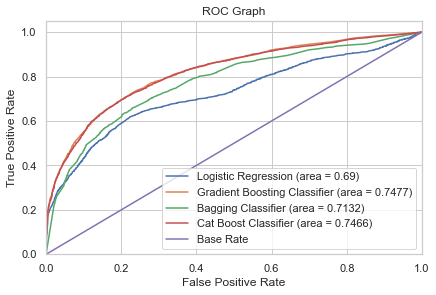

In [262]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


 
gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)


# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

---

<br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:3
        <br><br>


<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

In [263]:
scenario_3[scenario_3['diabetetic'] == 1].shape

(14044, 11)

In [264]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_3_sample_class_1 = scenario_3[scenario_3['diabetetic'] == 1]
scenario_3_sample_class_0 = scenario_3[scenario_3['diabetetic'] == 0][:14044]


df = scenario_3_sample_class_1.append(scenario_3_sample_class_0)

In [265]:

y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [266]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [267]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.641701122268163
F1-ScoreGradient Boosting Classifier: 0.7422190052734982
F1-ScoreBagging Classifier : 0.7282539682539684
Learning rate set to 0.035609
0:	learn: 0.6802680	total: 8.82ms	remaining: 8.81s
1:	learn: 0.6683661	total: 19.6ms	remaining: 9.77s
2:	learn: 0.6580079	total: 31.1ms	remaining: 10.3s
3:	learn: 0.6486422	total: 41.1ms	remaining: 10.2s
4:	learn: 0.6400217	total: 49.1ms	remaining: 9.77s
5:	learn: 0.6319672	total: 57.8ms	remaining: 9.57s
6:	learn: 0.6249971	total: 70.2ms	remaining: 9.96s
7:	learn: 0.6180618	total: 78.4ms	remaining: 9.72s
8:	learn: 0.6121170	total: 86.6ms	remaining: 9.53s
9:	learn: 0.6067678	total: 95.2ms	remaining: 9.43s
10:	learn: 0.6015820	total: 106ms	remaining: 9.54s
11:	learn: 0.5968823	total: 114ms	remaining: 9.41s
12:	learn: 0.5927003	total: 122ms	remaining: 9.3s
13:	learn: 0.5884925	total: 131ms	remaining: 9.2s
14:	learn: 0.5843313	total: 139ms	remaining: 9.15s
15:	learn: 0.5806058	total: 147ms	remaining: 9.06s
16:	

159:	learn: 0.5178022	total: 1.46s	remaining: 7.64s
160:	learn: 0.5177951	total: 1.46s	remaining: 7.63s
161:	learn: 0.5177602	total: 1.47s	remaining: 7.61s
162:	learn: 0.5177247	total: 1.48s	remaining: 7.61s
163:	learn: 0.5176713	total: 1.49s	remaining: 7.6s
164:	learn: 0.5176563	total: 1.5s	remaining: 7.6s
165:	learn: 0.5176383	total: 1.51s	remaining: 7.59s
166:	learn: 0.5176084	total: 1.52s	remaining: 7.58s
167:	learn: 0.5175667	total: 1.53s	remaining: 7.58s
168:	learn: 0.5175276	total: 1.54s	remaining: 7.57s
169:	learn: 0.5175223	total: 1.55s	remaining: 7.55s
170:	learn: 0.5175082	total: 1.55s	remaining: 7.54s
171:	learn: 0.5174934	total: 1.56s	remaining: 7.53s
172:	learn: 0.5174798	total: 1.57s	remaining: 7.51s
173:	learn: 0.5174787	total: 1.58s	remaining: 7.49s
174:	learn: 0.5174597	total: 1.59s	remaining: 7.49s
175:	learn: 0.5174350	total: 1.6s	remaining: 7.49s
176:	learn: 0.5174188	total: 1.61s	remaining: 7.48s
177:	learn: 0.5174068	total: 1.62s	remaining: 7.47s
178:	learn: 0.51

330:	learn: 0.5141439	total: 3.09s	remaining: 6.25s
331:	learn: 0.5141200	total: 3.1s	remaining: 6.24s
332:	learn: 0.5140788	total: 3.11s	remaining: 6.23s
333:	learn: 0.5140527	total: 3.12s	remaining: 6.23s
334:	learn: 0.5140331	total: 3.13s	remaining: 6.22s
335:	learn: 0.5139888	total: 3.14s	remaining: 6.21s
336:	learn: 0.5139647	total: 3.15s	remaining: 6.2s
337:	learn: 0.5139439	total: 3.16s	remaining: 6.19s
338:	learn: 0.5139104	total: 3.17s	remaining: 6.18s
339:	learn: 0.5138931	total: 3.18s	remaining: 6.17s
340:	learn: 0.5138670	total: 3.19s	remaining: 6.17s
341:	learn: 0.5138363	total: 3.2s	remaining: 6.16s
342:	learn: 0.5138020	total: 3.21s	remaining: 6.15s
343:	learn: 0.5137687	total: 3.22s	remaining: 6.14s
344:	learn: 0.5137405	total: 3.23s	remaining: 6.13s
345:	learn: 0.5137134	total: 3.24s	remaining: 6.12s
346:	learn: 0.5136855	total: 3.25s	remaining: 6.11s
347:	learn: 0.5136631	total: 3.26s	remaining: 6.1s
348:	learn: 0.5136286	total: 3.27s	remaining: 6.09s
349:	learn: 0.51

494:	learn: 0.5109191	total: 4.72s	remaining: 4.82s
495:	learn: 0.5109064	total: 4.73s	remaining: 4.81s
496:	learn: 0.5109017	total: 4.74s	remaining: 4.8s
497:	learn: 0.5108612	total: 4.75s	remaining: 4.79s
498:	learn: 0.5108408	total: 4.76s	remaining: 4.78s
499:	learn: 0.5108255	total: 4.77s	remaining: 4.77s
500:	learn: 0.5108195	total: 4.78s	remaining: 4.76s
501:	learn: 0.5108126	total: 4.79s	remaining: 4.75s
502:	learn: 0.5107911	total: 4.8s	remaining: 4.74s
503:	learn: 0.5107862	total: 4.81s	remaining: 4.73s
504:	learn: 0.5107672	total: 4.82s	remaining: 4.72s
505:	learn: 0.5107558	total: 4.83s	remaining: 4.71s
506:	learn: 0.5107446	total: 4.83s	remaining: 4.7s
507:	learn: 0.5107380	total: 4.84s	remaining: 4.69s
508:	learn: 0.5107216	total: 4.85s	remaining: 4.68s
509:	learn: 0.5107073	total: 4.87s	remaining: 4.67s
510:	learn: 0.5106971	total: 4.88s	remaining: 4.67s
511:	learn: 0.5106766	total: 4.89s	remaining: 4.66s
512:	learn: 0.5106591	total: 4.9s	remaining: 4.65s
513:	learn: 0.51

661:	learn: 0.5089285	total: 6.35s	remaining: 3.24s
662:	learn: 0.5089200	total: 6.36s	remaining: 3.23s
663:	learn: 0.5089086	total: 6.37s	remaining: 3.22s
664:	learn: 0.5088960	total: 6.38s	remaining: 3.21s
665:	learn: 0.5088913	total: 6.39s	remaining: 3.2s
666:	learn: 0.5088796	total: 6.4s	remaining: 3.19s
667:	learn: 0.5088707	total: 6.41s	remaining: 3.19s
668:	learn: 0.5088491	total: 6.42s	remaining: 3.17s
669:	learn: 0.5088426	total: 6.43s	remaining: 3.17s
670:	learn: 0.5088274	total: 6.44s	remaining: 3.15s
671:	learn: 0.5088123	total: 6.45s	remaining: 3.15s
672:	learn: 0.5088045	total: 6.45s	remaining: 3.14s
673:	learn: 0.5088026	total: 6.46s	remaining: 3.13s
674:	learn: 0.5087994	total: 6.47s	remaining: 3.12s
675:	learn: 0.5087944	total: 6.48s	remaining: 3.11s
676:	learn: 0.5087906	total: 6.49s	remaining: 3.1s
677:	learn: 0.5087614	total: 6.5s	remaining: 3.09s
678:	learn: 0.5087549	total: 6.51s	remaining: 3.08s
679:	learn: 0.5087402	total: 6.52s	remaining: 3.07s
680:	learn: 0.50

825:	learn: 0.5073086	total: 7.97s	remaining: 1.68s
826:	learn: 0.5072999	total: 7.98s	remaining: 1.67s
827:	learn: 0.5072974	total: 7.99s	remaining: 1.66s
828:	learn: 0.5072828	total: 8s	remaining: 1.65s
829:	learn: 0.5072766	total: 8.01s	remaining: 1.64s
830:	learn: 0.5072616	total: 8.02s	remaining: 1.63s
831:	learn: 0.5072530	total: 8.03s	remaining: 1.62s
832:	learn: 0.5072421	total: 8.04s	remaining: 1.61s
833:	learn: 0.5072360	total: 8.05s	remaining: 1.6s
834:	learn: 0.5072216	total: 8.06s	remaining: 1.59s
835:	learn: 0.5072139	total: 8.07s	remaining: 1.58s
836:	learn: 0.5072081	total: 8.08s	remaining: 1.57s
837:	learn: 0.5072024	total: 8.09s	remaining: 1.56s
838:	learn: 0.5071960	total: 8.1s	remaining: 1.55s
839:	learn: 0.5071925	total: 8.11s	remaining: 1.54s
840:	learn: 0.5071759	total: 8.13s	remaining: 1.54s
841:	learn: 0.5071623	total: 8.14s	remaining: 1.53s
842:	learn: 0.5071582	total: 8.15s	remaining: 1.52s
843:	learn: 0.5071508	total: 8.16s	remaining: 1.51s
844:	learn: 0.507

987:	learn: 0.5060571	total: 9.61s	remaining: 117ms
988:	learn: 0.5060548	total: 9.61s	remaining: 107ms
989:	learn: 0.5060477	total: 9.62s	remaining: 97.2ms
990:	learn: 0.5060386	total: 9.63s	remaining: 87.5ms
991:	learn: 0.5060359	total: 9.64s	remaining: 77.8ms
992:	learn: 0.5060280	total: 9.65s	remaining: 68.1ms
993:	learn: 0.5060264	total: 9.66s	remaining: 58.3ms
994:	learn: 0.5060216	total: 9.68s	remaining: 48.6ms
995:	learn: 0.5060145	total: 9.69s	remaining: 38.9ms
996:	learn: 0.5060124	total: 9.7s	remaining: 29.2ms
997:	learn: 0.5060024	total: 9.71s	remaining: 19.5ms
998:	learn: 0.5060007	total: 9.72s	remaining: 9.73ms
999:	learn: 0.5059943	total: 9.73s	remaining: 0us
F1-ScoreCat Boost Classifier: 0.7363911816947029


Learning rate set to 0.035609
0:	learn: 0.6802680	total: 9.23ms	remaining: 9.22s
1:	learn: 0.6683661	total: 17.6ms	remaining: 8.77s
2:	learn: 0.6580079	total: 26.6ms	remaining: 8.84s
3:	learn: 0.6486422	total: 40.9ms	remaining: 10.2s
4:	learn: 0.6400217	total: 49ms	remaining: 9.76s
5:	learn: 0.6319672	total: 57.7ms	remaining: 9.55s
6:	learn: 0.6249971	total: 66.2ms	remaining: 9.39s
7:	learn: 0.6180618	total: 75.7ms	remaining: 9.39s
8:	learn: 0.6121170	total: 84.9ms	remaining: 9.34s
9:	learn: 0.6067678	total: 93.9ms	remaining: 9.29s
10:	learn: 0.6015820	total: 103ms	remaining: 9.25s
11:	learn: 0.5968823	total: 112ms	remaining: 9.18s
12:	learn: 0.5927003	total: 120ms	remaining: 9.13s
13:	learn: 0.5884925	total: 129ms	remaining: 9.07s
14:	learn: 0.5843313	total: 137ms	remaining: 8.99s
15:	learn: 0.5806058	total: 145ms	remaining: 8.9s
16:	learn: 0.5771791	total: 153ms	remaining: 8.84s
17:	learn: 0.5738293	total: 161ms	remaining: 8.8s
18:	learn: 0.5707179	total: 170ms	remaining: 8.77s
19:	l

175:	learn: 0.5174350	total: 1.64s	remaining: 7.69s
176:	learn: 0.5174188	total: 1.65s	remaining: 7.68s
177:	learn: 0.5174068	total: 1.66s	remaining: 7.67s
178:	learn: 0.5173809	total: 1.67s	remaining: 7.66s
179:	learn: 0.5173736	total: 1.68s	remaining: 7.64s
180:	learn: 0.5173558	total: 1.69s	remaining: 7.63s
181:	learn: 0.5173261	total: 1.69s	remaining: 7.62s
182:	learn: 0.5173251	total: 1.7s	remaining: 7.59s
183:	learn: 0.5172991	total: 1.71s	remaining: 7.58s
184:	learn: 0.5172737	total: 1.72s	remaining: 7.57s
185:	learn: 0.5172644	total: 1.73s	remaining: 7.56s
186:	learn: 0.5172439	total: 1.74s	remaining: 7.55s
187:	learn: 0.5172165	total: 1.75s	remaining: 7.55s
188:	learn: 0.5172134	total: 1.75s	remaining: 7.53s
189:	learn: 0.5171935	total: 1.76s	remaining: 7.52s
190:	learn: 0.5171477	total: 1.77s	remaining: 7.51s
191:	learn: 0.5171470	total: 1.78s	remaining: 7.49s
192:	learn: 0.5171332	total: 1.79s	remaining: 7.48s
193:	learn: 0.5171244	total: 1.8s	remaining: 7.47s
194:	learn: 0.

350:	learn: 0.5135754	total: 3.27s	remaining: 6.04s
351:	learn: 0.5135410	total: 3.27s	remaining: 6.03s
352:	learn: 0.5135108	total: 3.29s	remaining: 6.02s
353:	learn: 0.5134876	total: 3.29s	remaining: 6.01s
354:	learn: 0.5134702	total: 3.3s	remaining: 6s
355:	learn: 0.5134563	total: 3.32s	remaining: 6s
356:	learn: 0.5134205	total: 3.33s	remaining: 6s
357:	learn: 0.5134057	total: 3.34s	remaining: 5.99s
358:	learn: 0.5133815	total: 3.35s	remaining: 5.99s
359:	learn: 0.5133441	total: 3.36s	remaining: 5.98s
360:	learn: 0.5133201	total: 3.37s	remaining: 5.97s
361:	learn: 0.5133026	total: 3.38s	remaining: 5.96s
362:	learn: 0.5132765	total: 3.39s	remaining: 5.95s
363:	learn: 0.5132661	total: 3.4s	remaining: 5.94s
364:	learn: 0.5132373	total: 3.41s	remaining: 5.93s
365:	learn: 0.5132170	total: 3.42s	remaining: 5.92s
366:	learn: 0.5131966	total: 3.43s	remaining: 5.91s
367:	learn: 0.5131925	total: 3.44s	remaining: 5.9s
368:	learn: 0.5131775	total: 3.44s	remaining: 5.89s
369:	learn: 0.5131534	to

516:	learn: 0.5105982	total: 4.89s	remaining: 4.57s
517:	learn: 0.5105828	total: 4.9s	remaining: 4.56s
518:	learn: 0.5105687	total: 4.91s	remaining: 4.55s
519:	learn: 0.5105544	total: 4.92s	remaining: 4.54s
520:	learn: 0.5105482	total: 4.93s	remaining: 4.53s
521:	learn: 0.5105430	total: 4.94s	remaining: 4.52s
522:	learn: 0.5105246	total: 4.95s	remaining: 4.51s
523:	learn: 0.5104962	total: 4.96s	remaining: 4.5s
524:	learn: 0.5104845	total: 4.97s	remaining: 4.49s
525:	learn: 0.5104778	total: 4.98s	remaining: 4.49s
526:	learn: 0.5104672	total: 4.99s	remaining: 4.48s
527:	learn: 0.5104408	total: 5s	remaining: 4.47s
528:	learn: 0.5104393	total: 5.01s	remaining: 4.46s
529:	learn: 0.5104197	total: 5.02s	remaining: 4.45s
530:	learn: 0.5104018	total: 5.03s	remaining: 4.44s
531:	learn: 0.5103905	total: 5.03s	remaining: 4.43s
532:	learn: 0.5103531	total: 5.05s	remaining: 4.42s
533:	learn: 0.5103414	total: 5.05s	remaining: 4.41s
534:	learn: 0.5103325	total: 5.06s	remaining: 4.4s
535:	learn: 0.5103

683:	learn: 0.5086967	total: 6.52s	remaining: 3.01s
684:	learn: 0.5086811	total: 6.53s	remaining: 3s
685:	learn: 0.5086703	total: 6.54s	remaining: 2.99s
686:	learn: 0.5086585	total: 6.54s	remaining: 2.98s
687:	learn: 0.5086566	total: 6.55s	remaining: 2.97s
688:	learn: 0.5086456	total: 6.56s	remaining: 2.96s
689:	learn: 0.5086239	total: 6.57s	remaining: 2.95s
690:	learn: 0.5086144	total: 6.58s	remaining: 2.94s
691:	learn: 0.5086130	total: 6.59s	remaining: 2.93s
692:	learn: 0.5086040	total: 6.6s	remaining: 2.92s
693:	learn: 0.5085895	total: 6.61s	remaining: 2.91s
694:	learn: 0.5085772	total: 6.62s	remaining: 2.9s
695:	learn: 0.5085441	total: 6.63s	remaining: 2.9s
696:	learn: 0.5085309	total: 6.64s	remaining: 2.89s
697:	learn: 0.5085159	total: 6.66s	remaining: 2.88s
698:	learn: 0.5085043	total: 6.67s	remaining: 2.87s
699:	learn: 0.5084959	total: 6.67s	remaining: 2.86s
700:	learn: 0.5084848	total: 6.68s	remaining: 2.85s
701:	learn: 0.5084711	total: 6.69s	remaining: 2.84s
702:	learn: 0.5084

851:	learn: 0.5070665	total: 8.14s	remaining: 1.41s
852:	learn: 0.5070623	total: 8.15s	remaining: 1.4s
853:	learn: 0.5070530	total: 8.15s	remaining: 1.39s
854:	learn: 0.5070502	total: 8.16s	remaining: 1.38s
855:	learn: 0.5070360	total: 8.17s	remaining: 1.38s
856:	learn: 0.5070277	total: 8.18s	remaining: 1.36s
857:	learn: 0.5070202	total: 8.19s	remaining: 1.35s
858:	learn: 0.5070151	total: 8.2s	remaining: 1.35s
859:	learn: 0.5069972	total: 8.21s	remaining: 1.34s
860:	learn: 0.5069928	total: 8.22s	remaining: 1.33s
861:	learn: 0.5069843	total: 8.23s	remaining: 1.32s
862:	learn: 0.5069760	total: 8.24s	remaining: 1.31s
863:	learn: 0.5069657	total: 8.25s	remaining: 1.3s
864:	learn: 0.5069531	total: 8.26s	remaining: 1.29s
865:	learn: 0.5069325	total: 8.27s	remaining: 1.28s
866:	learn: 0.5069223	total: 8.28s	remaining: 1.27s
867:	learn: 0.5069205	total: 8.29s	remaining: 1.26s
868:	learn: 0.5069166	total: 8.3s	remaining: 1.25s
869:	learn: 0.5069136	total: 8.31s	remaining: 1.24s
870:	learn: 0.50

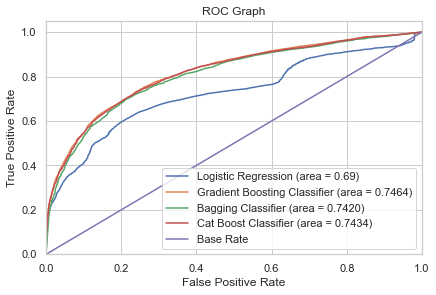

In [268]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)

# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

---

<br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:4
        <br><br>


<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

### Split,  scale, resample the data and apply models

In [269]:
scenario_4[scenario_4['diabetetic'] == 1].shape

(11801, 11)

In [270]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_4_sample_class_1 = scenario_4[scenario_4['diabetetic'] == 1]
scenario_4_sample_class_0 = scenario_4[scenario_4['diabetetic'] == 0][:11801]


df = scenario_4_sample_class_1.append(scenario_4_sample_class_0)

In [271]:

y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [272]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [273]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.6780665140702842
F1-ScoreGradient Boosting Classifier: 0.7460736273401182
F1-ScoreBagging Classifier : 0.7459230673471927
Learning rate set to 0.033059
0:	learn: 0.6797827	total: 8.25ms	remaining: 8.25s
1:	learn: 0.6670978	total: 16.6ms	remaining: 8.28s
2:	learn: 0.6554737	total: 24.7ms	remaining: 8.21s
3:	learn: 0.6456386	total: 37.7ms	remaining: 9.39s
4:	learn: 0.6364448	total: 47.3ms	remaining: 9.41s
5:	learn: 0.6283016	total: 56.6ms	remaining: 9.37s
6:	learn: 0.6209512	total: 64.3ms	remaining: 9.12s
7:	learn: 0.6133794	total: 76.3ms	remaining: 9.46s
8:	learn: 0.6064137	total: 84.1ms	remaining: 9.26s
9:	learn: 0.6009768	total: 91.7ms	remaining: 9.07s
10:	learn: 0.5949297	total: 100ms	remaining: 9s
11:	learn: 0.5894491	total: 112ms	remaining: 9.23s
12:	learn: 0.5841018	total: 121ms	remaining: 9.19s
13:	learn: 0.5794195	total: 130ms	remaining: 9.16s
14:	learn: 0.5746029	total: 139ms	remaining: 9.12s
15:	learn: 0.5706235	total: 152ms	remaining: 9.33s
16:	

173:	learn: 0.5009567	total: 1.49s	remaining: 7.06s
174:	learn: 0.5009468	total: 1.49s	remaining: 7.04s
175:	learn: 0.5009313	total: 1.5s	remaining: 7.04s
176:	learn: 0.5009162	total: 1.51s	remaining: 7.02s
177:	learn: 0.5009126	total: 1.52s	remaining: 7.01s
178:	learn: 0.5008842	total: 1.53s	remaining: 7s
179:	learn: 0.5008490	total: 1.53s	remaining: 6.99s
180:	learn: 0.5008248	total: 1.54s	remaining: 6.98s
181:	learn: 0.5008082	total: 1.56s	remaining: 7s
182:	learn: 0.5007960	total: 1.57s	remaining: 7s
183:	learn: 0.5007726	total: 1.58s	remaining: 6.99s
184:	learn: 0.5007382	total: 1.59s	remaining: 7s
185:	learn: 0.5007246	total: 1.6s	remaining: 7.01s
186:	learn: 0.5006930	total: 1.61s	remaining: 7.01s
187:	learn: 0.5006897	total: 1.62s	remaining: 6.99s
188:	learn: 0.5006818	total: 1.63s	remaining: 7.01s
189:	learn: 0.5006606	total: 1.64s	remaining: 7.01s
190:	learn: 0.5006325	total: 1.65s	remaining: 7s
191:	learn: 0.5005778	total: 1.66s	remaining: 7s
192:	learn: 0.5005454	total: 1.6

332:	learn: 0.4977361	total: 2.93s	remaining: 5.86s
333:	learn: 0.4977232	total: 2.94s	remaining: 5.85s
334:	learn: 0.4977011	total: 2.94s	remaining: 5.85s
335:	learn: 0.4976560	total: 2.96s	remaining: 5.84s
336:	learn: 0.4976285	total: 2.96s	remaining: 5.83s
337:	learn: 0.4976023	total: 2.97s	remaining: 5.83s
338:	learn: 0.4975841	total: 2.98s	remaining: 5.82s
339:	learn: 0.4975651	total: 2.99s	remaining: 5.81s
340:	learn: 0.4975486	total: 3s	remaining: 5.8s
341:	learn: 0.4975299	total: 3.01s	remaining: 5.79s
342:	learn: 0.4975183	total: 3.02s	remaining: 5.78s
343:	learn: 0.4974983	total: 3.03s	remaining: 5.77s
344:	learn: 0.4974794	total: 3.04s	remaining: 5.76s
345:	learn: 0.4974585	total: 3.04s	remaining: 5.76s
346:	learn: 0.4974238	total: 3.05s	remaining: 5.75s
347:	learn: 0.4974116	total: 3.06s	remaining: 5.74s
348:	learn: 0.4973816	total: 3.07s	remaining: 5.73s
349:	learn: 0.4973765	total: 3.08s	remaining: 5.72s
350:	learn: 0.4973669	total: 3.09s	remaining: 5.71s
351:	learn: 0.49

509:	learn: 0.4942078	total: 4.55s	remaining: 4.38s
510:	learn: 0.4941973	total: 4.56s	remaining: 4.37s
511:	learn: 0.4941939	total: 4.57s	remaining: 4.36s
512:	learn: 0.4941756	total: 4.58s	remaining: 4.35s
513:	learn: 0.4941573	total: 4.59s	remaining: 4.34s
514:	learn: 0.4941386	total: 4.6s	remaining: 4.33s
515:	learn: 0.4941331	total: 4.61s	remaining: 4.32s
516:	learn: 0.4941224	total: 4.62s	remaining: 4.31s
517:	learn: 0.4941148	total: 4.62s	remaining: 4.3s
518:	learn: 0.4940967	total: 4.63s	remaining: 4.29s
519:	learn: 0.4940838	total: 4.64s	remaining: 4.28s
520:	learn: 0.4940687	total: 4.65s	remaining: 4.28s
521:	learn: 0.4940558	total: 4.66s	remaining: 4.27s
522:	learn: 0.4940409	total: 4.67s	remaining: 4.26s
523:	learn: 0.4940375	total: 4.68s	remaining: 4.25s
524:	learn: 0.4940177	total: 4.69s	remaining: 4.24s
525:	learn: 0.4940116	total: 4.7s	remaining: 4.23s
526:	learn: 0.4939945	total: 4.71s	remaining: 4.23s
527:	learn: 0.4939764	total: 4.72s	remaining: 4.22s
528:	learn: 0.4

684:	learn: 0.4920087	total: 6.17s	remaining: 2.84s
685:	learn: 0.4919969	total: 6.18s	remaining: 2.83s
686:	learn: 0.4919918	total: 6.19s	remaining: 2.82s
687:	learn: 0.4919875	total: 6.2s	remaining: 2.81s
688:	learn: 0.4919700	total: 6.21s	remaining: 2.8s
689:	learn: 0.4919624	total: 6.22s	remaining: 2.79s
690:	learn: 0.4919554	total: 6.23s	remaining: 2.78s
691:	learn: 0.4919459	total: 6.24s	remaining: 2.77s
692:	learn: 0.4919177	total: 6.25s	remaining: 2.77s
693:	learn: 0.4919067	total: 6.25s	remaining: 2.76s
694:	learn: 0.4918989	total: 6.27s	remaining: 2.75s
695:	learn: 0.4918861	total: 6.28s	remaining: 2.74s
696:	learn: 0.4918757	total: 6.28s	remaining: 2.73s
697:	learn: 0.4918708	total: 6.29s	remaining: 2.72s
698:	learn: 0.4918545	total: 6.3s	remaining: 2.71s
699:	learn: 0.4918400	total: 6.31s	remaining: 2.71s
700:	learn: 0.4918341	total: 6.32s	remaining: 2.7s
701:	learn: 0.4918298	total: 6.34s	remaining: 2.69s
702:	learn: 0.4918175	total: 6.35s	remaining: 2.68s
703:	learn: 0.49

858:	learn: 0.4904268	total: 7.79s	remaining: 1.28s
859:	learn: 0.4904212	total: 7.8s	remaining: 1.27s
860:	learn: 0.4904087	total: 7.81s	remaining: 1.26s
861:	learn: 0.4904051	total: 7.82s	remaining: 1.25s
862:	learn: 0.4903983	total: 7.83s	remaining: 1.24s
863:	learn: 0.4903860	total: 7.84s	remaining: 1.23s
864:	learn: 0.4903845	total: 7.85s	remaining: 1.22s
865:	learn: 0.4903708	total: 7.86s	remaining: 1.22s
866:	learn: 0.4903592	total: 7.87s	remaining: 1.21s
867:	learn: 0.4903492	total: 7.87s	remaining: 1.2s
868:	learn: 0.4903355	total: 7.88s	remaining: 1.19s
869:	learn: 0.4903228	total: 7.89s	remaining: 1.18s
870:	learn: 0.4903181	total: 7.9s	remaining: 1.17s
871:	learn: 0.4903167	total: 7.91s	remaining: 1.16s
872:	learn: 0.4902983	total: 7.92s	remaining: 1.15s
873:	learn: 0.4902906	total: 7.94s	remaining: 1.14s
874:	learn: 0.4902851	total: 7.95s	remaining: 1.14s
875:	learn: 0.4902764	total: 7.96s	remaining: 1.13s
876:	learn: 0.4902683	total: 7.97s	remaining: 1.12s
877:	learn: 0.4

Learning rate set to 0.033059
0:	learn: 0.6797827	total: 8.07ms	remaining: 8.06s
1:	learn: 0.6670978	total: 18.2ms	remaining: 9.1s
2:	learn: 0.6554737	total: 26.9ms	remaining: 8.93s
3:	learn: 0.6456386	total: 38.3ms	remaining: 9.53s
4:	learn: 0.6364448	total: 46.6ms	remaining: 9.28s
5:	learn: 0.6283016	total: 55.3ms	remaining: 9.16s
6:	learn: 0.6209512	total: 63.3ms	remaining: 8.98s
7:	learn: 0.6133794	total: 71.6ms	remaining: 8.88s
8:	learn: 0.6064137	total: 80.3ms	remaining: 8.84s
9:	learn: 0.6009768	total: 89ms	remaining: 8.81s
10:	learn: 0.5949297	total: 100ms	remaining: 8.99s
11:	learn: 0.5894491	total: 109ms	remaining: 8.97s
12:	learn: 0.5841018	total: 119ms	remaining: 9.06s
13:	learn: 0.5794195	total: 129ms	remaining: 9.08s
14:	learn: 0.5746029	total: 138ms	remaining: 9.04s
15:	learn: 0.5706235	total: 146ms	remaining: 9s
16:	learn: 0.5668831	total: 154ms	remaining: 8.93s
17:	learn: 0.5632459	total: 163ms	remaining: 8.9s
18:	learn: 0.5597612	total: 171ms	remaining: 8.82s
19:	lear

166:	learn: 0.5011632	total: 1.45s	remaining: 7.24s
167:	learn: 0.5011063	total: 1.46s	remaining: 7.23s
168:	learn: 0.5010812	total: 1.47s	remaining: 7.22s
169:	learn: 0.5010567	total: 1.48s	remaining: 7.21s
170:	learn: 0.5010205	total: 1.48s	remaining: 7.2s
171:	learn: 0.5009956	total: 1.49s	remaining: 7.19s
172:	learn: 0.5009678	total: 1.5s	remaining: 7.18s
173:	learn: 0.5009567	total: 1.51s	remaining: 7.17s
174:	learn: 0.5009468	total: 1.52s	remaining: 7.15s
175:	learn: 0.5009313	total: 1.52s	remaining: 7.14s
176:	learn: 0.5009162	total: 1.53s	remaining: 7.12s
177:	learn: 0.5009126	total: 1.54s	remaining: 7.1s
178:	learn: 0.5008842	total: 1.54s	remaining: 7.09s
179:	learn: 0.5008490	total: 1.55s	remaining: 7.08s
180:	learn: 0.5008248	total: 1.56s	remaining: 7.07s
181:	learn: 0.5008082	total: 1.57s	remaining: 7.07s
182:	learn: 0.5007960	total: 1.58s	remaining: 7.06s
183:	learn: 0.5007726	total: 1.59s	remaining: 7.05s
184:	learn: 0.5007382	total: 1.6s	remaining: 7.04s
185:	learn: 0.50

328:	learn: 0.4978115	total: 2.88s	remaining: 5.87s
329:	learn: 0.4977943	total: 2.89s	remaining: 5.87s
330:	learn: 0.4977815	total: 2.9s	remaining: 5.87s
331:	learn: 0.4977591	total: 2.91s	remaining: 5.86s
332:	learn: 0.4977361	total: 2.92s	remaining: 5.85s
333:	learn: 0.4977232	total: 2.93s	remaining: 5.85s
334:	learn: 0.4977011	total: 2.94s	remaining: 5.84s
335:	learn: 0.4976560	total: 2.95s	remaining: 5.83s
336:	learn: 0.4976285	total: 2.96s	remaining: 5.82s
337:	learn: 0.4976023	total: 2.97s	remaining: 5.81s
338:	learn: 0.4975841	total: 2.98s	remaining: 5.8s
339:	learn: 0.4975651	total: 2.99s	remaining: 5.8s
340:	learn: 0.4975486	total: 2.99s	remaining: 5.79s
341:	learn: 0.4975299	total: 3s	remaining: 5.78s
342:	learn: 0.4975183	total: 3.01s	remaining: 5.77s
343:	learn: 0.4974983	total: 3.02s	remaining: 5.76s
344:	learn: 0.4974794	total: 3.03s	remaining: 5.76s
345:	learn: 0.4974585	total: 3.04s	remaining: 5.75s
346:	learn: 0.4974238	total: 3.05s	remaining: 5.74s
347:	learn: 0.4974

502:	learn: 0.4943431	total: 4.5s	remaining: 4.45s
503:	learn: 0.4943282	total: 4.51s	remaining: 4.44s
504:	learn: 0.4943122	total: 4.53s	remaining: 4.44s
505:	learn: 0.4942930	total: 4.54s	remaining: 4.43s
506:	learn: 0.4942771	total: 4.54s	remaining: 4.42s
507:	learn: 0.4942396	total: 4.55s	remaining: 4.41s
508:	learn: 0.4942349	total: 4.56s	remaining: 4.4s
509:	learn: 0.4942078	total: 4.57s	remaining: 4.39s
510:	learn: 0.4941973	total: 4.58s	remaining: 4.39s
511:	learn: 0.4941939	total: 4.59s	remaining: 4.38s
512:	learn: 0.4941756	total: 4.6s	remaining: 4.37s
513:	learn: 0.4941573	total: 4.61s	remaining: 4.36s
514:	learn: 0.4941386	total: 4.62s	remaining: 4.35s
515:	learn: 0.4941331	total: 4.63s	remaining: 4.34s
516:	learn: 0.4941224	total: 4.64s	remaining: 4.33s
517:	learn: 0.4941148	total: 4.64s	remaining: 4.32s
518:	learn: 0.4940967	total: 4.65s	remaining: 4.31s
519:	learn: 0.4940838	total: 4.66s	remaining: 4.3s
520:	learn: 0.4940687	total: 4.67s	remaining: 4.29s
521:	learn: 0.49

670:	learn: 0.4922107	total: 6.12s	remaining: 3s
671:	learn: 0.4921914	total: 6.13s	remaining: 2.99s
672:	learn: 0.4921835	total: 6.14s	remaining: 2.98s
673:	learn: 0.4921574	total: 6.15s	remaining: 2.98s
674:	learn: 0.4921544	total: 6.16s	remaining: 2.97s
675:	learn: 0.4921473	total: 6.17s	remaining: 2.96s
676:	learn: 0.4921322	total: 6.18s	remaining: 2.95s
677:	learn: 0.4921194	total: 6.2s	remaining: 2.94s
678:	learn: 0.4921015	total: 6.21s	remaining: 2.94s
679:	learn: 0.4920879	total: 6.22s	remaining: 2.93s
680:	learn: 0.4920760	total: 6.23s	remaining: 2.92s
681:	learn: 0.4920626	total: 6.24s	remaining: 2.91s
682:	learn: 0.4920449	total: 6.25s	remaining: 2.9s
683:	learn: 0.4920328	total: 6.26s	remaining: 2.89s
684:	learn: 0.4920087	total: 6.27s	remaining: 2.88s
685:	learn: 0.4919969	total: 6.28s	remaining: 2.88s
686:	learn: 0.4919918	total: 6.29s	remaining: 2.87s
687:	learn: 0.4919875	total: 6.3s	remaining: 2.86s
688:	learn: 0.4919700	total: 6.31s	remaining: 2.85s
689:	learn: 0.4919

844:	learn: 0.4905078	total: 7.74s	remaining: 1.42s
845:	learn: 0.4905054	total: 7.76s	remaining: 1.41s
846:	learn: 0.4904985	total: 7.77s	remaining: 1.4s
847:	learn: 0.4904859	total: 7.78s	remaining: 1.39s
848:	learn: 0.4904823	total: 7.79s	remaining: 1.39s
849:	learn: 0.4904815	total: 7.8s	remaining: 1.38s
850:	learn: 0.4904727	total: 7.81s	remaining: 1.37s
851:	learn: 0.4904698	total: 7.82s	remaining: 1.36s
852:	learn: 0.4904680	total: 7.83s	remaining: 1.35s
853:	learn: 0.4904540	total: 7.83s	remaining: 1.34s
854:	learn: 0.4904461	total: 7.84s	remaining: 1.33s
855:	learn: 0.4904424	total: 7.85s	remaining: 1.32s
856:	learn: 0.4904327	total: 7.86s	remaining: 1.31s
857:	learn: 0.4904276	total: 7.87s	remaining: 1.3s
858:	learn: 0.4904268	total: 7.88s	remaining: 1.29s
859:	learn: 0.4904212	total: 7.89s	remaining: 1.28s
860:	learn: 0.4904087	total: 7.9s	remaining: 1.27s
861:	learn: 0.4904051	total: 7.9s	remaining: 1.26s
862:	learn: 0.4903983	total: 7.91s	remaining: 1.26s
863:	learn: 0.490

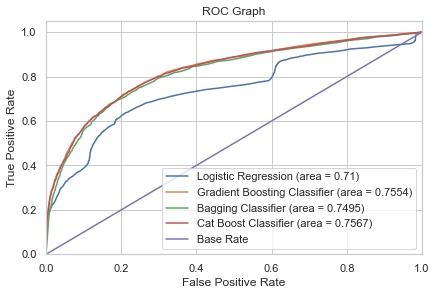

In [274]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)

# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

---

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:5.1
        <br><br>


<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

In [275]:
scenario_5_1[scenario_5_1['diabetetic'] == 1].shape

(14044, 12)

In [276]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_5_1_sample_class_1 = scenario_5_1[scenario_5_1['diabetetic'] == 1]
scenario_5_1_sample_class_0 = scenario_5_1[scenario_5_1['diabetetic'] == 0][:14044]


df = scenario_5_1_sample_class_1.append(scenario_5_1_sample_class_0)

In [277]:
y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [278]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [279]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.6420219676390693
F1-ScoreGradient Boosting Classifier: 0.7417093838267602
F1-ScoreBagging Classifier : 0.7032734952481521
Learning rate set to 0.035609
0:	learn: 0.6800729	total: 8.56ms	remaining: 8.55s
1:	learn: 0.6684993	total: 17.1ms	remaining: 8.54s
2:	learn: 0.6585961	total: 25.5ms	remaining: 8.47s
3:	learn: 0.6491404	total: 35.5ms	remaining: 8.85s
4:	learn: 0.6407877	total: 44.1ms	remaining: 8.77s
5:	learn: 0.6326766	total: 53.2ms	remaining: 8.81s
6:	learn: 0.6254288	total: 63.2ms	remaining: 8.97s
7:	learn: 0.6188845	total: 71.9ms	remaining: 8.91s
8:	learn: 0.6130254	total: 81ms	remaining: 8.91s
9:	learn: 0.6075227	total: 89.6ms	remaining: 8.87s
10:	learn: 0.6021948	total: 100ms	remaining: 9.02s
11:	learn: 0.5976654	total: 110ms	remaining: 9.03s
12:	learn: 0.5932560	total: 119ms	remaining: 9.01s
13:	learn: 0.5890678	total: 129ms	remaining: 9.11s
14:	learn: 0.5847890	total: 138ms	remaining: 9.09s
15:	learn: 0.5808469	total: 147ms	remaining: 9.06s
16:

158:	learn: 0.5155236	total: 1.62s	remaining: 8.57s
159:	learn: 0.5154651	total: 1.63s	remaining: 8.56s
160:	learn: 0.5154026	total: 1.64s	remaining: 8.54s
161:	learn: 0.5153408	total: 1.65s	remaining: 8.53s
162:	learn: 0.5153120	total: 1.66s	remaining: 8.52s
163:	learn: 0.5152934	total: 1.67s	remaining: 8.5s
164:	learn: 0.5152493	total: 1.68s	remaining: 8.48s
165:	learn: 0.5152083	total: 1.69s	remaining: 8.49s
166:	learn: 0.5151439	total: 1.7s	remaining: 8.47s
167:	learn: 0.5151006	total: 1.71s	remaining: 8.46s
168:	learn: 0.5150757	total: 1.72s	remaining: 8.46s
169:	learn: 0.5150342	total: 1.73s	remaining: 8.45s
170:	learn: 0.5149873	total: 1.74s	remaining: 8.43s
171:	learn: 0.5149369	total: 1.75s	remaining: 8.42s
172:	learn: 0.5148779	total: 1.76s	remaining: 8.41s
173:	learn: 0.5148031	total: 1.77s	remaining: 8.4s
174:	learn: 0.5147529	total: 1.78s	remaining: 8.39s
175:	learn: 0.5147422	total: 1.78s	remaining: 8.36s
176:	learn: 0.5146824	total: 1.8s	remaining: 8.35s
177:	learn: 0.51

318:	learn: 0.5091241	total: 3.24s	remaining: 6.92s
319:	learn: 0.5090901	total: 3.25s	remaining: 6.9s
320:	learn: 0.5090386	total: 3.26s	remaining: 6.89s
321:	learn: 0.5089731	total: 3.27s	remaining: 6.88s
322:	learn: 0.5089266	total: 3.28s	remaining: 6.87s
323:	learn: 0.5088728	total: 3.29s	remaining: 6.86s
324:	learn: 0.5088387	total: 3.3s	remaining: 6.85s
325:	learn: 0.5087996	total: 3.31s	remaining: 6.84s
326:	learn: 0.5087463	total: 3.32s	remaining: 6.83s
327:	learn: 0.5086944	total: 3.33s	remaining: 6.82s
328:	learn: 0.5086787	total: 3.34s	remaining: 6.81s
329:	learn: 0.5086204	total: 3.35s	remaining: 6.8s
330:	learn: 0.5085956	total: 3.36s	remaining: 6.79s
331:	learn: 0.5085456	total: 3.37s	remaining: 6.78s
332:	learn: 0.5084903	total: 3.38s	remaining: 6.77s
333:	learn: 0.5084201	total: 3.39s	remaining: 6.76s
334:	learn: 0.5083780	total: 3.4s	remaining: 6.75s
335:	learn: 0.5083393	total: 3.41s	remaining: 6.74s
336:	learn: 0.5083075	total: 3.42s	remaining: 6.72s
337:	learn: 0.50

492:	learn: 0.5020655	total: 5.06s	remaining: 5.21s
493:	learn: 0.5020160	total: 5.07s	remaining: 5.2s
494:	learn: 0.5019783	total: 5.08s	remaining: 5.18s
495:	learn: 0.5019372	total: 5.09s	remaining: 5.17s
496:	learn: 0.5019207	total: 5.1s	remaining: 5.16s
497:	learn: 0.5018720	total: 5.11s	remaining: 5.15s
498:	learn: 0.5018535	total: 5.12s	remaining: 5.14s
499:	learn: 0.5017910	total: 5.13s	remaining: 5.13s
500:	learn: 0.5017453	total: 5.14s	remaining: 5.12s
501:	learn: 0.5016921	total: 5.15s	remaining: 5.11s
502:	learn: 0.5016493	total: 5.16s	remaining: 5.1s
503:	learn: 0.5016330	total: 5.17s	remaining: 5.09s
504:	learn: 0.5015940	total: 5.18s	remaining: 5.08s
505:	learn: 0.5015798	total: 5.19s	remaining: 5.07s
506:	learn: 0.5015344	total: 5.21s	remaining: 5.07s
507:	learn: 0.5015204	total: 5.22s	remaining: 5.06s
508:	learn: 0.5015075	total: 5.23s	remaining: 5.05s
509:	learn: 0.5014543	total: 5.24s	remaining: 5.04s
510:	learn: 0.5014286	total: 5.25s	remaining: 5.03s
511:	learn: 0.5

667:	learn: 0.4964064	total: 6.89s	remaining: 3.42s
668:	learn: 0.4963898	total: 6.9s	remaining: 3.41s
669:	learn: 0.4963629	total: 6.91s	remaining: 3.4s
670:	learn: 0.4963180	total: 6.92s	remaining: 3.39s
671:	learn: 0.4962800	total: 6.93s	remaining: 3.38s
672:	learn: 0.4962630	total: 6.94s	remaining: 3.37s
673:	learn: 0.4962130	total: 6.95s	remaining: 3.36s
674:	learn: 0.4961911	total: 6.96s	remaining: 3.35s
675:	learn: 0.4961605	total: 6.97s	remaining: 3.34s
676:	learn: 0.4961224	total: 6.97s	remaining: 3.33s
677:	learn: 0.4961086	total: 6.99s	remaining: 3.32s
678:	learn: 0.4960973	total: 7s	remaining: 3.31s
679:	learn: 0.4960869	total: 7.01s	remaining: 3.3s
680:	learn: 0.4960555	total: 7.02s	remaining: 3.29s
681:	learn: 0.4960268	total: 7.03s	remaining: 3.28s
682:	learn: 0.4959859	total: 7.04s	remaining: 3.27s
683:	learn: 0.4959379	total: 7.05s	remaining: 3.26s
684:	learn: 0.4959059	total: 7.06s	remaining: 3.25s
685:	learn: 0.4958772	total: 7.07s	remaining: 3.24s
686:	learn: 0.4958

838:	learn: 0.4916357	total: 8.69s	remaining: 1.67s
839:	learn: 0.4916025	total: 8.7s	remaining: 1.66s
840:	learn: 0.4915642	total: 8.71s	remaining: 1.65s
841:	learn: 0.4915312	total: 8.72s	remaining: 1.64s
842:	learn: 0.4914914	total: 8.72s	remaining: 1.63s
843:	learn: 0.4914620	total: 8.73s	remaining: 1.61s
844:	learn: 0.4914008	total: 8.76s	remaining: 1.61s
845:	learn: 0.4913631	total: 8.77s	remaining: 1.6s
846:	learn: 0.4913368	total: 8.78s	remaining: 1.59s
847:	learn: 0.4912967	total: 8.8s	remaining: 1.58s
848:	learn: 0.4912913	total: 8.81s	remaining: 1.57s
849:	learn: 0.4912604	total: 8.82s	remaining: 1.56s
850:	learn: 0.4912287	total: 8.83s	remaining: 1.54s
851:	learn: 0.4911931	total: 8.84s	remaining: 1.53s
852:	learn: 0.4911670	total: 8.85s	remaining: 1.52s
853:	learn: 0.4911352	total: 8.86s	remaining: 1.51s
854:	learn: 0.4910979	total: 8.87s	remaining: 1.5s
855:	learn: 0.4910823	total: 8.88s	remaining: 1.49s
856:	learn: 0.4910584	total: 8.89s	remaining: 1.48s
857:	learn: 0.49

Learning rate set to 0.035609
0:	learn: 0.6800729	total: 9.39ms	remaining: 9.38s
1:	learn: 0.6684993	total: 18.2ms	remaining: 9.11s
2:	learn: 0.6585961	total: 27ms	remaining: 8.97s
3:	learn: 0.6491404	total: 35.7ms	remaining: 8.88s
4:	learn: 0.6407877	total: 44.1ms	remaining: 8.78s
5:	learn: 0.6326766	total: 52.9ms	remaining: 8.77s
6:	learn: 0.6254288	total: 61.6ms	remaining: 8.74s
7:	learn: 0.6188845	total: 70.6ms	remaining: 8.75s
8:	learn: 0.6130254	total: 79.1ms	remaining: 8.71s
9:	learn: 0.6075227	total: 88ms	remaining: 8.71s
10:	learn: 0.6021948	total: 96.7ms	remaining: 8.69s
11:	learn: 0.5976654	total: 106ms	remaining: 8.7s
12:	learn: 0.5932560	total: 115ms	remaining: 8.7s
13:	learn: 0.5890678	total: 124ms	remaining: 8.76s
14:	learn: 0.5847890	total: 134ms	remaining: 8.81s
15:	learn: 0.5808469	total: 144ms	remaining: 8.84s
16:	learn: 0.5776094	total: 154ms	remaining: 8.89s
17:	learn: 0.5747431	total: 167ms	remaining: 9.1s
18:	learn: 0.5717369	total: 175ms	remaining: 9.03s
19:	lea

171:	learn: 0.5149369	total: 1.63s	remaining: 7.82s
172:	learn: 0.5148779	total: 1.63s	remaining: 7.81s
173:	learn: 0.5148031	total: 1.64s	remaining: 7.8s
174:	learn: 0.5147529	total: 1.65s	remaining: 7.79s
175:	learn: 0.5147422	total: 1.66s	remaining: 7.77s
176:	learn: 0.5146824	total: 1.67s	remaining: 7.76s
177:	learn: 0.5146268	total: 1.68s	remaining: 7.75s
178:	learn: 0.5145745	total: 1.69s	remaining: 7.74s
179:	learn: 0.5145377	total: 1.7s	remaining: 7.75s
180:	learn: 0.5144827	total: 1.71s	remaining: 7.74s
181:	learn: 0.5144027	total: 1.72s	remaining: 7.73s
182:	learn: 0.5143540	total: 1.73s	remaining: 7.73s
183:	learn: 0.5143111	total: 1.74s	remaining: 7.72s
184:	learn: 0.5142530	total: 1.75s	remaining: 7.71s
185:	learn: 0.5142077	total: 1.76s	remaining: 7.7s
186:	learn: 0.5141893	total: 1.77s	remaining: 7.71s
187:	learn: 0.5141582	total: 1.78s	remaining: 7.71s
188:	learn: 0.5141292	total: 1.8s	remaining: 7.71s
189:	learn: 0.5141111	total: 1.81s	remaining: 7.73s
190:	learn: 0.51

336:	learn: 0.5083075	total: 3.25s	remaining: 6.39s
337:	learn: 0.5082760	total: 3.26s	remaining: 6.38s
338:	learn: 0.5082288	total: 3.27s	remaining: 6.37s
339:	learn: 0.5081689	total: 3.28s	remaining: 6.36s
340:	learn: 0.5081195	total: 3.29s	remaining: 6.35s
341:	learn: 0.5080651	total: 3.3s	remaining: 6.34s
342:	learn: 0.5080340	total: 3.31s	remaining: 6.33s
343:	learn: 0.5079912	total: 3.32s	remaining: 6.32s
344:	learn: 0.5079524	total: 3.33s	remaining: 6.32s
345:	learn: 0.5079283	total: 3.34s	remaining: 6.31s
346:	learn: 0.5078731	total: 3.35s	remaining: 6.3s
347:	learn: 0.5078276	total: 3.35s	remaining: 6.29s
348:	learn: 0.5077974	total: 3.37s	remaining: 6.28s
349:	learn: 0.5077547	total: 3.38s	remaining: 6.27s
350:	learn: 0.5076963	total: 3.39s	remaining: 6.26s
351:	learn: 0.5076609	total: 3.4s	remaining: 6.25s
352:	learn: 0.5076159	total: 3.4s	remaining: 6.24s
353:	learn: 0.5075690	total: 3.41s	remaining: 6.23s
354:	learn: 0.5075208	total: 3.42s	remaining: 6.22s
355:	learn: 0.50

497:	learn: 0.5018720	total: 4.89s	remaining: 4.93s
498:	learn: 0.5018535	total: 4.9s	remaining: 4.92s
499:	learn: 0.5017910	total: 4.91s	remaining: 4.91s
500:	learn: 0.5017453	total: 4.92s	remaining: 4.9s
501:	learn: 0.5016921	total: 4.93s	remaining: 4.89s
502:	learn: 0.5016493	total: 4.94s	remaining: 4.88s
503:	learn: 0.5016330	total: 4.95s	remaining: 4.87s
504:	learn: 0.5015940	total: 4.96s	remaining: 4.86s
505:	learn: 0.5015798	total: 4.97s	remaining: 4.85s
506:	learn: 0.5015344	total: 4.98s	remaining: 4.84s
507:	learn: 0.5015204	total: 4.99s	remaining: 4.83s
508:	learn: 0.5015075	total: 5s	remaining: 4.82s
509:	learn: 0.5014543	total: 5.01s	remaining: 4.81s
510:	learn: 0.5014286	total: 5.02s	remaining: 4.8s
511:	learn: 0.5013782	total: 5.03s	remaining: 4.79s
512:	learn: 0.5012966	total: 5.04s	remaining: 4.78s
513:	learn: 0.5012631	total: 5.05s	remaining: 4.77s
514:	learn: 0.5012417	total: 5.06s	remaining: 4.76s
515:	learn: 0.5011916	total: 5.07s	remaining: 4.76s
516:	learn: 0.5011

658:	learn: 0.4966751	total: 6.52s	remaining: 3.38s
659:	learn: 0.4966515	total: 6.54s	remaining: 3.37s
660:	learn: 0.4966244	total: 6.54s	remaining: 3.36s
661:	learn: 0.4965981	total: 6.55s	remaining: 3.35s
662:	learn: 0.4965861	total: 6.56s	remaining: 3.34s
663:	learn: 0.4965570	total: 6.57s	remaining: 3.33s
664:	learn: 0.4965314	total: 6.58s	remaining: 3.32s
665:	learn: 0.4964984	total: 6.59s	remaining: 3.31s
666:	learn: 0.4964395	total: 6.6s	remaining: 3.3s
667:	learn: 0.4964064	total: 6.61s	remaining: 3.29s
668:	learn: 0.4963898	total: 6.62s	remaining: 3.28s
669:	learn: 0.4963629	total: 6.63s	remaining: 3.27s
670:	learn: 0.4963180	total: 6.64s	remaining: 3.26s
671:	learn: 0.4962800	total: 6.65s	remaining: 3.25s
672:	learn: 0.4962630	total: 6.66s	remaining: 3.24s
673:	learn: 0.4962130	total: 6.67s	remaining: 3.23s
674:	learn: 0.4961911	total: 6.68s	remaining: 3.22s
675:	learn: 0.4961605	total: 6.69s	remaining: 3.21s
676:	learn: 0.4961224	total: 6.7s	remaining: 3.2s
677:	learn: 0.49

819:	learn: 0.4920749	total: 8.14s	remaining: 1.79s
820:	learn: 0.4920690	total: 8.15s	remaining: 1.78s
821:	learn: 0.4920377	total: 8.16s	remaining: 1.77s
822:	learn: 0.4920142	total: 8.17s	remaining: 1.76s
823:	learn: 0.4919950	total: 8.18s	remaining: 1.75s
824:	learn: 0.4919590	total: 8.2s	remaining: 1.74s
825:	learn: 0.4919427	total: 8.21s	remaining: 1.73s
826:	learn: 0.4919006	total: 8.22s	remaining: 1.72s
827:	learn: 0.4918845	total: 8.23s	remaining: 1.71s
828:	learn: 0.4918472	total: 8.24s	remaining: 1.7s
829:	learn: 0.4918387	total: 8.25s	remaining: 1.69s
830:	learn: 0.4918217	total: 8.26s	remaining: 1.68s
831:	learn: 0.4918083	total: 8.27s	remaining: 1.67s
832:	learn: 0.4917772	total: 8.28s	remaining: 1.66s
833:	learn: 0.4917357	total: 8.29s	remaining: 1.65s
834:	learn: 0.4917166	total: 8.3s	remaining: 1.64s
835:	learn: 0.4917057	total: 8.31s	remaining: 1.63s
836:	learn: 0.4916699	total: 8.32s	remaining: 1.62s
837:	learn: 0.4916549	total: 8.34s	remaining: 1.61s
838:	learn: 0.4

978:	learn: 0.4880146	total: 9.78s	remaining: 210ms
979:	learn: 0.4880093	total: 9.78s	remaining: 200ms
980:	learn: 0.4879805	total: 9.79s	remaining: 190ms
981:	learn: 0.4879677	total: 9.8s	remaining: 180ms
982:	learn: 0.4879511	total: 9.81s	remaining: 170ms
983:	learn: 0.4879351	total: 9.82s	remaining: 160ms
984:	learn: 0.4879139	total: 9.83s	remaining: 150ms
985:	learn: 0.4878744	total: 9.84s	remaining: 140ms
986:	learn: 0.4878466	total: 9.85s	remaining: 130ms
987:	learn: 0.4878250	total: 9.86s	remaining: 120ms
988:	learn: 0.4877928	total: 9.87s	remaining: 110ms
989:	learn: 0.4877732	total: 9.88s	remaining: 99.8ms
990:	learn: 0.4877486	total: 9.89s	remaining: 89.8ms
991:	learn: 0.4877179	total: 9.9s	remaining: 79.8ms
992:	learn: 0.4876911	total: 9.91s	remaining: 69.8ms
993:	learn: 0.4876599	total: 9.92s	remaining: 59.9ms
994:	learn: 0.4876521	total: 9.93s	remaining: 49.9ms
995:	learn: 0.4876366	total: 9.94s	remaining: 39.9ms
996:	learn: 0.4876233	total: 9.95s	remaining: 29.9ms
997:	l

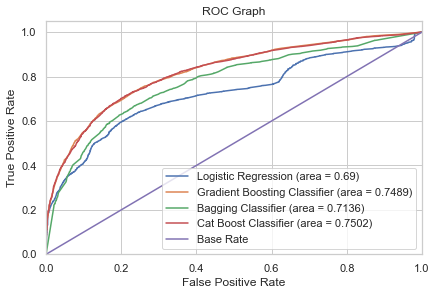

In [280]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)

# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

<br><br>

<br><br>
    <font color='6DB8F4' size='20px'> Scenario:5.2
        <br><br>


<font color='indigo' size='6px'> Rebalance Target Class (Randomly Chosen)

In [281]:
scenario_5_2[scenario_5_2['diabetetic'] == 1].shape

(11801, 12)

In [282]:
# select the same number of rows in case DMIndicator == 1 for case DMIndicator ==0
scenario_5_2_sample_class_1 = scenario_5_2[scenario_5_2['diabetetic'] == 1]
scenario_5_2_sample_class_0 = scenario_5_2[scenario_5_2['diabetetic'] == 0][:14044]


df = scenario_5_2_sample_class_1.append(scenario_5_2_sample_class_0)

In [283]:
y=df.pop('diabetetic')
X=df

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=2, stratify=y)

In [284]:
#Do Scaling for data
ss = StandardScaler()
Xs_train = ss.fit_transform(X_train)
Xs_test = ss.transform(X_test)

In [285]:
for model in models:
    f1_sc = applying_model(models[model], Xs_train, Xs_test, y_train, y_test)
    print(f'F1-Score{ model}: {f1_sc}')

F1-ScoreLogistic Regression: 0.6684413682949555
F1-ScoreGradient Boosting Classifier: 0.7221216041397155
F1-ScoreBagging Classifier : 0.6923664122137404
Learning rate set to 0.034366
0:	learn: 0.6789153	total: 8.48ms	remaining: 8.47s
1:	learn: 0.6656951	total: 16.8ms	remaining: 8.38s
2:	learn: 0.6543093	total: 25.5ms	remaining: 8.47s
3:	learn: 0.6432279	total: 36ms	remaining: 8.97s
4:	learn: 0.6341131	total: 44.4ms	remaining: 8.83s
5:	learn: 0.6248563	total: 52.6ms	remaining: 8.72s
6:	learn: 0.6170478	total: 61.1ms	remaining: 8.67s
7:	learn: 0.6097183	total: 75.4ms	remaining: 9.35s
8:	learn: 0.6031818	total: 83.6ms	remaining: 9.2s
9:	learn: 0.5968018	total: 92.1ms	remaining: 9.12s
10:	learn: 0.5906211	total: 100ms	remaining: 9.03s
11:	learn: 0.5854853	total: 116ms	remaining: 9.52s
12:	learn: 0.5806635	total: 124ms	remaining: 9.43s
13:	learn: 0.5764346	total: 132ms	remaining: 9.32s
14:	learn: 0.5716718	total: 141ms	remaining: 9.24s
15:	learn: 0.5673254	total: 149ms	remaining: 9.16s
16:	

165:	learn: 0.4953887	total: 1.61s	remaining: 8.07s
166:	learn: 0.4953749	total: 1.61s	remaining: 8.05s
167:	learn: 0.4953558	total: 1.62s	remaining: 8.03s
168:	learn: 0.4952974	total: 1.63s	remaining: 8.01s
169:	learn: 0.4952565	total: 1.64s	remaining: 8s
170:	learn: 0.4952129	total: 1.65s	remaining: 7.98s
171:	learn: 0.4951586	total: 1.66s	remaining: 7.97s
172:	learn: 0.4951154	total: 1.66s	remaining: 7.96s
173:	learn: 0.4950648	total: 1.67s	remaining: 7.95s
174:	learn: 0.4950285	total: 1.68s	remaining: 7.93s
175:	learn: 0.4949727	total: 1.69s	remaining: 7.92s
176:	learn: 0.4949537	total: 1.7s	remaining: 7.9s
177:	learn: 0.4949194	total: 1.71s	remaining: 7.89s
178:	learn: 0.4948754	total: 1.72s	remaining: 7.88s
179:	learn: 0.4948450	total: 1.73s	remaining: 7.87s
180:	learn: 0.4947834	total: 1.74s	remaining: 7.85s
181:	learn: 0.4947170	total: 1.75s	remaining: 7.85s
182:	learn: 0.4946725	total: 1.75s	remaining: 7.84s
183:	learn: 0.4946470	total: 1.76s	remaining: 7.83s
184:	learn: 0.494

335:	learn: 0.4888012	total: 3.23s	remaining: 6.38s
336:	learn: 0.4887247	total: 3.24s	remaining: 6.37s
337:	learn: 0.4886873	total: 3.25s	remaining: 6.36s
338:	learn: 0.4886449	total: 3.26s	remaining: 6.35s
339:	learn: 0.4886017	total: 3.27s	remaining: 6.35s
340:	learn: 0.4885705	total: 3.28s	remaining: 6.34s
341:	learn: 0.4885228	total: 3.29s	remaining: 6.33s
342:	learn: 0.4884618	total: 3.3s	remaining: 6.32s
343:	learn: 0.4884425	total: 3.31s	remaining: 6.31s
344:	learn: 0.4884165	total: 3.32s	remaining: 6.3s
345:	learn: 0.4883788	total: 3.33s	remaining: 6.29s
346:	learn: 0.4883293	total: 3.34s	remaining: 6.29s
347:	learn: 0.4882932	total: 3.35s	remaining: 6.28s
348:	learn: 0.4882733	total: 3.36s	remaining: 6.27s
349:	learn: 0.4882294	total: 3.37s	remaining: 6.27s
350:	learn: 0.4881643	total: 3.38s	remaining: 6.26s
351:	learn: 0.4880998	total: 3.4s	remaining: 6.25s
352:	learn: 0.4880409	total: 3.41s	remaining: 6.25s
353:	learn: 0.4879889	total: 3.42s	remaining: 6.24s
354:	learn: 0.4

496:	learn: 0.4824949	total: 4.86s	remaining: 4.92s
497:	learn: 0.4824680	total: 4.87s	remaining: 4.91s
498:	learn: 0.4824243	total: 4.88s	remaining: 4.9s
499:	learn: 0.4824005	total: 4.89s	remaining: 4.89s
500:	learn: 0.4823554	total: 4.9s	remaining: 4.88s
501:	learn: 0.4823180	total: 4.92s	remaining: 4.88s
502:	learn: 0.4822781	total: 4.93s	remaining: 4.87s
503:	learn: 0.4822362	total: 4.94s	remaining: 4.86s
504:	learn: 0.4822075	total: 4.95s	remaining: 4.85s
505:	learn: 0.4821829	total: 4.96s	remaining: 4.84s
506:	learn: 0.4821457	total: 4.97s	remaining: 4.83s
507:	learn: 0.4821231	total: 4.98s	remaining: 4.82s
508:	learn: 0.4820920	total: 4.99s	remaining: 4.82s
509:	learn: 0.4820374	total: 5s	remaining: 4.8s
510:	learn: 0.4820000	total: 5.01s	remaining: 4.79s
511:	learn: 0.4819885	total: 5.02s	remaining: 4.79s
512:	learn: 0.4819580	total: 5.03s	remaining: 4.78s
513:	learn: 0.4819047	total: 5.04s	remaining: 4.77s
514:	learn: 0.4818631	total: 5.05s	remaining: 4.76s
515:	learn: 0.4818

658:	learn: 0.4771090	total: 6.49s	remaining: 3.36s
659:	learn: 0.4770568	total: 6.5s	remaining: 3.35s
660:	learn: 0.4770275	total: 6.5s	remaining: 3.34s
661:	learn: 0.4770018	total: 6.51s	remaining: 3.33s
662:	learn: 0.4769728	total: 6.52s	remaining: 3.31s
663:	learn: 0.4769262	total: 6.53s	remaining: 3.31s
664:	learn: 0.4768887	total: 6.54s	remaining: 3.29s
665:	learn: 0.4768675	total: 6.56s	remaining: 3.29s
666:	learn: 0.4768440	total: 6.57s	remaining: 3.28s
667:	learn: 0.4768058	total: 6.58s	remaining: 3.27s
668:	learn: 0.4767896	total: 6.58s	remaining: 3.26s
669:	learn: 0.4767483	total: 6.59s	remaining: 3.25s
670:	learn: 0.4767209	total: 6.6s	remaining: 3.24s
671:	learn: 0.4766955	total: 6.61s	remaining: 3.23s
672:	learn: 0.4766477	total: 6.62s	remaining: 3.22s
673:	learn: 0.4766049	total: 6.63s	remaining: 3.21s
674:	learn: 0.4765995	total: 6.64s	remaining: 3.2s
675:	learn: 0.4765616	total: 6.65s	remaining: 3.19s
676:	learn: 0.4765395	total: 6.66s	remaining: 3.18s
677:	learn: 0.47

824:	learn: 0.4724041	total: 8.13s	remaining: 1.72s
825:	learn: 0.4723647	total: 8.14s	remaining: 1.71s
826:	learn: 0.4723375	total: 8.15s	remaining: 1.7s
827:	learn: 0.4723050	total: 8.16s	remaining: 1.69s
828:	learn: 0.4722839	total: 8.17s	remaining: 1.68s
829:	learn: 0.4722252	total: 8.18s	remaining: 1.67s
830:	learn: 0.4722007	total: 8.19s	remaining: 1.67s
831:	learn: 0.4721854	total: 8.2s	remaining: 1.66s
832:	learn: 0.4721772	total: 8.21s	remaining: 1.65s
833:	learn: 0.4721357	total: 8.22s	remaining: 1.64s
834:	learn: 0.4721106	total: 8.23s	remaining: 1.63s
835:	learn: 0.4720882	total: 8.23s	remaining: 1.61s
836:	learn: 0.4720855	total: 8.24s	remaining: 1.6s
837:	learn: 0.4720602	total: 8.26s	remaining: 1.6s
838:	learn: 0.4720394	total: 8.27s	remaining: 1.59s
839:	learn: 0.4719852	total: 8.28s	remaining: 1.58s
840:	learn: 0.4719321	total: 8.29s	remaining: 1.57s
841:	learn: 0.4719102	total: 8.29s	remaining: 1.56s
842:	learn: 0.4718923	total: 8.3s	remaining: 1.55s
843:	learn: 0.471

984:	learn: 0.4683481	total: 9.76s	remaining: 149ms
985:	learn: 0.4683044	total: 9.77s	remaining: 139ms
986:	learn: 0.4682642	total: 9.78s	remaining: 129ms
987:	learn: 0.4682328	total: 9.79s	remaining: 119ms
988:	learn: 0.4682199	total: 9.8s	remaining: 109ms
989:	learn: 0.4682081	total: 9.81s	remaining: 99.1ms
990:	learn: 0.4681825	total: 9.82s	remaining: 89.2ms
991:	learn: 0.4681289	total: 9.83s	remaining: 79.3ms
992:	learn: 0.4681076	total: 9.84s	remaining: 69.4ms
993:	learn: 0.4680887	total: 9.85s	remaining: 59.5ms
994:	learn: 0.4680589	total: 9.86s	remaining: 49.6ms
995:	learn: 0.4680179	total: 9.87s	remaining: 39.6ms
996:	learn: 0.4680076	total: 9.88s	remaining: 29.7ms
997:	learn: 0.4680041	total: 9.89s	remaining: 19.8ms
998:	learn: 0.4679821	total: 9.9s	remaining: 9.91ms
999:	learn: 0.4679712	total: 9.91s	remaining: 0us
F1-ScoreCat Boost Classifier: 0.7228142251893697


Learning rate set to 0.034366
0:	learn: 0.6789153	total: 8.33ms	remaining: 8.32s
1:	learn: 0.6656951	total: 16.7ms	remaining: 8.35s
2:	learn: 0.6543093	total: 25ms	remaining: 8.31s
3:	learn: 0.6432279	total: 33.5ms	remaining: 8.33s
4:	learn: 0.6341131	total: 41.6ms	remaining: 8.28s
5:	learn: 0.6248563	total: 50.4ms	remaining: 8.35s
6:	learn: 0.6170478	total: 59ms	remaining: 8.37s
7:	learn: 0.6097183	total: 67.5ms	remaining: 8.37s
8:	learn: 0.6031818	total: 75.9ms	remaining: 8.36s
9:	learn: 0.5968018	total: 84.3ms	remaining: 8.34s
10:	learn: 0.5906211	total: 92.6ms	remaining: 8.33s
11:	learn: 0.5854853	total: 101ms	remaining: 8.32s
12:	learn: 0.5806635	total: 109ms	remaining: 8.31s
13:	learn: 0.5764346	total: 118ms	remaining: 8.31s
14:	learn: 0.5716718	total: 127ms	remaining: 8.32s
15:	learn: 0.5673254	total: 135ms	remaining: 8.32s
16:	learn: 0.5633752	total: 147ms	remaining: 8.5s
17:	learn: 0.5595483	total: 155ms	remaining: 8.47s
18:	learn: 0.5563080	total: 163ms	remaining: 8.44s
19:	l

178:	learn: 0.4948754	total: 1.65s	remaining: 7.57s
179:	learn: 0.4948450	total: 1.66s	remaining: 7.56s
180:	learn: 0.4947834	total: 1.67s	remaining: 7.54s
181:	learn: 0.4947170	total: 1.68s	remaining: 7.54s
182:	learn: 0.4946725	total: 1.69s	remaining: 7.52s
183:	learn: 0.4946470	total: 1.69s	remaining: 7.51s
184:	learn: 0.4946108	total: 1.7s	remaining: 7.5s
185:	learn: 0.4945850	total: 1.71s	remaining: 7.49s
186:	learn: 0.4945773	total: 1.72s	remaining: 7.47s
187:	learn: 0.4945529	total: 1.73s	remaining: 7.46s
188:	learn: 0.4944961	total: 1.74s	remaining: 7.45s
189:	learn: 0.4944550	total: 1.75s	remaining: 7.45s
190:	learn: 0.4944175	total: 1.75s	remaining: 7.44s
191:	learn: 0.4943684	total: 1.76s	remaining: 7.43s
192:	learn: 0.4943350	total: 1.77s	remaining: 7.42s
193:	learn: 0.4942851	total: 1.78s	remaining: 7.41s
194:	learn: 0.4942358	total: 1.79s	remaining: 7.39s
195:	learn: 0.4942175	total: 1.8s	remaining: 7.38s
196:	learn: 0.4941864	total: 1.81s	remaining: 7.39s
197:	learn: 0.4

347:	learn: 0.4882932	total: 3.27s	remaining: 6.12s
348:	learn: 0.4882733	total: 3.27s	remaining: 6.11s
349:	learn: 0.4882294	total: 3.28s	remaining: 6.1s
350:	learn: 0.4881643	total: 3.29s	remaining: 6.09s
351:	learn: 0.4880998	total: 3.3s	remaining: 6.08s
352:	learn: 0.4880409	total: 3.31s	remaining: 6.07s
353:	learn: 0.4879889	total: 3.32s	remaining: 6.06s
354:	learn: 0.4879407	total: 3.33s	remaining: 6.05s
355:	learn: 0.4878986	total: 3.34s	remaining: 6.04s
356:	learn: 0.4878537	total: 3.35s	remaining: 6.03s
357:	learn: 0.4878240	total: 3.36s	remaining: 6.02s
358:	learn: 0.4877937	total: 3.37s	remaining: 6.01s
359:	learn: 0.4877524	total: 3.38s	remaining: 6s
360:	learn: 0.4877248	total: 3.39s	remaining: 6s
361:	learn: 0.4876592	total: 3.4s	remaining: 5.99s
362:	learn: 0.4876166	total: 3.41s	remaining: 5.98s
363:	learn: 0.4875529	total: 3.42s	remaining: 5.97s
364:	learn: 0.4875126	total: 3.42s	remaining: 5.96s
365:	learn: 0.4874689	total: 3.43s	remaining: 5.95s
366:	learn: 0.4874093

514:	learn: 0.4818631	total: 4.92s	remaining: 4.63s
515:	learn: 0.4818414	total: 4.93s	remaining: 4.62s
516:	learn: 0.4818201	total: 4.94s	remaining: 4.61s
517:	learn: 0.4817809	total: 4.95s	remaining: 4.6s
518:	learn: 0.4817380	total: 4.96s	remaining: 4.59s
519:	learn: 0.4817210	total: 4.97s	remaining: 4.58s
520:	learn: 0.4816845	total: 4.98s	remaining: 4.58s
521:	learn: 0.4816650	total: 4.99s	remaining: 4.57s
522:	learn: 0.4816418	total: 5s	remaining: 4.56s
523:	learn: 0.4816011	total: 5.01s	remaining: 4.55s
524:	learn: 0.4815583	total: 5.02s	remaining: 4.54s
525:	learn: 0.4815343	total: 5.03s	remaining: 4.53s
526:	learn: 0.4815280	total: 5.04s	remaining: 4.52s
527:	learn: 0.4814878	total: 5.05s	remaining: 4.51s
528:	learn: 0.4814531	total: 5.06s	remaining: 4.5s
529:	learn: 0.4814184	total: 5.07s	remaining: 4.49s
530:	learn: 0.4814063	total: 5.08s	remaining: 4.48s
531:	learn: 0.4813580	total: 5.09s	remaining: 4.47s
532:	learn: 0.4813225	total: 5.1s	remaining: 4.47s
533:	learn: 0.4812

679:	learn: 0.4764614	total: 6.55s	remaining: 3.08s
680:	learn: 0.4764328	total: 6.56s	remaining: 3.07s
681:	learn: 0.4764191	total: 6.57s	remaining: 3.06s
682:	learn: 0.4763954	total: 6.58s	remaining: 3.05s
683:	learn: 0.4763760	total: 6.59s	remaining: 3.04s
684:	learn: 0.4763443	total: 6.59s	remaining: 3.03s
685:	learn: 0.4763143	total: 6.61s	remaining: 3.02s
686:	learn: 0.4762882	total: 6.62s	remaining: 3.01s
687:	learn: 0.4762566	total: 6.62s	remaining: 3s
688:	learn: 0.4762273	total: 6.63s	remaining: 2.99s
689:	learn: 0.4761888	total: 6.64s	remaining: 2.98s
690:	learn: 0.4761553	total: 6.65s	remaining: 2.97s
691:	learn: 0.4761299	total: 6.66s	remaining: 2.96s
692:	learn: 0.4760987	total: 6.67s	remaining: 2.96s
693:	learn: 0.4760601	total: 6.68s	remaining: 2.94s
694:	learn: 0.4760412	total: 6.69s	remaining: 2.94s
695:	learn: 0.4760119	total: 6.7s	remaining: 2.92s
696:	learn: 0.4759600	total: 6.71s	remaining: 2.92s
697:	learn: 0.4759372	total: 6.72s	remaining: 2.91s
698:	learn: 0.47

843:	learn: 0.4718501	total: 8.18s	remaining: 1.51s
844:	learn: 0.4718170	total: 8.19s	remaining: 1.5s
845:	learn: 0.4718097	total: 8.2s	remaining: 1.49s
846:	learn: 0.4717814	total: 8.2s	remaining: 1.48s
847:	learn: 0.4717466	total: 8.22s	remaining: 1.47s
848:	learn: 0.4716934	total: 8.22s	remaining: 1.46s
849:	learn: 0.4716858	total: 8.23s	remaining: 1.45s
850:	learn: 0.4716610	total: 8.24s	remaining: 1.44s
851:	learn: 0.4716593	total: 8.25s	remaining: 1.43s
852:	learn: 0.4716397	total: 8.26s	remaining: 1.42s
853:	learn: 0.4716120	total: 8.27s	remaining: 1.41s
854:	learn: 0.4715970	total: 8.28s	remaining: 1.4s
855:	learn: 0.4715827	total: 8.29s	remaining: 1.39s
856:	learn: 0.4715671	total: 8.3s	remaining: 1.38s
857:	learn: 0.4715592	total: 8.31s	remaining: 1.38s
858:	learn: 0.4715095	total: 8.32s	remaining: 1.36s
859:	learn: 0.4714933	total: 8.33s	remaining: 1.35s
860:	learn: 0.4714619	total: 8.34s	remaining: 1.34s
861:	learn: 0.4714295	total: 8.35s	remaining: 1.34s
862:	learn: 0.471

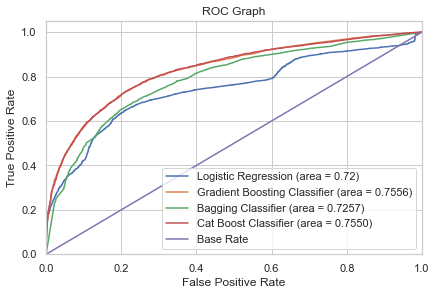

In [286]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
lr_auc = roc_auc_score(y_test, lr.predict(Xs_test))
fpr, tpr, thresholds = roc_curve(y_test, lr.predict_proba(Xs_test)[:,1])


gbc = GradientBoostingClassifier()
gbc.fit(Xs_train, y_train)
gbc_auc = roc_auc_score(y_test, gbc.predict(Xs_test))
gbc_fpr, gbc_tpr, gbc_thresholds = roc_curve(y_test, gbc.predict_proba(Xs_test)[:,1])


bagg = BaggingClassifier()
bagg.fit(Xs_train, y_train)
bagg_auc = roc_auc_score(y_test, bagg.predict(Xs_test))
bagg_fpr, bagg_tpr, bagg_thresholds = roc_curve(y_test, bagg.predict_proba(Xs_test)[:,1])



cat = CatBoostClassifier()
cat.fit(Xs_train, y_train)
cat_auc = roc_auc_score(y_test, cat.predict(Xs_test))
cat_fpr, cat_tpr, cat_thresholds = roc_curve(y_test, cat.predict_proba(Xs_test)[:,1])


plt.figure()

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % lr_auc)


# Plot Decision GBC ROC
plt.plot(gbc_fpr, gbc_tpr, label='Gradient Boosting Classifier (area = %0.4f)' % gbc_auc)

# Plot Decision bagg ROC
plt.plot(bagg_fpr, bagg_tpr, label='Bagging Classifier (area = %0.4f)' % bagg_auc)


# Plot Decision cat ROC
plt.plot(cat_fpr, cat_tpr, label='Cat Boost Classifier (area = %0.4f)' % cat_auc)

# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>

<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 8: Conclusion
        <br><br>

<br><br><br>

To summarize, we can say that height and weight are very important factors to improve the accuracy of the model, as the scenarios that were tested and included these two characteristics gave us a better result that reaches us around `74%` as we recommend `scenario_4` for specific reson, it is more reliable and near to the original data (has fewer cleaning), so we can depend that model for Diabetic prediction in the future. 

Also, the percentage of diabetics in Saudi Arabia is `14%`, and `70.9%` of them are men, and they suffer from pain in general.

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>

<br><br>
<center> 
    <font color='2B059F' size='50px'> Part 9: Recommendations
        <br><br>

<br><br><br>

As a team, we recommend that we first improve data entry methods and be more careful about its safety, as many columns were disposed despite their great importance because they contain many missing data that may reach `100%` such as the results of the analyzes and the steps that a person takes in the day, in addition to the missing data there is Lots of columns that contain illogical or false values, such as the marital status column.
Also, we recommend collecting different data or features such as family history, it is very important, especially in the case of `type 1` diabetes, and more years to notice the pattern in general, does the percentage of people increase or not, and many others.
If the data quality improves, surely the model level will improve in identifying diabetics more and more

<br><br><br><br>
<hr style="height:2px;border-width:0;color:gray;background-color:gray">
<br><br><br><br>